# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

A subdirectory or file data already exists.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

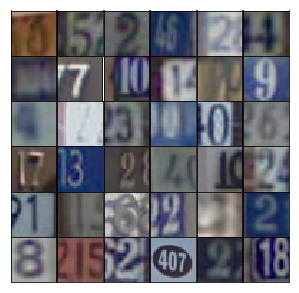

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0
    
    config = tf.ConfigProto()
    config.gpu_options.allow_growth = True
    config.gpu_options.per_process_gpu_memory_fraction = 0.33
    with tf.Session(config=config) as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.4139... Generator Loss: 0.5986
Epoch 1/25... Discriminator Loss: 0.6320... Generator Loss: 1.1950
Epoch 1/25... Discriminator Loss: 0.1666... Generator Loss: 2.5481
Epoch 1/25... Discriminator Loss: 0.1641... Generator Loss: 2.8941
Epoch 1/25... Discriminator Loss: 0.2014... Generator Loss: 2.3351
Epoch 1/25... Discriminator Loss: 0.1119... Generator Loss: 2.8310
Epoch 1/25... Discriminator Loss: 0.1063... Generator Loss: 2.8108
Epoch 1/25... Discriminator Loss: 0.0941... Generator Loss: 3.6333
Epoch 1/25... Discriminator Loss: 0.1010... Generator Loss: 3.1440
Epoch 1/25... Discriminator Loss: 0.2106... Generator Loss: 2.1375


c:\programdata\anaconda3\envs\aind\lib\site-packages\matplotlib\axes\_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


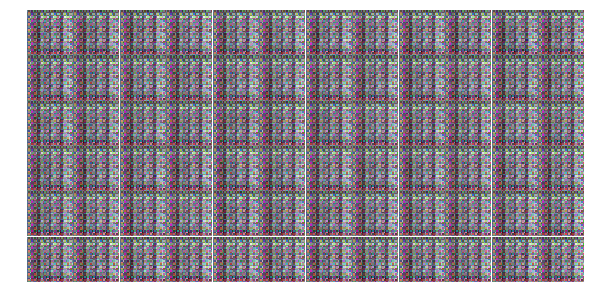

Epoch 1/25... Discriminator Loss: 0.0593... Generator Loss: 3.3492
Epoch 1/25... Discriminator Loss: 0.2472... Generator Loss: 2.7385
Epoch 1/25... Discriminator Loss: 0.6233... Generator Loss: 1.2803
Epoch 1/25... Discriminator Loss: 0.7443... Generator Loss: 1.0154
Epoch 1/25... Discriminator Loss: 0.5262... Generator Loss: 1.5971
Epoch 1/25... Discriminator Loss: 0.4015... Generator Loss: 1.7306
Epoch 1/25... Discriminator Loss: 0.3485... Generator Loss: 2.9940
Epoch 1/25... Discriminator Loss: 0.2569... Generator Loss: 2.5248
Epoch 1/25... Discriminator Loss: 0.6836... Generator Loss: 0.9109
Epoch 1/25... Discriminator Loss: 0.4702... Generator Loss: 1.4831


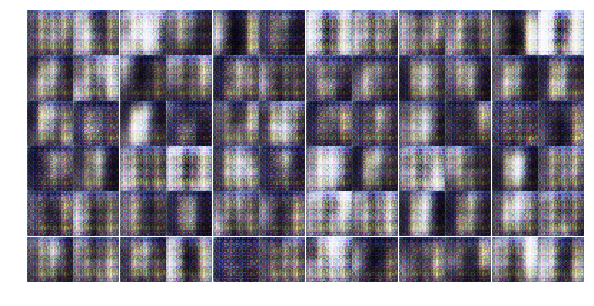

Epoch 1/25... Discriminator Loss: 0.4052... Generator Loss: 1.9308
Epoch 1/25... Discriminator Loss: 0.2019... Generator Loss: 4.4720
Epoch 1/25... Discriminator Loss: 1.8714... Generator Loss: 0.6430
Epoch 1/25... Discriminator Loss: 0.5183... Generator Loss: 1.6824
Epoch 1/25... Discriminator Loss: 0.2620... Generator Loss: 1.8446
Epoch 1/25... Discriminator Loss: 0.0964... Generator Loss: 3.4056
Epoch 1/25... Discriminator Loss: 0.7045... Generator Loss: 1.4191
Epoch 1/25... Discriminator Loss: 0.1252... Generator Loss: 5.4468
Epoch 1/25... Discriminator Loss: 0.6227... Generator Loss: 7.3336
Epoch 1/25... Discriminator Loss: 0.4524... Generator Loss: 2.0171


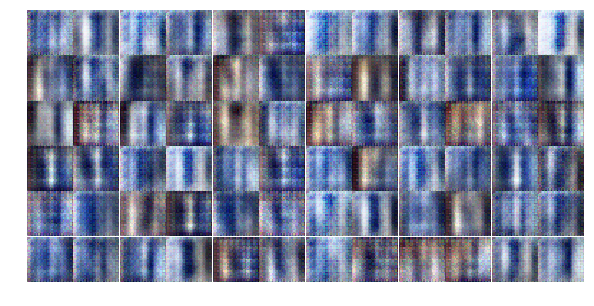

Epoch 1/25... Discriminator Loss: 0.4980... Generator Loss: 1.9024
Epoch 1/25... Discriminator Loss: 0.7573... Generator Loss: 1.1919
Epoch 1/25... Discriminator Loss: 0.5661... Generator Loss: 1.4100
Epoch 1/25... Discriminator Loss: 0.2902... Generator Loss: 2.2386
Epoch 1/25... Discriminator Loss: 0.4844... Generator Loss: 1.7263
Epoch 1/25... Discriminator Loss: 0.9612... Generator Loss: 0.7127
Epoch 1/25... Discriminator Loss: 0.5599... Generator Loss: 1.3340
Epoch 1/25... Discriminator Loss: 0.4030... Generator Loss: 2.8311
Epoch 1/25... Discriminator Loss: 0.5399... Generator Loss: 1.5917
Epoch 1/25... Discriminator Loss: 0.3002... Generator Loss: 2.4183


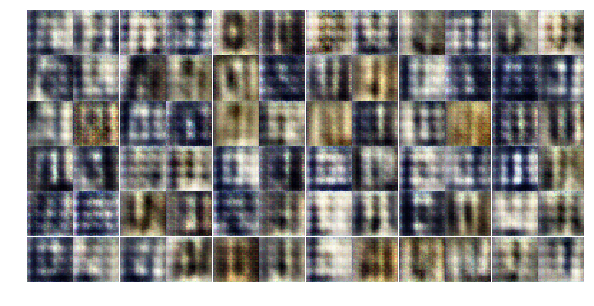

Epoch 1/25... Discriminator Loss: 0.7854... Generator Loss: 0.9371
Epoch 1/25... Discriminator Loss: 0.4387... Generator Loss: 1.8618
Epoch 1/25... Discriminator Loss: 0.2906... Generator Loss: 2.6581
Epoch 1/25... Discriminator Loss: 0.8007... Generator Loss: 0.9819
Epoch 1/25... Discriminator Loss: 1.0304... Generator Loss: 0.9635
Epoch 1/25... Discriminator Loss: 0.5703... Generator Loss: 2.0483
Epoch 1/25... Discriminator Loss: 0.4893... Generator Loss: 1.7936
Epoch 1/25... Discriminator Loss: 0.6523... Generator Loss: 1.4233
Epoch 1/25... Discriminator Loss: 0.5834... Generator Loss: 1.4780
Epoch 1/25... Discriminator Loss: 0.6728... Generator Loss: 1.7699


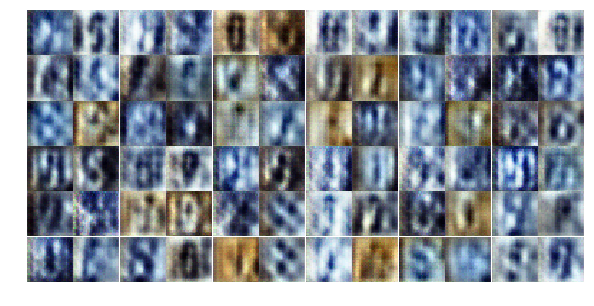

Epoch 1/25... Discriminator Loss: 0.8561... Generator Loss: 2.8320
Epoch 1/25... Discriminator Loss: 0.8706... Generator Loss: 0.9109
Epoch 1/25... Discriminator Loss: 0.6356... Generator Loss: 1.9007
Epoch 1/25... Discriminator Loss: 0.7229... Generator Loss: 1.1659
Epoch 1/25... Discriminator Loss: 0.8594... Generator Loss: 1.2834
Epoch 1/25... Discriminator Loss: 0.8536... Generator Loss: 0.9818
Epoch 1/25... Discriminator Loss: 0.8065... Generator Loss: 1.1996
Epoch 2/25... Discriminator Loss: 0.6346... Generator Loss: 1.6795
Epoch 2/25... Discriminator Loss: 0.6077... Generator Loss: 1.9125
Epoch 2/25... Discriminator Loss: 0.3954... Generator Loss: 1.9137


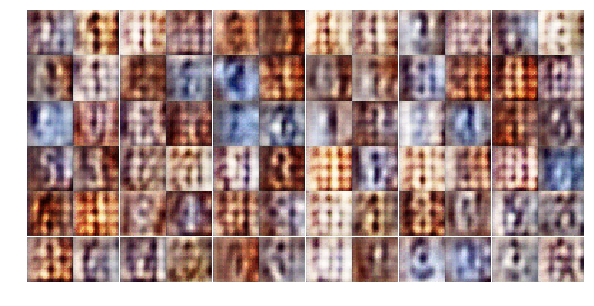

Epoch 2/25... Discriminator Loss: 1.0930... Generator Loss: 0.7022
Epoch 2/25... Discriminator Loss: 2.2309... Generator Loss: 0.2069
Epoch 2/25... Discriminator Loss: 1.3223... Generator Loss: 1.3195
Epoch 2/25... Discriminator Loss: 0.9212... Generator Loss: 1.1514
Epoch 2/25... Discriminator Loss: 1.1310... Generator Loss: 0.7150
Epoch 2/25... Discriminator Loss: 1.4738... Generator Loss: 0.7650
Epoch 2/25... Discriminator Loss: 1.3034... Generator Loss: 0.6850
Epoch 2/25... Discriminator Loss: 0.7522... Generator Loss: 1.3937
Epoch 2/25... Discriminator Loss: 1.0053... Generator Loss: 0.8967
Epoch 2/25... Discriminator Loss: 0.8921... Generator Loss: 1.3692


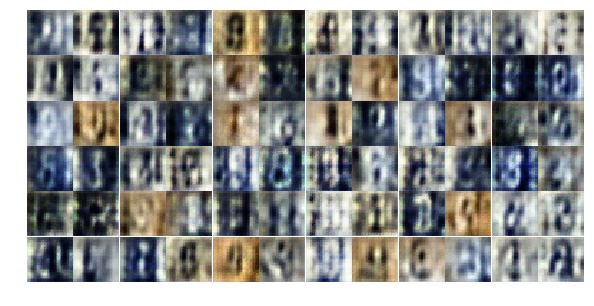

Epoch 2/25... Discriminator Loss: 0.6121... Generator Loss: 1.3434
Epoch 2/25... Discriminator Loss: 0.9541... Generator Loss: 2.1246
Epoch 2/25... Discriminator Loss: 0.6963... Generator Loss: 1.3707
Epoch 2/25... Discriminator Loss: 0.7712... Generator Loss: 1.3191
Epoch 2/25... Discriminator Loss: 0.9110... Generator Loss: 1.3736
Epoch 2/25... Discriminator Loss: 0.9618... Generator Loss: 1.0825
Epoch 2/25... Discriminator Loss: 1.0769... Generator Loss: 0.7778
Epoch 2/25... Discriminator Loss: 0.8833... Generator Loss: 1.7191
Epoch 2/25... Discriminator Loss: 0.8376... Generator Loss: 1.4359
Epoch 2/25... Discriminator Loss: 1.0373... Generator Loss: 0.6555


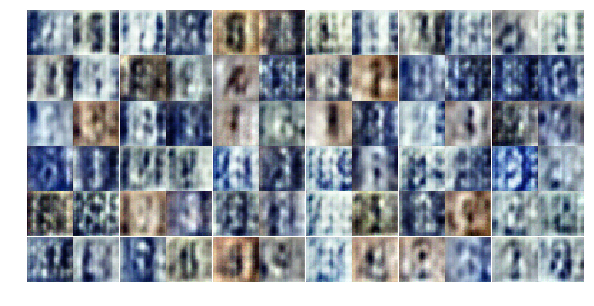

Epoch 2/25... Discriminator Loss: 0.9549... Generator Loss: 0.7629
Epoch 2/25... Discriminator Loss: 1.3514... Generator Loss: 0.8662
Epoch 2/25... Discriminator Loss: 1.0480... Generator Loss: 1.0514
Epoch 2/25... Discriminator Loss: 1.8959... Generator Loss: 2.4698
Epoch 2/25... Discriminator Loss: 0.9125... Generator Loss: 1.2628
Epoch 2/25... Discriminator Loss: 0.8709... Generator Loss: 1.2826
Epoch 2/25... Discriminator Loss: 1.0611... Generator Loss: 1.0537
Epoch 2/25... Discriminator Loss: 0.8001... Generator Loss: 1.0742
Epoch 2/25... Discriminator Loss: 1.3106... Generator Loss: 0.7667
Epoch 2/25... Discriminator Loss: 0.9543... Generator Loss: 0.9584


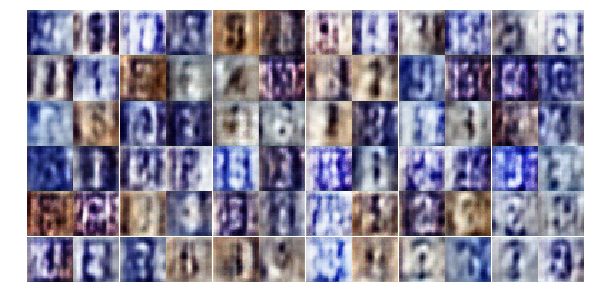

Epoch 2/25... Discriminator Loss: 0.9223... Generator Loss: 1.4997
Epoch 2/25... Discriminator Loss: 1.3427... Generator Loss: 0.5985
Epoch 2/25... Discriminator Loss: 1.2429... Generator Loss: 0.8791
Epoch 2/25... Discriminator Loss: 1.4778... Generator Loss: 0.4479
Epoch 2/25... Discriminator Loss: 0.7624... Generator Loss: 1.0878
Epoch 2/25... Discriminator Loss: 0.8974... Generator Loss: 1.3778
Epoch 2/25... Discriminator Loss: 0.9615... Generator Loss: 1.0603
Epoch 2/25... Discriminator Loss: 1.2654... Generator Loss: 1.1707
Epoch 2/25... Discriminator Loss: 0.8665... Generator Loss: 1.3474
Epoch 2/25... Discriminator Loss: 0.8193... Generator Loss: 1.0900


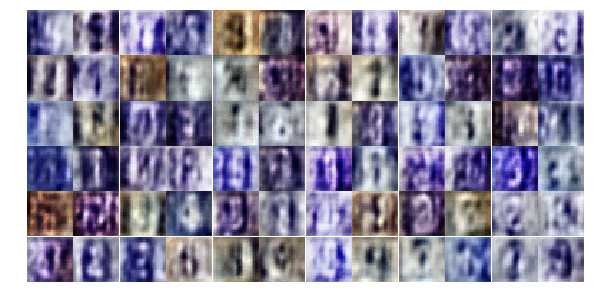

Epoch 2/25... Discriminator Loss: 0.6461... Generator Loss: 1.4758
Epoch 2/25... Discriminator Loss: 1.2431... Generator Loss: 2.0473
Epoch 2/25... Discriminator Loss: 0.9894... Generator Loss: 0.7671
Epoch 2/25... Discriminator Loss: 0.9581... Generator Loss: 1.2803
Epoch 2/25... Discriminator Loss: 0.9374... Generator Loss: 1.1727
Epoch 2/25... Discriminator Loss: 0.8748... Generator Loss: 0.8892
Epoch 2/25... Discriminator Loss: 0.7290... Generator Loss: 1.4725
Epoch 2/25... Discriminator Loss: 1.0140... Generator Loss: 1.7832
Epoch 2/25... Discriminator Loss: 0.4935... Generator Loss: 2.0593
Epoch 2/25... Discriminator Loss: 0.5165... Generator Loss: 1.5854


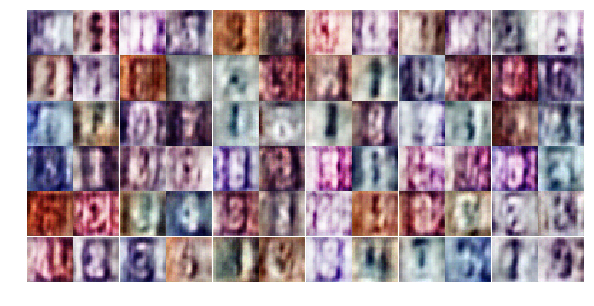

Epoch 2/25... Discriminator Loss: 0.9587... Generator Loss: 1.0513
Epoch 2/25... Discriminator Loss: 0.8209... Generator Loss: 1.1200
Epoch 2/25... Discriminator Loss: 1.6207... Generator Loss: 0.3735
Epoch 2/25... Discriminator Loss: 0.8134... Generator Loss: 1.1080
Epoch 3/25... Discriminator Loss: 0.7624... Generator Loss: 1.2848
Epoch 3/25... Discriminator Loss: 0.7795... Generator Loss: 1.3336
Epoch 3/25... Discriminator Loss: 0.8129... Generator Loss: 1.2861
Epoch 3/25... Discriminator Loss: 0.7847... Generator Loss: 1.0272
Epoch 3/25... Discriminator Loss: 0.9183... Generator Loss: 1.5744
Epoch 3/25... Discriminator Loss: 0.5751... Generator Loss: 1.9666


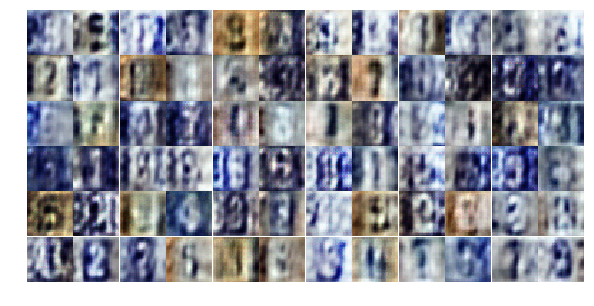

Epoch 3/25... Discriminator Loss: 0.8531... Generator Loss: 0.9613
Epoch 3/25... Discriminator Loss: 0.5741... Generator Loss: 1.5253
Epoch 3/25... Discriminator Loss: 0.6291... Generator Loss: 1.7915
Epoch 3/25... Discriminator Loss: 0.5388... Generator Loss: 1.3948
Epoch 3/25... Discriminator Loss: 0.6370... Generator Loss: 1.3259
Epoch 3/25... Discriminator Loss: 1.2721... Generator Loss: 0.5261
Epoch 3/25... Discriminator Loss: 0.5387... Generator Loss: 1.4263
Epoch 3/25... Discriminator Loss: 0.4175... Generator Loss: 1.7165
Epoch 3/25... Discriminator Loss: 1.6248... Generator Loss: 0.3123
Epoch 3/25... Discriminator Loss: 0.7525... Generator Loss: 0.9920


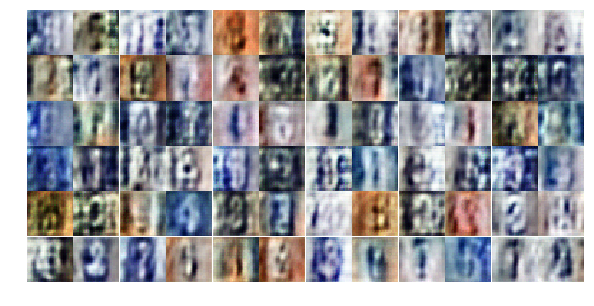

Epoch 3/25... Discriminator Loss: 0.7010... Generator Loss: 1.2659
Epoch 3/25... Discriminator Loss: 0.3909... Generator Loss: 1.7088
Epoch 3/25... Discriminator Loss: 1.3665... Generator Loss: 0.6207
Epoch 3/25... Discriminator Loss: 1.5228... Generator Loss: 0.3725
Epoch 3/25... Discriminator Loss: 0.4761... Generator Loss: 1.8855
Epoch 3/25... Discriminator Loss: 0.5596... Generator Loss: 1.6746
Epoch 3/25... Discriminator Loss: 0.5789... Generator Loss: 1.2248
Epoch 3/25... Discriminator Loss: 0.3690... Generator Loss: 1.7775
Epoch 3/25... Discriminator Loss: 0.5300... Generator Loss: 1.2398
Epoch 3/25... Discriminator Loss: 1.4851... Generator Loss: 0.3509


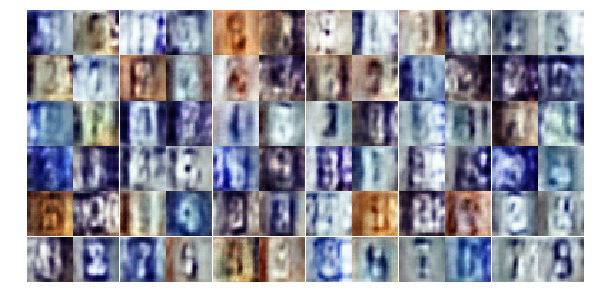

Epoch 3/25... Discriminator Loss: 1.4677... Generator Loss: 1.0312
Epoch 3/25... Discriminator Loss: 0.7433... Generator Loss: 1.4737
Epoch 3/25... Discriminator Loss: 0.9350... Generator Loss: 1.7984
Epoch 3/25... Discriminator Loss: 0.6253... Generator Loss: 1.1564
Epoch 3/25... Discriminator Loss: 0.5506... Generator Loss: 1.4494
Epoch 3/25... Discriminator Loss: 0.6705... Generator Loss: 1.1831
Epoch 3/25... Discriminator Loss: 0.7878... Generator Loss: 0.9976
Epoch 3/25... Discriminator Loss: 0.5386... Generator Loss: 1.3742
Epoch 3/25... Discriminator Loss: 0.3348... Generator Loss: 2.0206
Epoch 3/25... Discriminator Loss: 0.5867... Generator Loss: 1.3290


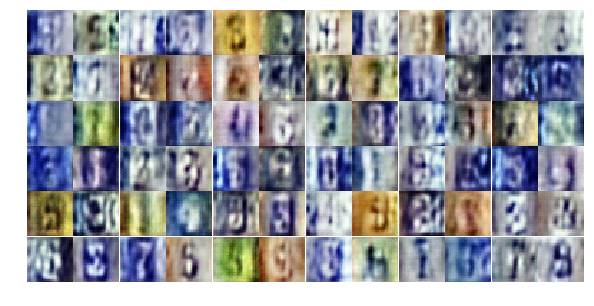

Epoch 3/25... Discriminator Loss: 0.7392... Generator Loss: 3.1934
Epoch 3/25... Discriminator Loss: 0.3135... Generator Loss: 2.2595
Epoch 3/25... Discriminator Loss: 0.3955... Generator Loss: 1.8759
Epoch 3/25... Discriminator Loss: 0.4550... Generator Loss: 1.6881
Epoch 3/25... Discriminator Loss: 0.5505... Generator Loss: 2.0176
Epoch 3/25... Discriminator Loss: 0.8392... Generator Loss: 2.7291
Epoch 3/25... Discriminator Loss: 0.7727... Generator Loss: 1.2799
Epoch 3/25... Discriminator Loss: 0.6192... Generator Loss: 3.1317
Epoch 3/25... Discriminator Loss: 0.6279... Generator Loss: 2.0317
Epoch 3/25... Discriminator Loss: 0.5573... Generator Loss: 1.5095


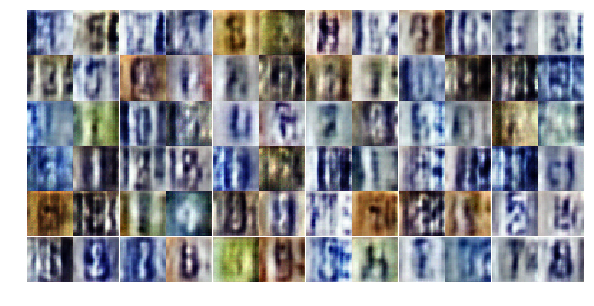

Epoch 3/25... Discriminator Loss: 0.9406... Generator Loss: 1.3634
Epoch 3/25... Discriminator Loss: 0.9027... Generator Loss: 0.9241
Epoch 3/25... Discriminator Loss: 0.2046... Generator Loss: 2.5556
Epoch 3/25... Discriminator Loss: 0.7048... Generator Loss: 1.8528
Epoch 3/25... Discriminator Loss: 0.5411... Generator Loss: 1.6598
Epoch 3/25... Discriminator Loss: 0.2847... Generator Loss: 2.9767
Epoch 3/25... Discriminator Loss: 0.4060... Generator Loss: 3.2764
Epoch 3/25... Discriminator Loss: 0.2680... Generator Loss: 2.3863
Epoch 3/25... Discriminator Loss: 0.4105... Generator Loss: 1.7425
Epoch 3/25... Discriminator Loss: 0.5239... Generator Loss: 2.1181


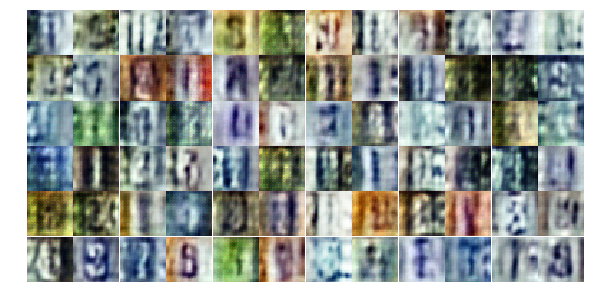

Epoch 3/25... Discriminator Loss: 1.2672... Generator Loss: 0.5155
Epoch 4/25... Discriminator Loss: 1.0103... Generator Loss: 0.7425
Epoch 4/25... Discriminator Loss: 0.9015... Generator Loss: 1.3160
Epoch 4/25... Discriminator Loss: 0.8845... Generator Loss: 0.8602
Epoch 4/25... Discriminator Loss: 0.6062... Generator Loss: 1.2685
Epoch 4/25... Discriminator Loss: 0.4091... Generator Loss: 2.4089
Epoch 4/25... Discriminator Loss: 0.9907... Generator Loss: 2.3497
Epoch 4/25... Discriminator Loss: 0.6369... Generator Loss: 1.1935
Epoch 4/25... Discriminator Loss: 0.8150... Generator Loss: 0.7731
Epoch 4/25... Discriminator Loss: 1.0278... Generator Loss: 0.7098


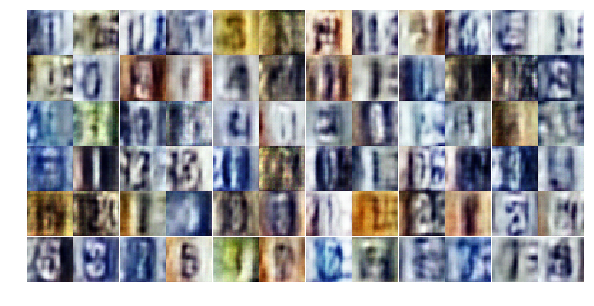

Epoch 4/25... Discriminator Loss: 1.5817... Generator Loss: 3.6159
Epoch 4/25... Discriminator Loss: 0.6805... Generator Loss: 1.8646
Epoch 4/25... Discriminator Loss: 1.0032... Generator Loss: 0.6488
Epoch 4/25... Discriminator Loss: 1.0642... Generator Loss: 0.7221
Epoch 4/25... Discriminator Loss: 0.8999... Generator Loss: 1.1377
Epoch 4/25... Discriminator Loss: 1.2676... Generator Loss: 0.4973
Epoch 4/25... Discriminator Loss: 0.6198... Generator Loss: 2.1731
Epoch 4/25... Discriminator Loss: 0.7698... Generator Loss: 0.9745
Epoch 4/25... Discriminator Loss: 0.8228... Generator Loss: 1.2162
Epoch 4/25... Discriminator Loss: 0.6318... Generator Loss: 1.2280


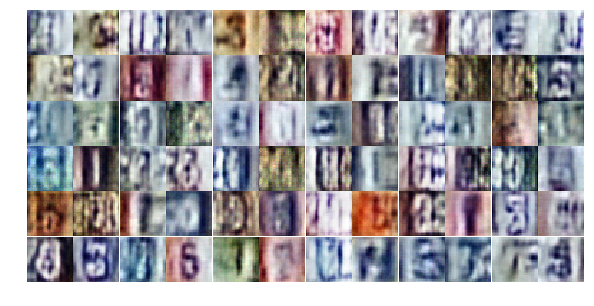

Epoch 4/25... Discriminator Loss: 0.9209... Generator Loss: 1.1230
Epoch 4/25... Discriminator Loss: 0.7671... Generator Loss: 2.8736
Epoch 4/25... Discriminator Loss: 0.5524... Generator Loss: 1.3627
Epoch 4/25... Discriminator Loss: 1.5986... Generator Loss: 0.3320
Epoch 4/25... Discriminator Loss: 0.9050... Generator Loss: 0.8826
Epoch 4/25... Discriminator Loss: 0.4597... Generator Loss: 1.9888
Epoch 4/25... Discriminator Loss: 0.5234... Generator Loss: 2.0074
Epoch 4/25... Discriminator Loss: 1.6759... Generator Loss: 0.3009
Epoch 4/25... Discriminator Loss: 0.4350... Generator Loss: 1.8880
Epoch 4/25... Discriminator Loss: 0.5415... Generator Loss: 1.3853


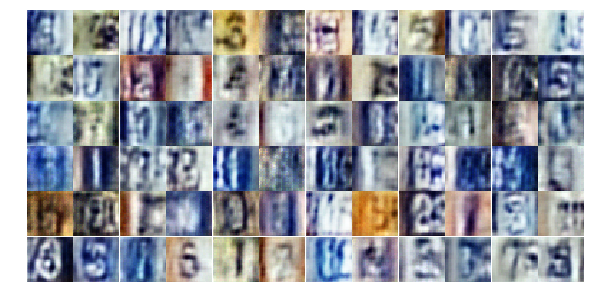

Epoch 4/25... Discriminator Loss: 0.3825... Generator Loss: 2.2905
Epoch 4/25... Discriminator Loss: 0.3103... Generator Loss: 2.5529
Epoch 4/25... Discriminator Loss: 0.8418... Generator Loss: 0.7192
Epoch 4/25... Discriminator Loss: 0.5129... Generator Loss: 2.6150
Epoch 4/25... Discriminator Loss: 0.5599... Generator Loss: 3.6214
Epoch 4/25... Discriminator Loss: 0.6342... Generator Loss: 1.1949
Epoch 4/25... Discriminator Loss: 0.5515... Generator Loss: 2.0150
Epoch 4/25... Discriminator Loss: 0.3339... Generator Loss: 2.7630
Epoch 4/25... Discriminator Loss: 0.3989... Generator Loss: 3.0859
Epoch 4/25... Discriminator Loss: 0.8424... Generator Loss: 2.2438


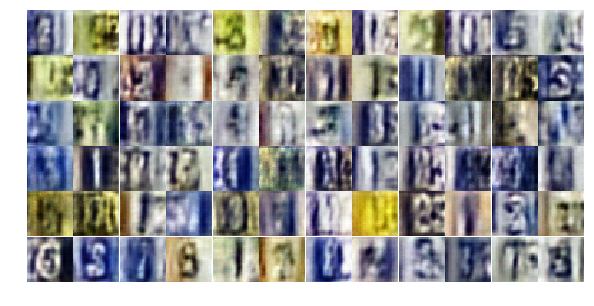

Epoch 4/25... Discriminator Loss: 0.8548... Generator Loss: 0.8283
Epoch 4/25... Discriminator Loss: 0.6430... Generator Loss: 1.0031
Epoch 4/25... Discriminator Loss: 0.4843... Generator Loss: 1.4837
Epoch 4/25... Discriminator Loss: 0.3450... Generator Loss: 1.7183
Epoch 4/25... Discriminator Loss: 0.2974... Generator Loss: 3.0734
Epoch 4/25... Discriminator Loss: 0.6960... Generator Loss: 2.1974
Epoch 4/25... Discriminator Loss: 0.9988... Generator Loss: 0.6253
Epoch 4/25... Discriminator Loss: 0.5956... Generator Loss: 1.1594
Epoch 4/25... Discriminator Loss: 0.5454... Generator Loss: 1.4518
Epoch 4/25... Discriminator Loss: 0.4128... Generator Loss: 2.1092


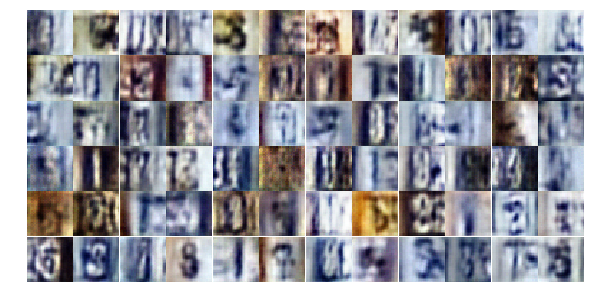

Epoch 4/25... Discriminator Loss: 0.6350... Generator Loss: 1.5566
Epoch 4/25... Discriminator Loss: 0.4636... Generator Loss: 1.5719
Epoch 4/25... Discriminator Loss: 0.3344... Generator Loss: 3.0587
Epoch 4/25... Discriminator Loss: 0.4038... Generator Loss: 2.7924
Epoch 4/25... Discriminator Loss: 0.6585... Generator Loss: 0.9412
Epoch 4/25... Discriminator Loss: 0.6250... Generator Loss: 1.1821
Epoch 4/25... Discriminator Loss: 0.4540... Generator Loss: 1.4985
Epoch 4/25... Discriminator Loss: 1.6374... Generator Loss: 0.2969
Epoch 4/25... Discriminator Loss: 0.7609... Generator Loss: 1.7678
Epoch 5/25... Discriminator Loss: 1.2099... Generator Loss: 0.4640


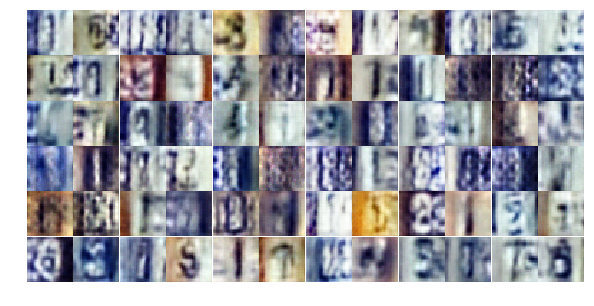

Epoch 5/25... Discriminator Loss: 0.4479... Generator Loss: 1.9680
Epoch 5/25... Discriminator Loss: 0.4061... Generator Loss: 2.1190
Epoch 5/25... Discriminator Loss: 0.6610... Generator Loss: 1.1945
Epoch 5/25... Discriminator Loss: 0.2588... Generator Loss: 2.0764
Epoch 5/25... Discriminator Loss: 0.3310... Generator Loss: 2.1115
Epoch 5/25... Discriminator Loss: 0.8015... Generator Loss: 0.7929
Epoch 5/25... Discriminator Loss: 0.3350... Generator Loss: 2.0159
Epoch 5/25... Discriminator Loss: 0.5939... Generator Loss: 1.1703
Epoch 5/25... Discriminator Loss: 0.5044... Generator Loss: 1.6575
Epoch 5/25... Discriminator Loss: 1.2421... Generator Loss: 0.4395


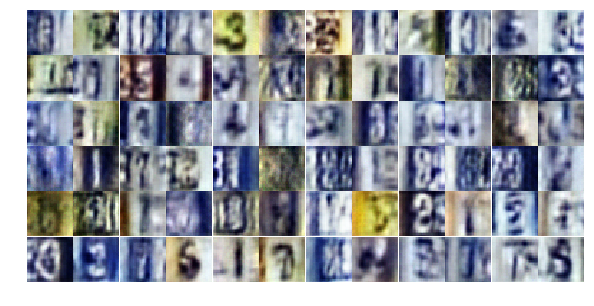

Epoch 5/25... Discriminator Loss: 0.6172... Generator Loss: 2.1794
Epoch 5/25... Discriminator Loss: 0.5904... Generator Loss: 1.5860
Epoch 5/25... Discriminator Loss: 0.4117... Generator Loss: 2.1113
Epoch 5/25... Discriminator Loss: 0.9708... Generator Loss: 0.6975
Epoch 5/25... Discriminator Loss: 0.5760... Generator Loss: 1.5108
Epoch 5/25... Discriminator Loss: 0.8146... Generator Loss: 0.8117
Epoch 5/25... Discriminator Loss: 0.6910... Generator Loss: 1.0634
Epoch 5/25... Discriminator Loss: 0.6984... Generator Loss: 1.0815
Epoch 5/25... Discriminator Loss: 0.3253... Generator Loss: 2.2466
Epoch 5/25... Discriminator Loss: 0.4162... Generator Loss: 1.5686


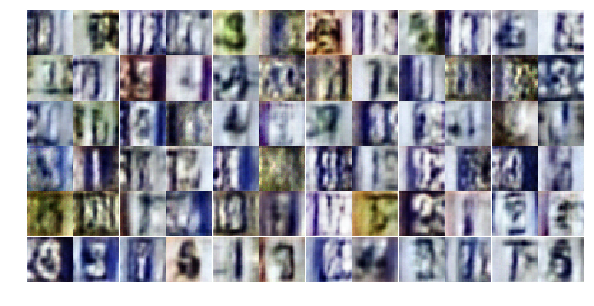

Epoch 5/25... Discriminator Loss: 0.4819... Generator Loss: 1.3746
Epoch 5/25... Discriminator Loss: 1.0727... Generator Loss: 1.4506
Epoch 5/25... Discriminator Loss: 0.7852... Generator Loss: 0.8338
Epoch 5/25... Discriminator Loss: 0.5632... Generator Loss: 1.3088
Epoch 5/25... Discriminator Loss: 1.0764... Generator Loss: 0.5670
Epoch 5/25... Discriminator Loss: 0.9171... Generator Loss: 0.8007
Epoch 5/25... Discriminator Loss: 0.8050... Generator Loss: 0.8580
Epoch 5/25... Discriminator Loss: 0.5079... Generator Loss: 1.6291
Epoch 5/25... Discriminator Loss: 1.1371... Generator Loss: 0.5743
Epoch 5/25... Discriminator Loss: 0.4387... Generator Loss: 1.5313


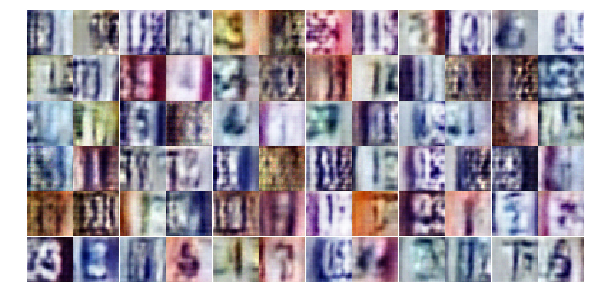

Epoch 5/25... Discriminator Loss: 0.3906... Generator Loss: 1.7768
Epoch 5/25... Discriminator Loss: 0.4499... Generator Loss: 1.4707
Epoch 5/25... Discriminator Loss: 0.5397... Generator Loss: 2.0119
Epoch 5/25... Discriminator Loss: 0.7158... Generator Loss: 0.9049
Epoch 5/25... Discriminator Loss: 0.5815... Generator Loss: 2.0450
Epoch 5/25... Discriminator Loss: 0.4033... Generator Loss: 1.6942
Epoch 5/25... Discriminator Loss: 0.6934... Generator Loss: 0.9024
Epoch 5/25... Discriminator Loss: 0.6487... Generator Loss: 1.3491
Epoch 5/25... Discriminator Loss: 0.5372... Generator Loss: 1.2560
Epoch 5/25... Discriminator Loss: 0.3912... Generator Loss: 1.9389


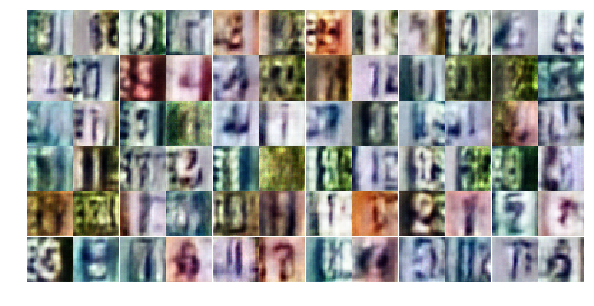

Epoch 5/25... Discriminator Loss: 0.3443... Generator Loss: 1.9785
Epoch 5/25... Discriminator Loss: 0.3537... Generator Loss: 1.5615
Epoch 5/25... Discriminator Loss: 1.2648... Generator Loss: 0.5492
Epoch 5/25... Discriminator Loss: 0.7885... Generator Loss: 1.0262
Epoch 5/25... Discriminator Loss: 0.7062... Generator Loss: 1.6341
Epoch 5/25... Discriminator Loss: 0.6446... Generator Loss: 1.4636
Epoch 5/25... Discriminator Loss: 0.6887... Generator Loss: 1.1388
Epoch 5/25... Discriminator Loss: 0.7001... Generator Loss: 0.8856
Epoch 5/25... Discriminator Loss: 0.4746... Generator Loss: 2.2329
Epoch 5/25... Discriminator Loss: 0.4636... Generator Loss: 1.4540


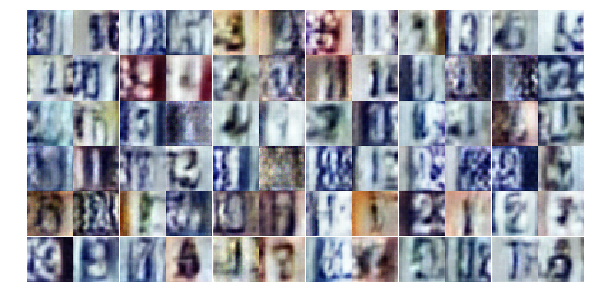

Epoch 5/25... Discriminator Loss: 1.3382... Generator Loss: 2.5749
Epoch 5/25... Discriminator Loss: 0.5685... Generator Loss: 1.1882
Epoch 5/25... Discriminator Loss: 1.0116... Generator Loss: 2.5893
Epoch 5/25... Discriminator Loss: 0.7268... Generator Loss: 0.9624
Epoch 5/25... Discriminator Loss: 0.4715... Generator Loss: 1.4256
Epoch 5/25... Discriminator Loss: 0.5033... Generator Loss: 2.0023
Epoch 6/25... Discriminator Loss: 0.6931... Generator Loss: 0.9945
Epoch 6/25... Discriminator Loss: 0.4643... Generator Loss: 2.3060
Epoch 6/25... Discriminator Loss: 1.2638... Generator Loss: 2.9790
Epoch 6/25... Discriminator Loss: 0.7900... Generator Loss: 0.9225


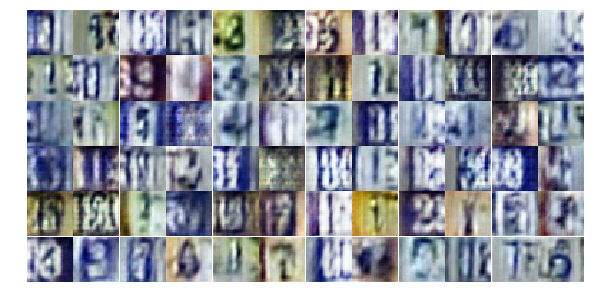

Epoch 6/25... Discriminator Loss: 0.4813... Generator Loss: 1.6371
Epoch 6/25... Discriminator Loss: 0.7121... Generator Loss: 0.9481
Epoch 6/25... Discriminator Loss: 0.7425... Generator Loss: 1.2522
Epoch 6/25... Discriminator Loss: 0.7517... Generator Loss: 0.8473
Epoch 6/25... Discriminator Loss: 1.0977... Generator Loss: 0.5593
Epoch 6/25... Discriminator Loss: 0.7052... Generator Loss: 0.9734
Epoch 6/25... Discriminator Loss: 0.6105... Generator Loss: 1.7523
Epoch 6/25... Discriminator Loss: 0.6560... Generator Loss: 1.2095
Epoch 6/25... Discriminator Loss: 0.7648... Generator Loss: 0.8407
Epoch 6/25... Discriminator Loss: 0.7028... Generator Loss: 0.9647


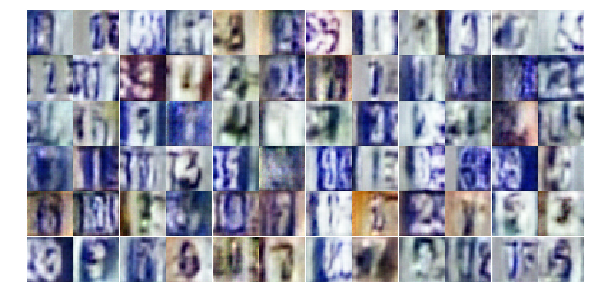

Epoch 6/25... Discriminator Loss: 1.9710... Generator Loss: 2.2251
Epoch 6/25... Discriminator Loss: 0.5544... Generator Loss: 1.7699
Epoch 6/25... Discriminator Loss: 1.3946... Generator Loss: 0.4606
Epoch 6/25... Discriminator Loss: 0.4479... Generator Loss: 1.4904
Epoch 6/25... Discriminator Loss: 0.6391... Generator Loss: 1.9612
Epoch 6/25... Discriminator Loss: 0.6706... Generator Loss: 1.1275
Epoch 6/25... Discriminator Loss: 0.4949... Generator Loss: 1.6364
Epoch 6/25... Discriminator Loss: 0.9593... Generator Loss: 0.6563
Epoch 6/25... Discriminator Loss: 0.5802... Generator Loss: 2.1465
Epoch 6/25... Discriminator Loss: 0.6756... Generator Loss: 1.1445


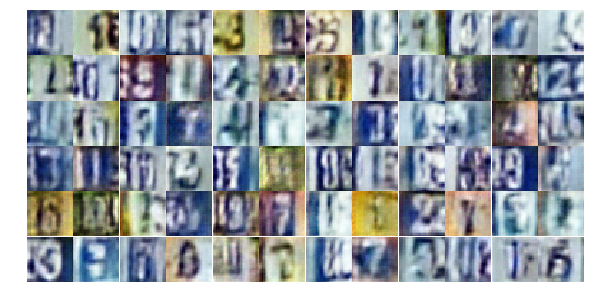

Epoch 6/25... Discriminator Loss: 0.8953... Generator Loss: 0.7147
Epoch 6/25... Discriminator Loss: 0.6538... Generator Loss: 1.2656
Epoch 6/25... Discriminator Loss: 0.9532... Generator Loss: 0.7235
Epoch 6/25... Discriminator Loss: 0.7169... Generator Loss: 1.0084
Epoch 6/25... Discriminator Loss: 0.5665... Generator Loss: 2.8631
Epoch 6/25... Discriminator Loss: 1.6036... Generator Loss: 0.3624
Epoch 6/25... Discriminator Loss: 0.8268... Generator Loss: 0.8478
Epoch 6/25... Discriminator Loss: 0.4222... Generator Loss: 1.3403
Epoch 6/25... Discriminator Loss: 0.4738... Generator Loss: 1.4165
Epoch 6/25... Discriminator Loss: 0.5804... Generator Loss: 1.2699


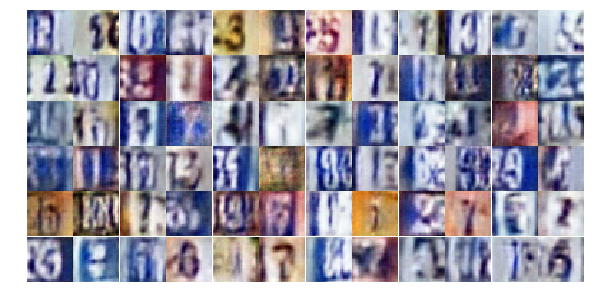

Epoch 6/25... Discriminator Loss: 1.1945... Generator Loss: 0.4804
Epoch 6/25... Discriminator Loss: 0.7501... Generator Loss: 2.1400
Epoch 6/25... Discriminator Loss: 1.1875... Generator Loss: 0.5298
Epoch 6/25... Discriminator Loss: 0.5470... Generator Loss: 1.2918
Epoch 6/25... Discriminator Loss: 0.7808... Generator Loss: 0.9735
Epoch 6/25... Discriminator Loss: 0.6471... Generator Loss: 1.0432
Epoch 6/25... Discriminator Loss: 0.5295... Generator Loss: 1.8905
Epoch 6/25... Discriminator Loss: 0.3404... Generator Loss: 1.9998
Epoch 6/25... Discriminator Loss: 0.8578... Generator Loss: 0.8179
Epoch 6/25... Discriminator Loss: 0.3286... Generator Loss: 1.6750


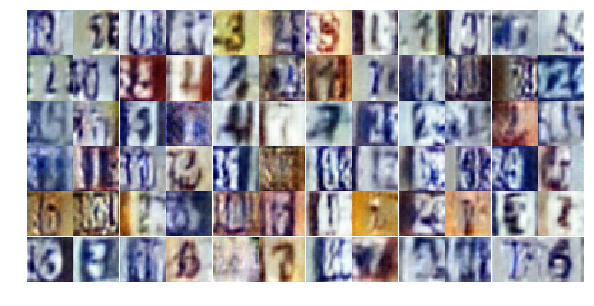

Epoch 6/25... Discriminator Loss: 0.6078... Generator Loss: 1.6217
Epoch 6/25... Discriminator Loss: 1.5401... Generator Loss: 0.3170
Epoch 6/25... Discriminator Loss: 1.1758... Generator Loss: 1.0189
Epoch 6/25... Discriminator Loss: 0.9819... Generator Loss: 1.1325
Epoch 6/25... Discriminator Loss: 0.5615... Generator Loss: 1.8741
Epoch 6/25... Discriminator Loss: 0.6490... Generator Loss: 1.1770
Epoch 6/25... Discriminator Loss: 0.7354... Generator Loss: 0.9264
Epoch 6/25... Discriminator Loss: 1.2877... Generator Loss: 0.4899
Epoch 6/25... Discriminator Loss: 0.4943... Generator Loss: 1.3359
Epoch 6/25... Discriminator Loss: 1.4554... Generator Loss: 0.3887


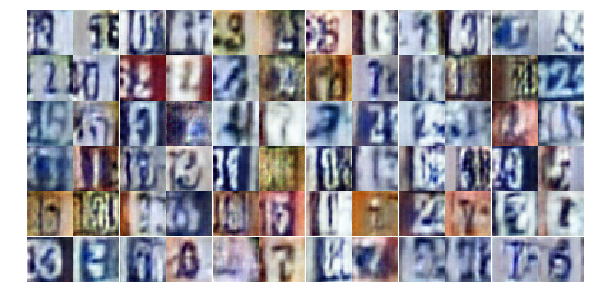

Epoch 6/25... Discriminator Loss: 0.6160... Generator Loss: 1.5824
Epoch 6/25... Discriminator Loss: 0.6236... Generator Loss: 1.0431
Epoch 6/25... Discriminator Loss: 0.8600... Generator Loss: 0.7985
Epoch 7/25... Discriminator Loss: 0.5799... Generator Loss: 1.4208
Epoch 7/25... Discriminator Loss: 0.5723... Generator Loss: 1.3288
Epoch 7/25... Discriminator Loss: 0.6928... Generator Loss: 1.8954
Epoch 7/25... Discriminator Loss: 1.4057... Generator Loss: 0.4066
Epoch 7/25... Discriminator Loss: 0.6499... Generator Loss: 1.4468
Epoch 7/25... Discriminator Loss: 0.5013... Generator Loss: 1.7565
Epoch 7/25... Discriminator Loss: 0.7508... Generator Loss: 0.8561


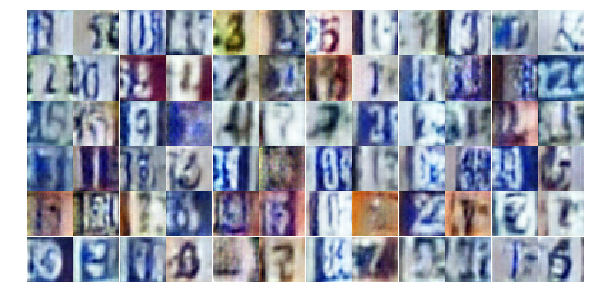

Epoch 7/25... Discriminator Loss: 0.4552... Generator Loss: 1.6379
Epoch 7/25... Discriminator Loss: 0.7512... Generator Loss: 0.9894
Epoch 7/25... Discriminator Loss: 0.7790... Generator Loss: 0.8864
Epoch 7/25... Discriminator Loss: 0.7316... Generator Loss: 2.3383
Epoch 7/25... Discriminator Loss: 0.6617... Generator Loss: 1.5506
Epoch 7/25... Discriminator Loss: 0.6751... Generator Loss: 0.9793
Epoch 7/25... Discriminator Loss: 0.6405... Generator Loss: 2.3675
Epoch 7/25... Discriminator Loss: 0.8580... Generator Loss: 1.8680
Epoch 7/25... Discriminator Loss: 0.9246... Generator Loss: 1.1447
Epoch 7/25... Discriminator Loss: 0.6410... Generator Loss: 1.2816


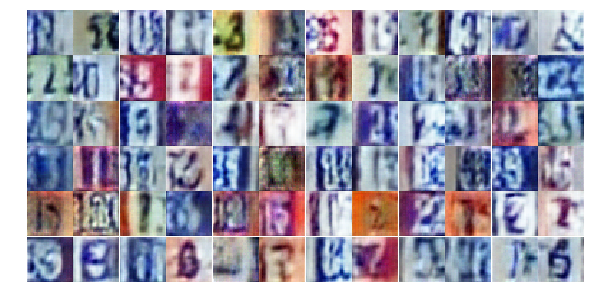

Epoch 7/25... Discriminator Loss: 0.6727... Generator Loss: 1.3110
Epoch 7/25... Discriminator Loss: 0.5350... Generator Loss: 1.2907
Epoch 7/25... Discriminator Loss: 0.6712... Generator Loss: 1.0079
Epoch 7/25... Discriminator Loss: 0.5748... Generator Loss: 1.3609
Epoch 7/25... Discriminator Loss: 0.3448... Generator Loss: 2.0773
Epoch 7/25... Discriminator Loss: 0.4319... Generator Loss: 1.4289
Epoch 7/25... Discriminator Loss: 0.7180... Generator Loss: 0.9416
Epoch 7/25... Discriminator Loss: 0.8942... Generator Loss: 1.0736
Epoch 7/25... Discriminator Loss: 0.3186... Generator Loss: 1.8424
Epoch 7/25... Discriminator Loss: 0.4757... Generator Loss: 2.4476


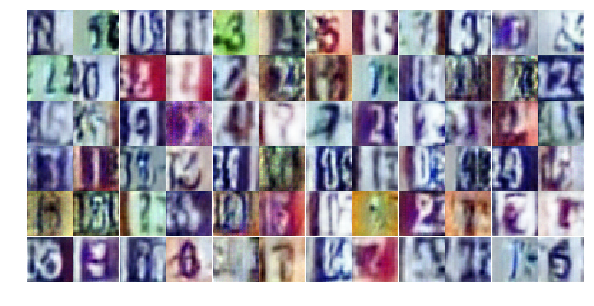

Epoch 7/25... Discriminator Loss: 0.9152... Generator Loss: 0.7799
Epoch 7/25... Discriminator Loss: 0.5133... Generator Loss: 1.4451
Epoch 7/25... Discriminator Loss: 0.4633... Generator Loss: 1.4400
Epoch 7/25... Discriminator Loss: 0.5041... Generator Loss: 1.7491
Epoch 7/25... Discriminator Loss: 0.7234... Generator Loss: 1.1763
Epoch 7/25... Discriminator Loss: 0.7109... Generator Loss: 1.0937
Epoch 7/25... Discriminator Loss: 0.4235... Generator Loss: 1.8101
Epoch 7/25... Discriminator Loss: 0.5298... Generator Loss: 1.2771
Epoch 7/25... Discriminator Loss: 0.7250... Generator Loss: 0.9830
Epoch 7/25... Discriminator Loss: 0.4408... Generator Loss: 2.1981


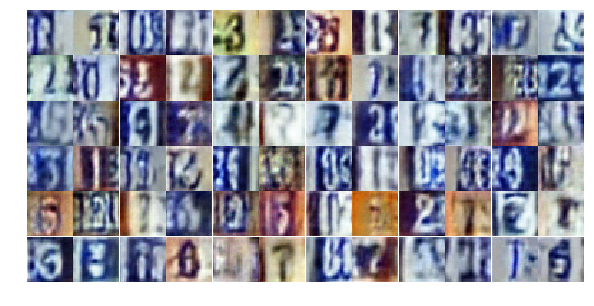

Epoch 7/25... Discriminator Loss: 0.8235... Generator Loss: 2.2031
Epoch 7/25... Discriminator Loss: 0.5108... Generator Loss: 2.2945
Epoch 7/25... Discriminator Loss: 0.3974... Generator Loss: 1.8502
Epoch 7/25... Discriminator Loss: 0.6310... Generator Loss: 1.3801
Epoch 7/25... Discriminator Loss: 0.6291... Generator Loss: 1.5504
Epoch 7/25... Discriminator Loss: 0.5050... Generator Loss: 1.3268
Epoch 7/25... Discriminator Loss: 0.5470... Generator Loss: 1.1796
Epoch 7/25... Discriminator Loss: 1.0411... Generator Loss: 0.8524
Epoch 7/25... Discriminator Loss: 0.3165... Generator Loss: 3.3731
Epoch 7/25... Discriminator Loss: 0.6450... Generator Loss: 1.2862


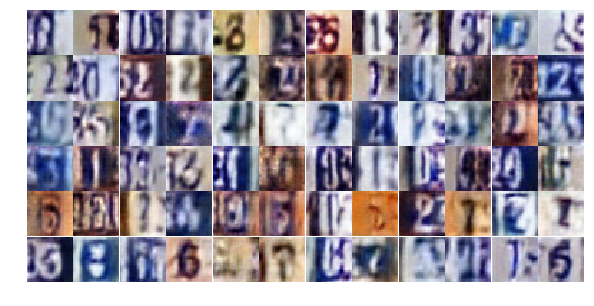

Epoch 7/25... Discriminator Loss: 0.4075... Generator Loss: 1.5483
Epoch 7/25... Discriminator Loss: 0.5555... Generator Loss: 1.1230
Epoch 7/25... Discriminator Loss: 0.6800... Generator Loss: 1.0455
Epoch 7/25... Discriminator Loss: 0.4748... Generator Loss: 2.1203
Epoch 7/25... Discriminator Loss: 0.6938... Generator Loss: 0.9802
Epoch 7/25... Discriminator Loss: 0.7041... Generator Loss: 0.9424
Epoch 7/25... Discriminator Loss: 0.8699... Generator Loss: 0.9236
Epoch 7/25... Discriminator Loss: 0.7061... Generator Loss: 1.8553
Epoch 7/25... Discriminator Loss: 0.6238... Generator Loss: 2.2927
Epoch 7/25... Discriminator Loss: 0.5695... Generator Loss: 1.2796


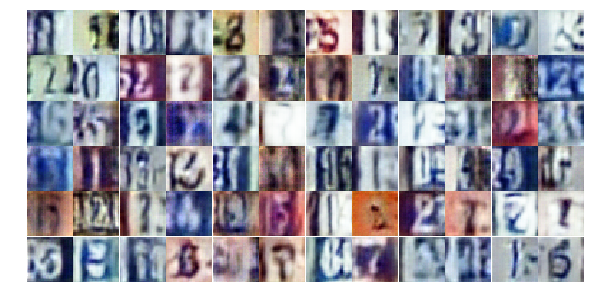

Epoch 7/25... Discriminator Loss: 0.4111... Generator Loss: 1.9718
Epoch 8/25... Discriminator Loss: 0.4365... Generator Loss: 1.7195
Epoch 8/25... Discriminator Loss: 0.7020... Generator Loss: 0.9366
Epoch 8/25... Discriminator Loss: 0.4591... Generator Loss: 1.8109
Epoch 8/25... Discriminator Loss: 0.5406... Generator Loss: 1.4296
Epoch 8/25... Discriminator Loss: 0.8588... Generator Loss: 0.9822
Epoch 8/25... Discriminator Loss: 0.5656... Generator Loss: 1.3563
Epoch 8/25... Discriminator Loss: 0.6787... Generator Loss: 2.2208
Epoch 8/25... Discriminator Loss: 0.7735... Generator Loss: 0.9556
Epoch 8/25... Discriminator Loss: 0.6811... Generator Loss: 0.9638


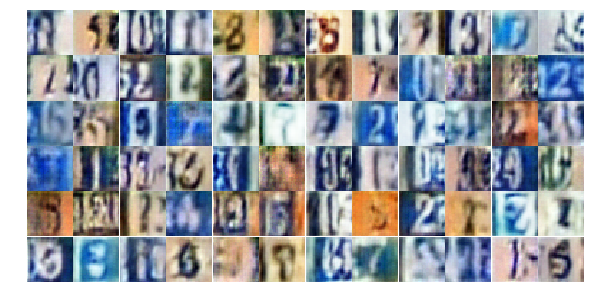

Epoch 8/25... Discriminator Loss: 0.4186... Generator Loss: 1.6204
Epoch 8/25... Discriminator Loss: 0.4857... Generator Loss: 2.7832
Epoch 8/25... Discriminator Loss: 0.8490... Generator Loss: 0.8682
Epoch 8/25... Discriminator Loss: 0.3686... Generator Loss: 2.0260
Epoch 8/25... Discriminator Loss: 0.7859... Generator Loss: 0.9265
Epoch 8/25... Discriminator Loss: 0.9514... Generator Loss: 0.9404
Epoch 8/25... Discriminator Loss: 0.4008... Generator Loss: 2.1905
Epoch 8/25... Discriminator Loss: 0.4438... Generator Loss: 1.5520
Epoch 8/25... Discriminator Loss: 0.5629... Generator Loss: 1.2031
Epoch 8/25... Discriminator Loss: 1.3807... Generator Loss: 0.3826


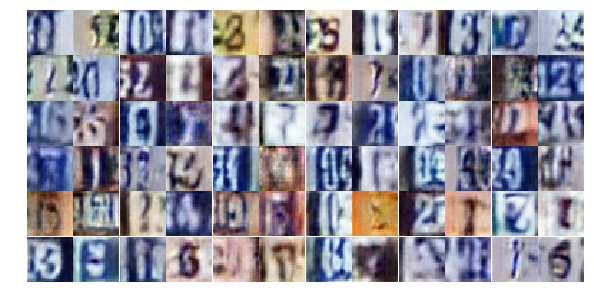

Epoch 8/25... Discriminator Loss: 0.4002... Generator Loss: 2.1088
Epoch 8/25... Discriminator Loss: 0.6998... Generator Loss: 1.0869
Epoch 8/25... Discriminator Loss: 0.8360... Generator Loss: 0.8202
Epoch 8/25... Discriminator Loss: 0.5779... Generator Loss: 1.3569
Epoch 8/25... Discriminator Loss: 0.5442... Generator Loss: 1.2872
Epoch 8/25... Discriminator Loss: 0.5161... Generator Loss: 1.3423
Epoch 8/25... Discriminator Loss: 0.6017... Generator Loss: 1.3432
Epoch 8/25... Discriminator Loss: 0.3966... Generator Loss: 1.4515
Epoch 8/25... Discriminator Loss: 0.5341... Generator Loss: 1.5298
Epoch 8/25... Discriminator Loss: 3.8865... Generator Loss: 6.0680


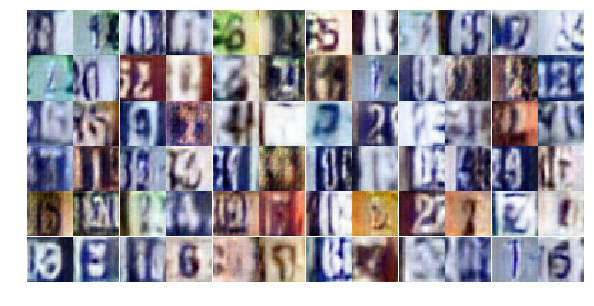

Epoch 8/25... Discriminator Loss: 0.8617... Generator Loss: 1.2314
Epoch 8/25... Discriminator Loss: 1.0439... Generator Loss: 0.6610
Epoch 8/25... Discriminator Loss: 0.5721... Generator Loss: 1.5923
Epoch 8/25... Discriminator Loss: 0.5418... Generator Loss: 1.4377
Epoch 8/25... Discriminator Loss: 0.8953... Generator Loss: 0.7162
Epoch 8/25... Discriminator Loss: 0.4651... Generator Loss: 1.3254
Epoch 8/25... Discriminator Loss: 0.7075... Generator Loss: 1.0690
Epoch 8/25... Discriminator Loss: 0.4420... Generator Loss: 1.7368
Epoch 8/25... Discriminator Loss: 0.5322... Generator Loss: 1.2193
Epoch 8/25... Discriminator Loss: 0.8592... Generator Loss: 2.4213


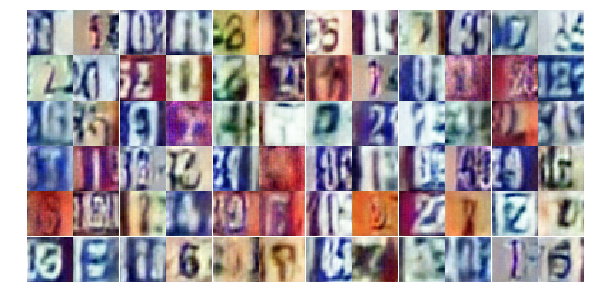

Epoch 8/25... Discriminator Loss: 0.2512... Generator Loss: 2.4332
Epoch 8/25... Discriminator Loss: 0.7976... Generator Loss: 0.8860
Epoch 8/25... Discriminator Loss: 0.5104... Generator Loss: 1.3105
Epoch 8/25... Discriminator Loss: 0.4527... Generator Loss: 1.3836
Epoch 8/25... Discriminator Loss: 1.0499... Generator Loss: 2.6249
Epoch 8/25... Discriminator Loss: 0.8468... Generator Loss: 0.7537
Epoch 8/25... Discriminator Loss: 0.5188... Generator Loss: 1.2314
Epoch 8/25... Discriminator Loss: 0.4450... Generator Loss: 1.5133
Epoch 8/25... Discriminator Loss: 0.6496... Generator Loss: 1.9808
Epoch 8/25... Discriminator Loss: 0.8230... Generator Loss: 0.9470


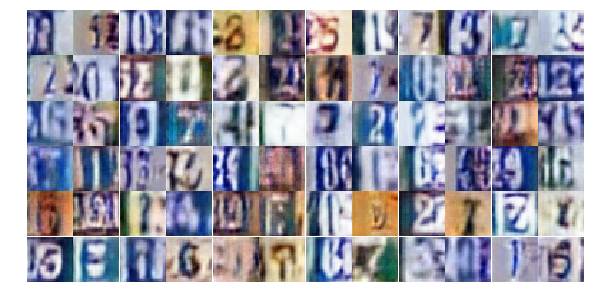

Epoch 8/25... Discriminator Loss: 0.4809... Generator Loss: 1.4388
Epoch 8/25... Discriminator Loss: 0.6728... Generator Loss: 1.0653
Epoch 8/25... Discriminator Loss: 0.9930... Generator Loss: 3.2019
Epoch 8/25... Discriminator Loss: 1.7858... Generator Loss: 0.2691
Epoch 8/25... Discriminator Loss: 0.4632... Generator Loss: 1.3456
Epoch 8/25... Discriminator Loss: 1.2321... Generator Loss: 0.4809
Epoch 8/25... Discriminator Loss: 0.7038... Generator Loss: 0.9635
Epoch 8/25... Discriminator Loss: 0.5977... Generator Loss: 1.6724
Epoch 9/25... Discriminator Loss: 0.7672... Generator Loss: 1.1093
Epoch 9/25... Discriminator Loss: 0.7733... Generator Loss: 0.8933


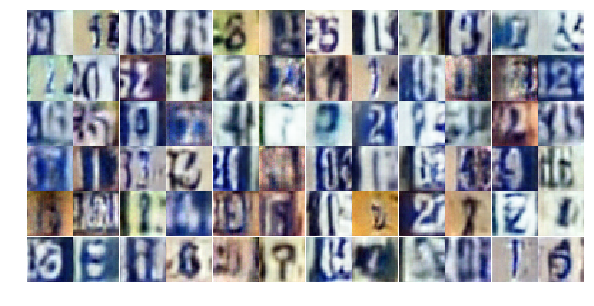

Epoch 9/25... Discriminator Loss: 0.7057... Generator Loss: 0.9273
Epoch 9/25... Discriminator Loss: 0.4893... Generator Loss: 1.6885
Epoch 9/25... Discriminator Loss: 0.7798... Generator Loss: 0.8449
Epoch 9/25... Discriminator Loss: 0.3695... Generator Loss: 1.8904
Epoch 9/25... Discriminator Loss: 1.0915... Generator Loss: 0.7681
Epoch 9/25... Discriminator Loss: 0.9521... Generator Loss: 2.8882
Epoch 9/25... Discriminator Loss: 0.6867... Generator Loss: 1.0322
Epoch 9/25... Discriminator Loss: 0.5576... Generator Loss: 1.2077
Epoch 9/25... Discriminator Loss: 0.5455... Generator Loss: 1.2474
Epoch 9/25... Discriminator Loss: 0.6222... Generator Loss: 1.1375


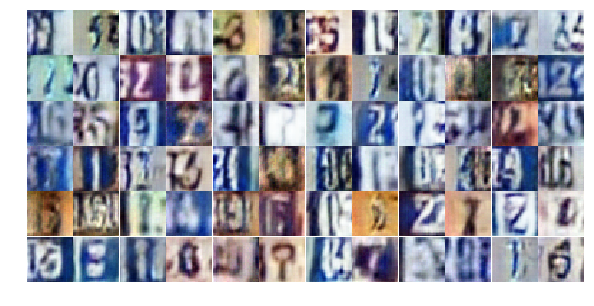

Epoch 9/25... Discriminator Loss: 0.7260... Generator Loss: 0.9321
Epoch 9/25... Discriminator Loss: 0.8767... Generator Loss: 1.1356
Epoch 9/25... Discriminator Loss: 0.9721... Generator Loss: 0.7846
Epoch 9/25... Discriminator Loss: 0.6546... Generator Loss: 1.2127
Epoch 9/25... Discriminator Loss: 0.5463... Generator Loss: 1.4335
Epoch 9/25... Discriminator Loss: 0.6863... Generator Loss: 1.2298
Epoch 9/25... Discriminator Loss: 0.7778... Generator Loss: 0.8346
Epoch 9/25... Discriminator Loss: 0.4107... Generator Loss: 1.7636
Epoch 9/25... Discriminator Loss: 0.8434... Generator Loss: 0.7935
Epoch 9/25... Discriminator Loss: 0.8147... Generator Loss: 0.8284


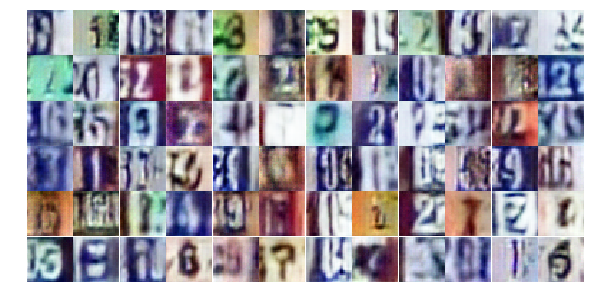

Epoch 9/25... Discriminator Loss: 0.7219... Generator Loss: 1.0009
Epoch 9/25... Discriminator Loss: 1.2647... Generator Loss: 0.4324
Epoch 9/25... Discriminator Loss: 0.5704... Generator Loss: 1.4921
Epoch 9/25... Discriminator Loss: 0.7691... Generator Loss: 0.8417
Epoch 9/25... Discriminator Loss: 0.4540... Generator Loss: 1.3981
Epoch 9/25... Discriminator Loss: 0.4941... Generator Loss: 1.3841
Epoch 9/25... Discriminator Loss: 0.5762... Generator Loss: 1.2464
Epoch 9/25... Discriminator Loss: 0.5092... Generator Loss: 2.1356
Epoch 9/25... Discriminator Loss: 0.5066... Generator Loss: 1.2198
Epoch 9/25... Discriminator Loss: 0.4740... Generator Loss: 1.6389


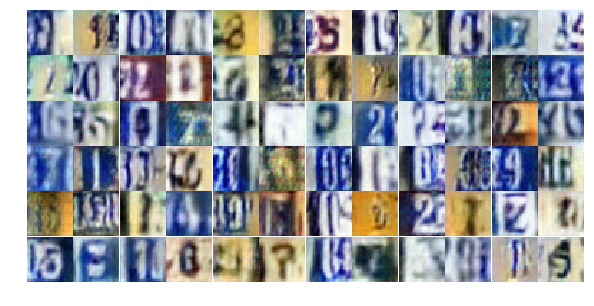

Epoch 9/25... Discriminator Loss: 0.3297... Generator Loss: 1.7067
Epoch 9/25... Discriminator Loss: 0.9349... Generator Loss: 0.7621
Epoch 9/25... Discriminator Loss: 0.4949... Generator Loss: 1.5468
Epoch 9/25... Discriminator Loss: 0.4882... Generator Loss: 1.3975
Epoch 9/25... Discriminator Loss: 0.3523... Generator Loss: 2.0935
Epoch 9/25... Discriminator Loss: 0.4751... Generator Loss: 1.4529
Epoch 9/25... Discriminator Loss: 0.5574... Generator Loss: 2.4347
Epoch 9/25... Discriminator Loss: 0.4154... Generator Loss: 1.5128
Epoch 9/25... Discriminator Loss: 1.2431... Generator Loss: 0.4531
Epoch 9/25... Discriminator Loss: 0.7038... Generator Loss: 0.9493


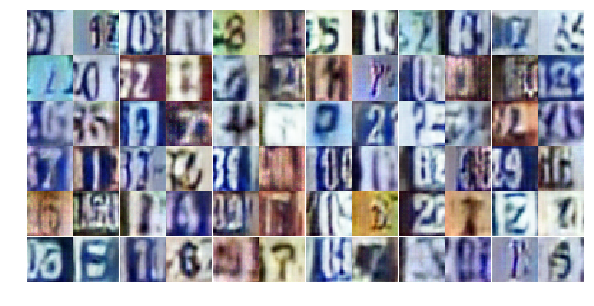

Epoch 9/25... Discriminator Loss: 0.5114... Generator Loss: 2.0555
Epoch 9/25... Discriminator Loss: 2.3894... Generator Loss: 4.5357
Epoch 9/25... Discriminator Loss: 0.9054... Generator Loss: 2.0629
Epoch 9/25... Discriminator Loss: 0.7289... Generator Loss: 1.0145
Epoch 9/25... Discriminator Loss: 0.5603... Generator Loss: 1.3994
Epoch 9/25... Discriminator Loss: 0.7602... Generator Loss: 1.1333
Epoch 9/25... Discriminator Loss: 0.6962... Generator Loss: 1.1249
Epoch 9/25... Discriminator Loss: 0.8757... Generator Loss: 0.7496
Epoch 9/25... Discriminator Loss: 0.6174... Generator Loss: 1.1264
Epoch 9/25... Discriminator Loss: 0.6390... Generator Loss: 2.3091


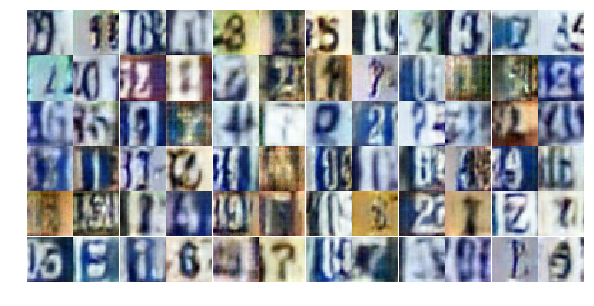

Epoch 9/25... Discriminator Loss: 0.6105... Generator Loss: 1.1263
Epoch 9/25... Discriminator Loss: 1.3040... Generator Loss: 2.5900
Epoch 9/25... Discriminator Loss: 0.6032... Generator Loss: 1.2191
Epoch 9/25... Discriminator Loss: 1.3555... Generator Loss: 0.4218
Epoch 9/25... Discriminator Loss: 0.5095... Generator Loss: 1.4105
Epoch 10/25... Discriminator Loss: 0.4550... Generator Loss: 1.7134
Epoch 10/25... Discriminator Loss: 0.5816... Generator Loss: 1.4619
Epoch 10/25... Discriminator Loss: 0.4153... Generator Loss: 1.7821
Epoch 10/25... Discriminator Loss: 0.5844... Generator Loss: 1.2104
Epoch 10/25... Discriminator Loss: 1.1052... Generator Loss: 0.5298


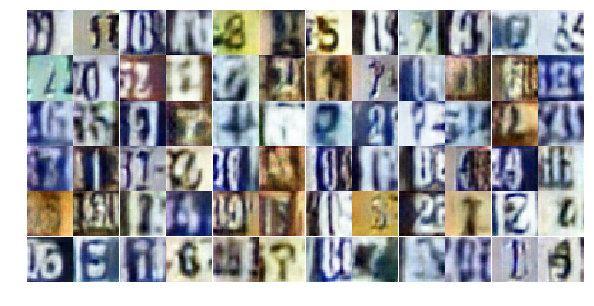

Epoch 10/25... Discriminator Loss: 0.6386... Generator Loss: 1.0831
Epoch 10/25... Discriminator Loss: 0.5670... Generator Loss: 1.3008
Epoch 10/25... Discriminator Loss: 0.6309... Generator Loss: 1.0243
Epoch 10/25... Discriminator Loss: 0.5066... Generator Loss: 1.4726
Epoch 10/25... Discriminator Loss: 0.3325... Generator Loss: 1.8661
Epoch 10/25... Discriminator Loss: 0.7171... Generator Loss: 1.6337
Epoch 10/25... Discriminator Loss: 0.4342... Generator Loss: 1.3582
Epoch 10/25... Discriminator Loss: 0.9731... Generator Loss: 0.6780
Epoch 10/25... Discriminator Loss: 1.7246... Generator Loss: 0.3185
Epoch 10/25... Discriminator Loss: 0.7012... Generator Loss: 0.9590


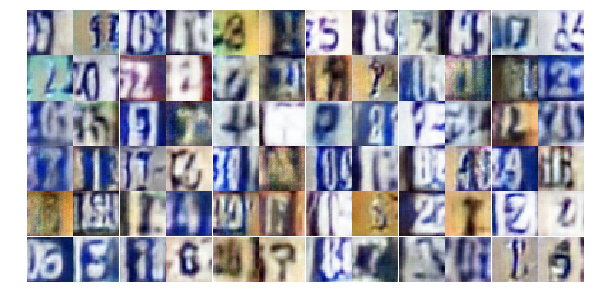

Epoch 10/25... Discriminator Loss: 0.6540... Generator Loss: 1.0675
Epoch 10/25... Discriminator Loss: 0.8463... Generator Loss: 0.8392
Epoch 10/25... Discriminator Loss: 0.4563... Generator Loss: 1.3783
Epoch 10/25... Discriminator Loss: 0.7838... Generator Loss: 0.8359
Epoch 10/25... Discriminator Loss: 0.5082... Generator Loss: 1.4511
Epoch 10/25... Discriminator Loss: 0.4396... Generator Loss: 1.5336
Epoch 10/25... Discriminator Loss: 0.5557... Generator Loss: 1.3469
Epoch 10/25... Discriminator Loss: 0.5543... Generator Loss: 1.2345
Epoch 10/25... Discriminator Loss: 0.5418... Generator Loss: 1.2600
Epoch 10/25... Discriminator Loss: 0.3851... Generator Loss: 2.3049


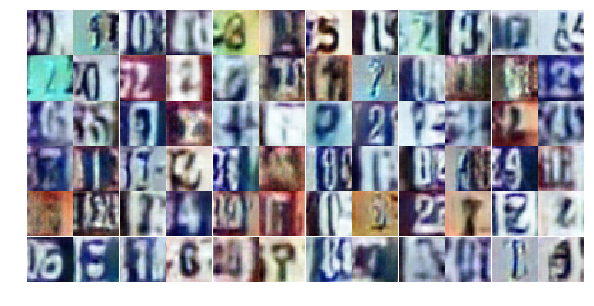

Epoch 10/25... Discriminator Loss: 1.1240... Generator Loss: 0.5286
Epoch 10/25... Discriminator Loss: 0.9375... Generator Loss: 0.8965
Epoch 10/25... Discriminator Loss: 0.3787... Generator Loss: 1.7483
Epoch 10/25... Discriminator Loss: 0.4255... Generator Loss: 1.8518
Epoch 10/25... Discriminator Loss: 1.2511... Generator Loss: 0.4164
Epoch 10/25... Discriminator Loss: 0.6404... Generator Loss: 1.0865
Epoch 10/25... Discriminator Loss: 0.2833... Generator Loss: 1.9714
Epoch 10/25... Discriminator Loss: 0.5863... Generator Loss: 1.1811
Epoch 10/25... Discriminator Loss: 0.5994... Generator Loss: 1.0712
Epoch 10/25... Discriminator Loss: 0.5717... Generator Loss: 1.8452


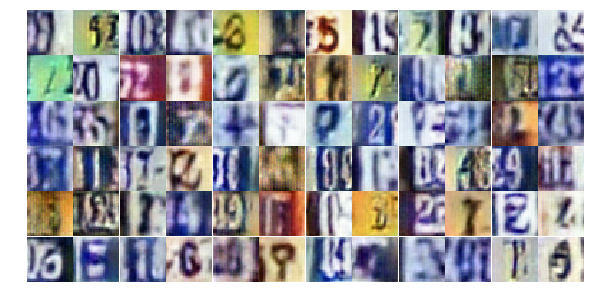

Epoch 10/25... Discriminator Loss: 0.5455... Generator Loss: 2.4568
Epoch 10/25... Discriminator Loss: 0.7106... Generator Loss: 1.0105
Epoch 10/25... Discriminator Loss: 0.5010... Generator Loss: 2.5731
Epoch 10/25... Discriminator Loss: 1.1585... Generator Loss: 0.7284
Epoch 10/25... Discriminator Loss: 1.2152... Generator Loss: 0.4948
Epoch 10/25... Discriminator Loss: 0.8110... Generator Loss: 0.9015
Epoch 10/25... Discriminator Loss: 0.8360... Generator Loss: 0.8158
Epoch 10/25... Discriminator Loss: 1.0269... Generator Loss: 0.6427
Epoch 10/25... Discriminator Loss: 0.5428... Generator Loss: 1.2131
Epoch 10/25... Discriminator Loss: 0.5084... Generator Loss: 2.3928


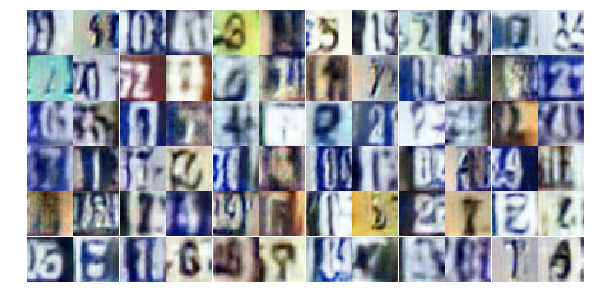

Epoch 10/25... Discriminator Loss: 1.4841... Generator Loss: 0.3978
Epoch 10/25... Discriminator Loss: 0.6164... Generator Loss: 1.1805
Epoch 10/25... Discriminator Loss: 0.8908... Generator Loss: 0.7331
Epoch 10/25... Discriminator Loss: 0.5458... Generator Loss: 1.2489
Epoch 10/25... Discriminator Loss: 0.4380... Generator Loss: 1.7485
Epoch 10/25... Discriminator Loss: 0.5711... Generator Loss: 1.0944
Epoch 10/25... Discriminator Loss: 1.1900... Generator Loss: 0.4901
Epoch 10/25... Discriminator Loss: 0.4995... Generator Loss: 2.1585
Epoch 10/25... Discriminator Loss: 0.4240... Generator Loss: 1.8809
Epoch 10/25... Discriminator Loss: 0.8558... Generator Loss: 0.8906


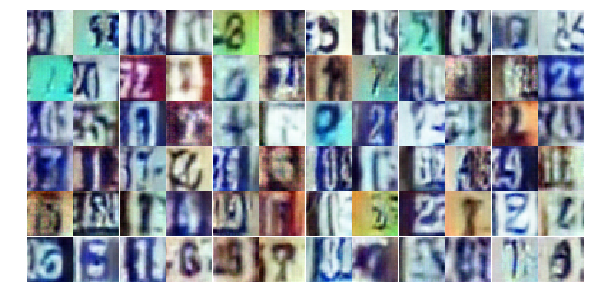

Epoch 10/25... Discriminator Loss: 0.7182... Generator Loss: 2.3015
Epoch 10/25... Discriminator Loss: 0.5825... Generator Loss: 1.3723
Epoch 10/25... Discriminator Loss: 0.4194... Generator Loss: 1.4281
Epoch 11/25... Discriminator Loss: 0.8241... Generator Loss: 0.8297
Epoch 11/25... Discriminator Loss: 0.6193... Generator Loss: 1.0714
Epoch 11/25... Discriminator Loss: 1.1326... Generator Loss: 0.5148
Epoch 11/25... Discriminator Loss: 0.9144... Generator Loss: 0.6807
Epoch 11/25... Discriminator Loss: 0.4791... Generator Loss: 1.6092
Epoch 11/25... Discriminator Loss: 1.8206... Generator Loss: 0.2541
Epoch 11/25... Discriminator Loss: 0.6285... Generator Loss: 1.5342


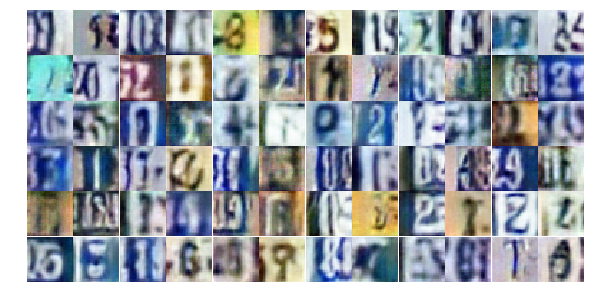

Epoch 11/25... Discriminator Loss: 0.5030... Generator Loss: 1.4365
Epoch 11/25... Discriminator Loss: 0.4997... Generator Loss: 1.8514
Epoch 11/25... Discriminator Loss: 0.4940... Generator Loss: 1.2963
Epoch 11/25... Discriminator Loss: 0.5277... Generator Loss: 1.3388
Epoch 11/25... Discriminator Loss: 0.8184... Generator Loss: 0.8702
Epoch 11/25... Discriminator Loss: 0.4458... Generator Loss: 1.8071
Epoch 11/25... Discriminator Loss: 0.5761... Generator Loss: 1.4575
Epoch 11/25... Discriminator Loss: 0.2781... Generator Loss: 2.6812
Epoch 11/25... Discriminator Loss: 1.0113... Generator Loss: 0.7143
Epoch 11/25... Discriminator Loss: 1.5709... Generator Loss: 0.3253


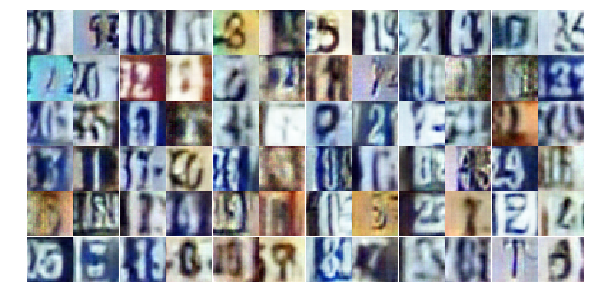

Epoch 11/25... Discriminator Loss: 0.7693... Generator Loss: 1.1553
Epoch 11/25... Discriminator Loss: 0.4219... Generator Loss: 1.5362
Epoch 11/25... Discriminator Loss: 0.5678... Generator Loss: 1.1157
Epoch 11/25... Discriminator Loss: 0.8864... Generator Loss: 0.6781
Epoch 11/25... Discriminator Loss: 0.3177... Generator Loss: 1.8954
Epoch 11/25... Discriminator Loss: 0.4455... Generator Loss: 1.7820
Epoch 11/25... Discriminator Loss: 0.4730... Generator Loss: 1.4026
Epoch 11/25... Discriminator Loss: 0.9087... Generator Loss: 0.9028
Epoch 11/25... Discriminator Loss: 0.5173... Generator Loss: 1.9356
Epoch 11/25... Discriminator Loss: 0.6555... Generator Loss: 0.9991


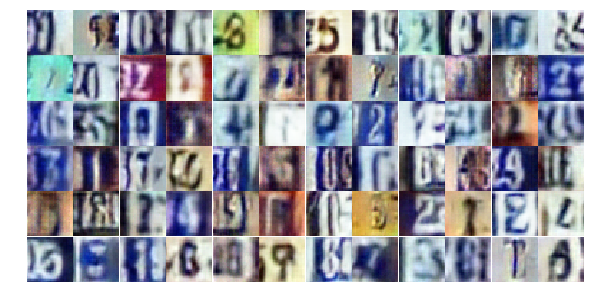

Epoch 11/25... Discriminator Loss: 1.1937... Generator Loss: 0.5317
Epoch 11/25... Discriminator Loss: 0.6158... Generator Loss: 1.3909
Epoch 11/25... Discriminator Loss: 0.9323... Generator Loss: 0.8240
Epoch 11/25... Discriminator Loss: 0.5211... Generator Loss: 1.2510
Epoch 11/25... Discriminator Loss: 0.6154... Generator Loss: 1.0676
Epoch 11/25... Discriminator Loss: 0.9873... Generator Loss: 0.6200
Epoch 11/25... Discriminator Loss: 1.1676... Generator Loss: 0.5358
Epoch 11/25... Discriminator Loss: 0.8323... Generator Loss: 0.8451
Epoch 11/25... Discriminator Loss: 0.5342... Generator Loss: 1.5078
Epoch 11/25... Discriminator Loss: 1.0312... Generator Loss: 0.5590


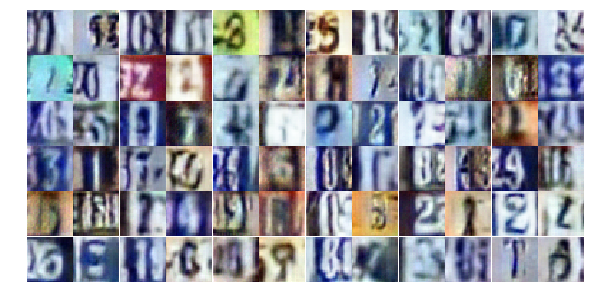

Epoch 11/25... Discriminator Loss: 0.3472... Generator Loss: 1.6967
Epoch 11/25... Discriminator Loss: 0.4299... Generator Loss: 1.7240
Epoch 11/25... Discriminator Loss: 0.5910... Generator Loss: 1.1698
Epoch 11/25... Discriminator Loss: 0.4952... Generator Loss: 1.8540
Epoch 11/25... Discriminator Loss: 0.5953... Generator Loss: 1.0944
Epoch 11/25... Discriminator Loss: 0.6268... Generator Loss: 1.0946
Epoch 11/25... Discriminator Loss: 0.5494... Generator Loss: 1.3249
Epoch 11/25... Discriminator Loss: 0.5137... Generator Loss: 2.1643
Epoch 11/25... Discriminator Loss: 0.8956... Generator Loss: 0.8387
Epoch 11/25... Discriminator Loss: 0.4490... Generator Loss: 1.5199


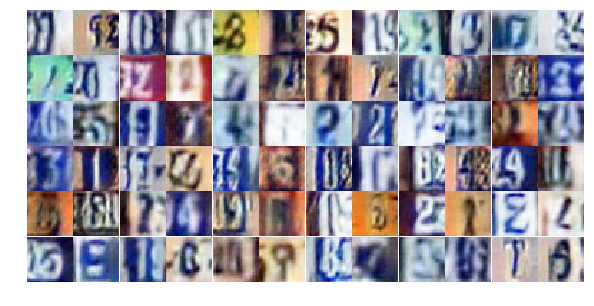

Epoch 11/25... Discriminator Loss: 0.7140... Generator Loss: 0.9311
Epoch 11/25... Discriminator Loss: 0.3827... Generator Loss: 1.7722
Epoch 11/25... Discriminator Loss: 0.4555... Generator Loss: 1.7353
Epoch 11/25... Discriminator Loss: 1.0129... Generator Loss: 0.6191
Epoch 11/25... Discriminator Loss: 0.8669... Generator Loss: 0.7341
Epoch 11/25... Discriminator Loss: 0.7527... Generator Loss: 1.0966
Epoch 11/25... Discriminator Loss: 1.9439... Generator Loss: 0.2188
Epoch 11/25... Discriminator Loss: 0.3815... Generator Loss: 1.9870
Epoch 11/25... Discriminator Loss: 0.9247... Generator Loss: 0.7022
Epoch 11/25... Discriminator Loss: 0.7127... Generator Loss: 0.9424


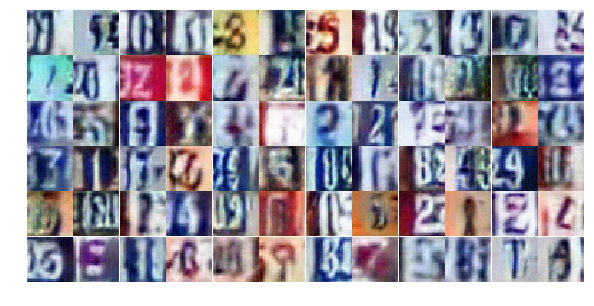

Epoch 12/25... Discriminator Loss: 0.9083... Generator Loss: 0.7299
Epoch 12/25... Discriminator Loss: 0.4925... Generator Loss: 1.8769
Epoch 12/25... Discriminator Loss: 0.7274... Generator Loss: 0.9265
Epoch 12/25... Discriminator Loss: 0.4547... Generator Loss: 1.5342
Epoch 12/25... Discriminator Loss: 0.4856... Generator Loss: 1.4728
Epoch 12/25... Discriminator Loss: 0.8896... Generator Loss: 0.6779
Epoch 12/25... Discriminator Loss: 0.3773... Generator Loss: 1.9350
Epoch 12/25... Discriminator Loss: 0.6582... Generator Loss: 1.0981
Epoch 12/25... Discriminator Loss: 0.6856... Generator Loss: 1.1050
Epoch 12/25... Discriminator Loss: 1.1372... Generator Loss: 0.5517


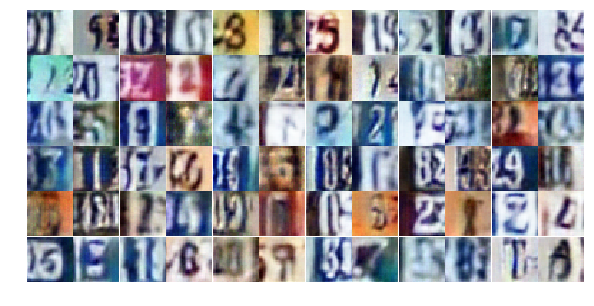

Epoch 12/25... Discriminator Loss: 0.4575... Generator Loss: 1.3439
Epoch 12/25... Discriminator Loss: 0.9736... Generator Loss: 0.6669
Epoch 12/25... Discriminator Loss: 0.2717... Generator Loss: 1.9040
Epoch 12/25... Discriminator Loss: 1.1051... Generator Loss: 2.5895
Epoch 12/25... Discriminator Loss: 0.4330... Generator Loss: 1.8810
Epoch 12/25... Discriminator Loss: 1.5180... Generator Loss: 0.3824
Epoch 12/25... Discriminator Loss: 1.0916... Generator Loss: 0.5441
Epoch 12/25... Discriminator Loss: 0.3661... Generator Loss: 1.8566
Epoch 12/25... Discriminator Loss: 0.5503... Generator Loss: 1.2898
Epoch 12/25... Discriminator Loss: 0.6292... Generator Loss: 1.0836


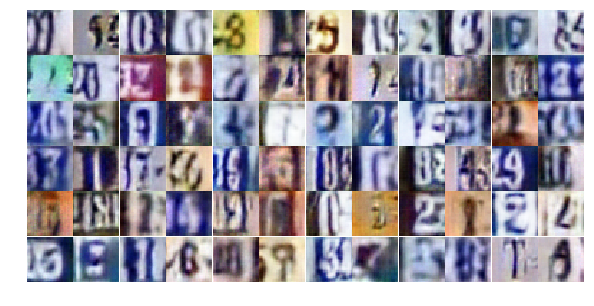

Epoch 12/25... Discriminator Loss: 0.3705... Generator Loss: 2.0207
Epoch 12/25... Discriminator Loss: 0.3620... Generator Loss: 1.6284
Epoch 12/25... Discriminator Loss: 0.5233... Generator Loss: 1.4113
Epoch 12/25... Discriminator Loss: 0.4837... Generator Loss: 1.3032
Epoch 12/25... Discriminator Loss: 0.6050... Generator Loss: 1.1785
Epoch 12/25... Discriminator Loss: 0.5557... Generator Loss: 1.1827
Epoch 12/25... Discriminator Loss: 0.5567... Generator Loss: 1.1621
Epoch 12/25... Discriminator Loss: 0.3670... Generator Loss: 1.8822
Epoch 12/25... Discriminator Loss: 0.7948... Generator Loss: 0.9113
Epoch 12/25... Discriminator Loss: 0.3773... Generator Loss: 1.8229


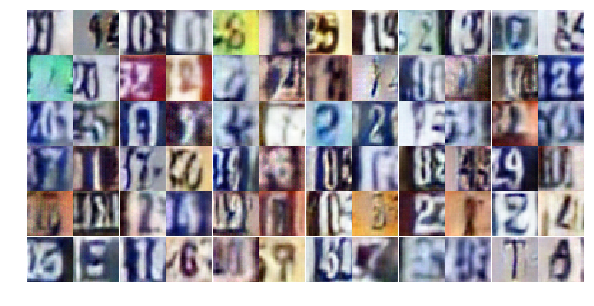

Epoch 12/25... Discriminator Loss: 0.4136... Generator Loss: 1.7379
Epoch 12/25... Discriminator Loss: 1.1079... Generator Loss: 0.5938
Epoch 12/25... Discriminator Loss: 0.9665... Generator Loss: 0.6662
Epoch 12/25... Discriminator Loss: 1.9310... Generator Loss: 0.3458
Epoch 12/25... Discriminator Loss: 0.9241... Generator Loss: 3.0604
Epoch 12/25... Discriminator Loss: 1.7894... Generator Loss: 4.0943
Epoch 12/25... Discriminator Loss: 1.2561... Generator Loss: 0.6592
Epoch 12/25... Discriminator Loss: 0.9543... Generator Loss: 0.8776
Epoch 12/25... Discriminator Loss: 0.5797... Generator Loss: 1.3199
Epoch 12/25... Discriminator Loss: 0.4062... Generator Loss: 1.5815


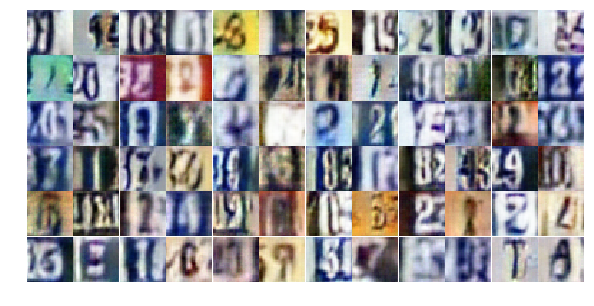

Epoch 12/25... Discriminator Loss: 0.4867... Generator Loss: 1.4156
Epoch 12/25... Discriminator Loss: 0.5275... Generator Loss: 1.2094
Epoch 12/25... Discriminator Loss: 0.4126... Generator Loss: 1.5596
Epoch 12/25... Discriminator Loss: 0.9154... Generator Loss: 2.3063
Epoch 12/25... Discriminator Loss: 0.6830... Generator Loss: 1.1397
Epoch 12/25... Discriminator Loss: 0.9318... Generator Loss: 0.6627
Epoch 12/25... Discriminator Loss: 0.5144... Generator Loss: 1.4637
Epoch 12/25... Discriminator Loss: 0.7602... Generator Loss: 0.9127
Epoch 12/25... Discriminator Loss: 0.4586... Generator Loss: 1.3766
Epoch 12/25... Discriminator Loss: 0.6955... Generator Loss: 0.9205


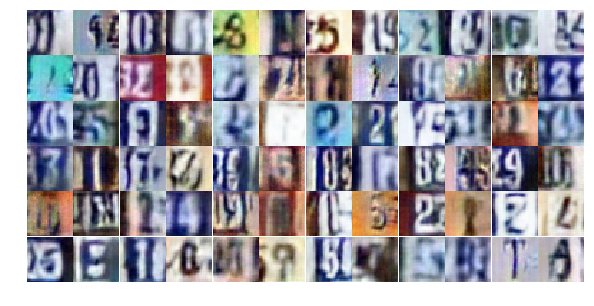

Epoch 12/25... Discriminator Loss: 1.0732... Generator Loss: 0.5893
Epoch 12/25... Discriminator Loss: 0.6947... Generator Loss: 0.9818
Epoch 12/25... Discriminator Loss: 0.5598... Generator Loss: 1.6908
Epoch 12/25... Discriminator Loss: 2.0831... Generator Loss: 0.1949
Epoch 12/25... Discriminator Loss: 0.6946... Generator Loss: 0.9817
Epoch 12/25... Discriminator Loss: 0.6501... Generator Loss: 2.0008
Epoch 12/25... Discriminator Loss: 0.8351... Generator Loss: 0.8565
Epoch 13/25... Discriminator Loss: 0.6059... Generator Loss: 1.0914
Epoch 13/25... Discriminator Loss: 0.5107... Generator Loss: 1.3625
Epoch 13/25... Discriminator Loss: 1.0831... Generator Loss: 0.5545


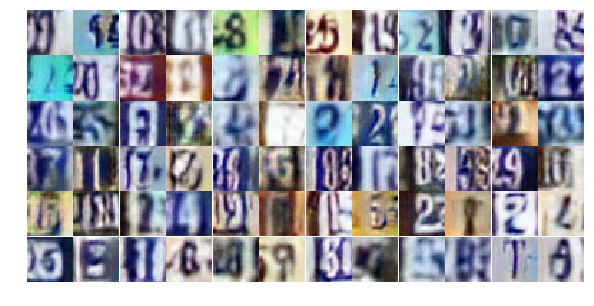

Epoch 13/25... Discriminator Loss: 1.1979... Generator Loss: 0.5219
Epoch 13/25... Discriminator Loss: 0.5233... Generator Loss: 1.3307
Epoch 13/25... Discriminator Loss: 0.7774... Generator Loss: 1.0257
Epoch 13/25... Discriminator Loss: 1.1614... Generator Loss: 0.5517
Epoch 13/25... Discriminator Loss: 0.5084... Generator Loss: 1.3924
Epoch 13/25... Discriminator Loss: 0.3958... Generator Loss: 1.7191
Epoch 13/25... Discriminator Loss: 0.6111... Generator Loss: 1.2197
Epoch 13/25... Discriminator Loss: 0.5243... Generator Loss: 1.3155
Epoch 13/25... Discriminator Loss: 0.4522... Generator Loss: 1.4063
Epoch 13/25... Discriminator Loss: 0.4818... Generator Loss: 1.9049


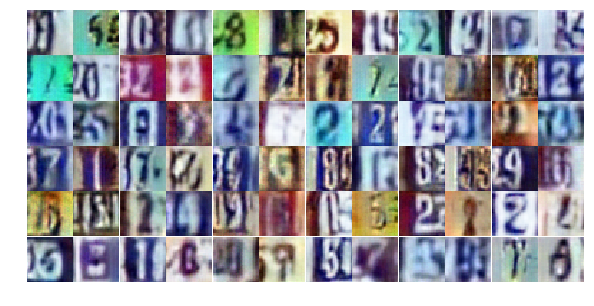

Epoch 13/25... Discriminator Loss: 0.5599... Generator Loss: 2.2705
Epoch 13/25... Discriminator Loss: 0.5781... Generator Loss: 1.1720
Epoch 13/25... Discriminator Loss: 0.8423... Generator Loss: 0.9139
Epoch 13/25... Discriminator Loss: 0.5711... Generator Loss: 1.2590
Epoch 13/25... Discriminator Loss: 0.4407... Generator Loss: 1.5426
Epoch 13/25... Discriminator Loss: 0.8687... Generator Loss: 0.7342
Epoch 13/25... Discriminator Loss: 0.5144... Generator Loss: 1.3164
Epoch 13/25... Discriminator Loss: 0.9652... Generator Loss: 0.6397
Epoch 13/25... Discriminator Loss: 0.5336... Generator Loss: 1.2397
Epoch 13/25... Discriminator Loss: 1.1920... Generator Loss: 0.5260


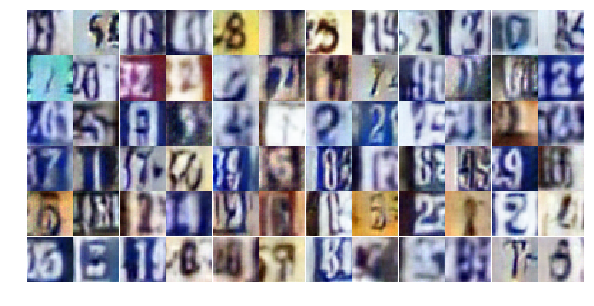

Epoch 13/25... Discriminator Loss: 0.6962... Generator Loss: 1.3937
Epoch 13/25... Discriminator Loss: 0.6817... Generator Loss: 1.4332
Epoch 13/25... Discriminator Loss: 0.4818... Generator Loss: 1.9129
Epoch 13/25... Discriminator Loss: 0.5422... Generator Loss: 1.1296
Epoch 13/25... Discriminator Loss: 0.6018... Generator Loss: 1.1607
Epoch 13/25... Discriminator Loss: 0.6880... Generator Loss: 0.9848
Epoch 13/25... Discriminator Loss: 0.6588... Generator Loss: 1.0909
Epoch 13/25... Discriminator Loss: 0.5070... Generator Loss: 1.3328
Epoch 13/25... Discriminator Loss: 0.4855... Generator Loss: 1.3152
Epoch 13/25... Discriminator Loss: 0.4629... Generator Loss: 1.7537


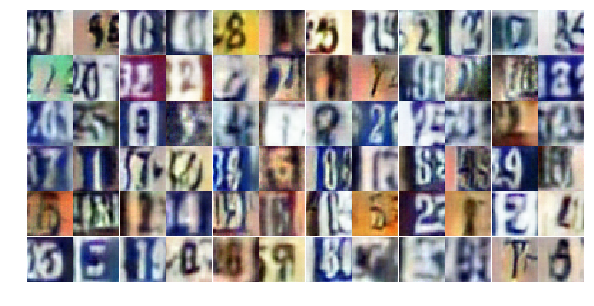

Epoch 13/25... Discriminator Loss: 1.3858... Generator Loss: 0.3910
Epoch 13/25... Discriminator Loss: 0.9779... Generator Loss: 0.6274
Epoch 13/25... Discriminator Loss: 0.6973... Generator Loss: 1.4270
Epoch 13/25... Discriminator Loss: 0.7164... Generator Loss: 1.4390
Epoch 13/25... Discriminator Loss: 0.7594... Generator Loss: 0.9328
Epoch 13/25... Discriminator Loss: 0.7840... Generator Loss: 0.8312
Epoch 13/25... Discriminator Loss: 0.3916... Generator Loss: 1.5193
Epoch 13/25... Discriminator Loss: 1.0707... Generator Loss: 0.6261
Epoch 13/25... Discriminator Loss: 0.5491... Generator Loss: 1.3841
Epoch 13/25... Discriminator Loss: 0.6669... Generator Loss: 1.0758


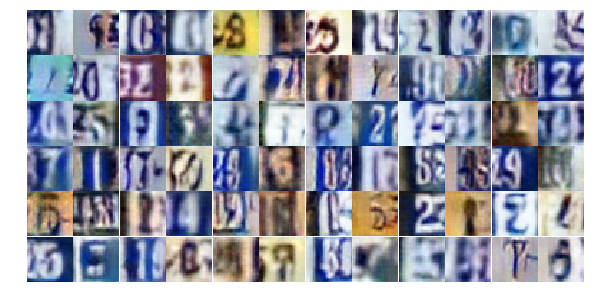

Epoch 13/25... Discriminator Loss: 0.3775... Generator Loss: 1.8879
Epoch 13/25... Discriminator Loss: 0.8227... Generator Loss: 1.5490
Epoch 13/25... Discriminator Loss: 1.2849... Generator Loss: 0.5116
Epoch 13/25... Discriminator Loss: 0.6529... Generator Loss: 1.1255
Epoch 13/25... Discriminator Loss: 0.9344... Generator Loss: 0.7022
Epoch 13/25... Discriminator Loss: 0.5970... Generator Loss: 1.5369
Epoch 13/25... Discriminator Loss: 0.6759... Generator Loss: 1.0363
Epoch 13/25... Discriminator Loss: 0.6262... Generator Loss: 1.1737
Epoch 13/25... Discriminator Loss: 1.0753... Generator Loss: 0.6110
Epoch 13/25... Discriminator Loss: 0.8318... Generator Loss: 0.8039


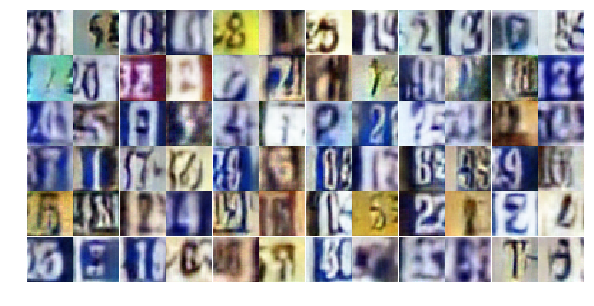

Epoch 13/25... Discriminator Loss: 0.2664... Generator Loss: 2.2269
Epoch 13/25... Discriminator Loss: 1.0778... Generator Loss: 0.5916
Epoch 13/25... Discriminator Loss: 0.7241... Generator Loss: 0.8668
Epoch 13/25... Discriminator Loss: 0.7925... Generator Loss: 0.8420
Epoch 14/25... Discriminator Loss: 1.1182... Generator Loss: 0.6467
Epoch 14/25... Discriminator Loss: 0.7923... Generator Loss: 0.9102
Epoch 14/25... Discriminator Loss: 0.5568... Generator Loss: 1.2868
Epoch 14/25... Discriminator Loss: 0.4563... Generator Loss: 2.5408
Epoch 14/25... Discriminator Loss: 0.4402... Generator Loss: 1.5044
Epoch 14/25... Discriminator Loss: 1.0965... Generator Loss: 2.4733


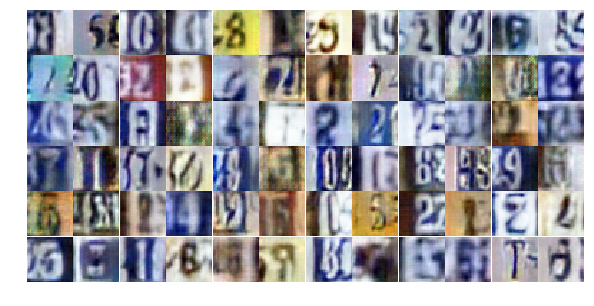

Epoch 14/25... Discriminator Loss: 0.5274... Generator Loss: 2.4264
Epoch 14/25... Discriminator Loss: 0.5702... Generator Loss: 1.1387
Epoch 14/25... Discriminator Loss: 0.4446... Generator Loss: 1.5912
Epoch 14/25... Discriminator Loss: 0.6511... Generator Loss: 1.1006
Epoch 14/25... Discriminator Loss: 0.8496... Generator Loss: 0.7413
Epoch 14/25... Discriminator Loss: 0.4996... Generator Loss: 1.1682
Epoch 14/25... Discriminator Loss: 0.3744... Generator Loss: 2.3171
Epoch 14/25... Discriminator Loss: 1.4523... Generator Loss: 0.4195
Epoch 14/25... Discriminator Loss: 1.3010... Generator Loss: 0.4447
Epoch 14/25... Discriminator Loss: 2.7617... Generator Loss: 0.1053


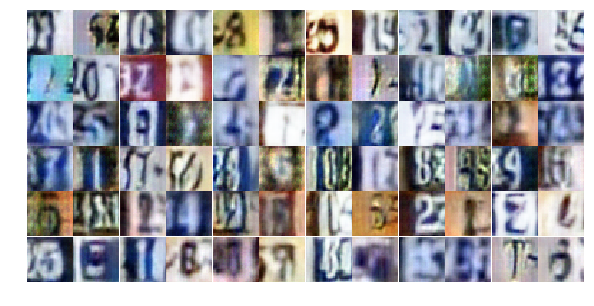

Epoch 14/25... Discriminator Loss: 0.5957... Generator Loss: 1.1646
Epoch 14/25... Discriminator Loss: 0.6169... Generator Loss: 2.2041
Epoch 14/25... Discriminator Loss: 0.8365... Generator Loss: 0.9875
Epoch 14/25... Discriminator Loss: 0.4063... Generator Loss: 1.6177
Epoch 14/25... Discriminator Loss: 0.6278... Generator Loss: 1.0936
Epoch 14/25... Discriminator Loss: 0.8340... Generator Loss: 0.8269
Epoch 14/25... Discriminator Loss: 0.9392... Generator Loss: 0.7309
Epoch 14/25... Discriminator Loss: 0.6528... Generator Loss: 1.1007
Epoch 14/25... Discriminator Loss: 0.4935... Generator Loss: 1.4268
Epoch 14/25... Discriminator Loss: 0.2980... Generator Loss: 1.9748


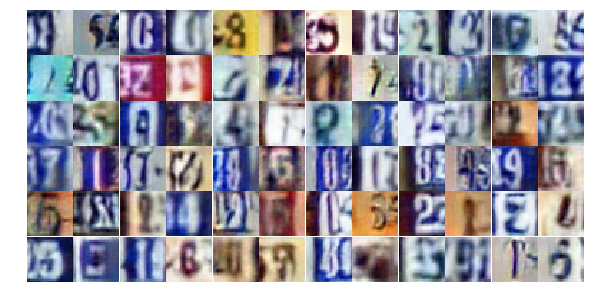

Epoch 14/25... Discriminator Loss: 1.2191... Generator Loss: 0.5130
Epoch 14/25... Discriminator Loss: 0.5350... Generator Loss: 1.2267
Epoch 14/25... Discriminator Loss: 0.5587... Generator Loss: 1.3188
Epoch 14/25... Discriminator Loss: 0.3970... Generator Loss: 2.1643
Epoch 14/25... Discriminator Loss: 0.5712... Generator Loss: 1.2158
Epoch 14/25... Discriminator Loss: 0.7192... Generator Loss: 1.1941
Epoch 14/25... Discriminator Loss: 0.5327... Generator Loss: 1.3005
Epoch 14/25... Discriminator Loss: 0.3786... Generator Loss: 1.5200
Epoch 14/25... Discriminator Loss: 0.3969... Generator Loss: 1.9248
Epoch 14/25... Discriminator Loss: 0.7390... Generator Loss: 0.9524


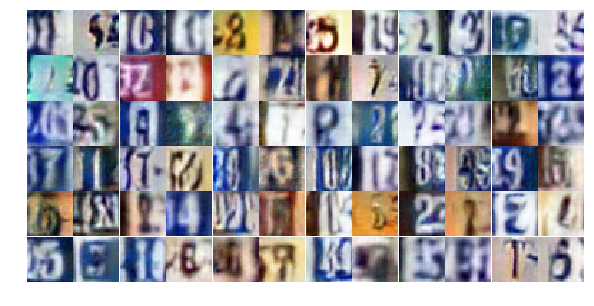

Epoch 14/25... Discriminator Loss: 1.2628... Generator Loss: 0.4682
Epoch 14/25... Discriminator Loss: 1.1114... Generator Loss: 0.5689
Epoch 14/25... Discriminator Loss: 1.1942... Generator Loss: 0.5551
Epoch 14/25... Discriminator Loss: 0.8265... Generator Loss: 0.7638
Epoch 14/25... Discriminator Loss: 0.9627... Generator Loss: 0.6721
Epoch 14/25... Discriminator Loss: 0.5227... Generator Loss: 1.4887
Epoch 14/25... Discriminator Loss: 0.5001... Generator Loss: 1.4838
Epoch 14/25... Discriminator Loss: 0.4618... Generator Loss: 1.7843
Epoch 14/25... Discriminator Loss: 0.3963... Generator Loss: 1.6123
Epoch 14/25... Discriminator Loss: 1.2586... Generator Loss: 0.5196


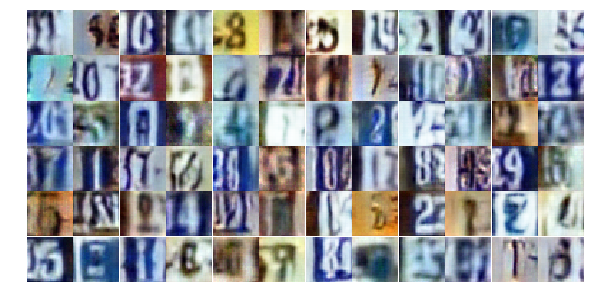

Epoch 14/25... Discriminator Loss: 1.0045... Generator Loss: 0.8500
Epoch 14/25... Discriminator Loss: 1.0219... Generator Loss: 0.6269
Epoch 14/25... Discriminator Loss: 0.5120... Generator Loss: 1.3321
Epoch 14/25... Discriminator Loss: 0.8273... Generator Loss: 0.7962
Epoch 14/25... Discriminator Loss: 0.5569... Generator Loss: 1.2276
Epoch 14/25... Discriminator Loss: 0.6865... Generator Loss: 0.9917
Epoch 14/25... Discriminator Loss: 1.0178... Generator Loss: 0.6416
Epoch 14/25... Discriminator Loss: 1.0344... Generator Loss: 0.5883
Epoch 14/25... Discriminator Loss: 1.1749... Generator Loss: 0.4942
Epoch 14/25... Discriminator Loss: 0.8618... Generator Loss: 0.7981


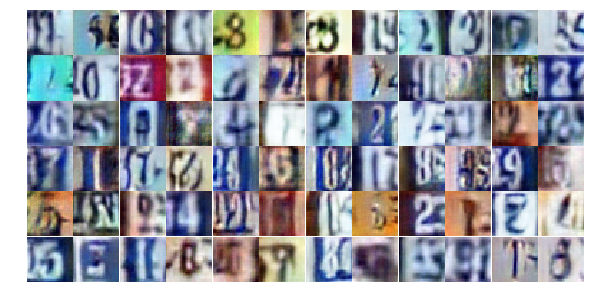

Epoch 14/25... Discriminator Loss: 0.8001... Generator Loss: 1.0838
Epoch 14/25... Discriminator Loss: 0.9201... Generator Loss: 0.7274
Epoch 15/25... Discriminator Loss: 0.6922... Generator Loss: 0.9433
Epoch 15/25... Discriminator Loss: 0.3887... Generator Loss: 1.8335
Epoch 15/25... Discriminator Loss: 0.5179... Generator Loss: 1.5168
Epoch 15/25... Discriminator Loss: 0.8192... Generator Loss: 0.8151
Epoch 15/25... Discriminator Loss: 0.8096... Generator Loss: 0.8112
Epoch 15/25... Discriminator Loss: 0.5262... Generator Loss: 1.6684
Epoch 15/25... Discriminator Loss: 2.1843... Generator Loss: 0.1840
Epoch 15/25... Discriminator Loss: 0.5613... Generator Loss: 1.4448


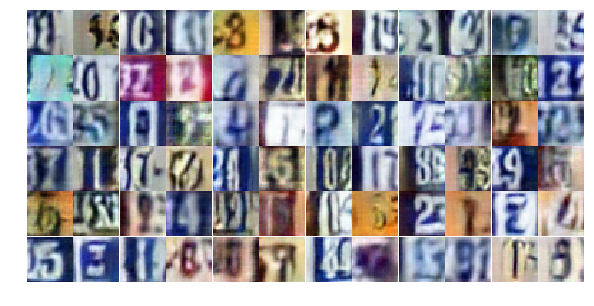

Epoch 15/25... Discriminator Loss: 0.7702... Generator Loss: 0.9828
Epoch 15/25... Discriminator Loss: 0.7500... Generator Loss: 1.5136
Epoch 15/25... Discriminator Loss: 0.8464... Generator Loss: 1.0499
Epoch 15/25... Discriminator Loss: 0.5951... Generator Loss: 1.2202
Epoch 15/25... Discriminator Loss: 0.8628... Generator Loss: 0.8421
Epoch 15/25... Discriminator Loss: 0.4142... Generator Loss: 1.7497
Epoch 15/25... Discriminator Loss: 1.6495... Generator Loss: 0.3291
Epoch 15/25... Discriminator Loss: 0.7874... Generator Loss: 1.0381
Epoch 15/25... Discriminator Loss: 0.4868... Generator Loss: 3.0949
Epoch 15/25... Discriminator Loss: 1.3562... Generator Loss: 0.4435


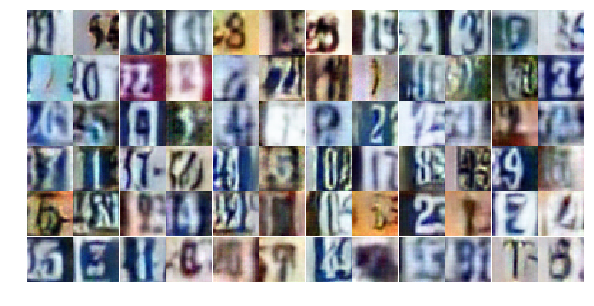

Epoch 15/25... Discriminator Loss: 0.6761... Generator Loss: 1.0740
Epoch 15/25... Discriminator Loss: 0.5385... Generator Loss: 1.2834
Epoch 15/25... Discriminator Loss: 0.4487... Generator Loss: 1.5654
Epoch 15/25... Discriminator Loss: 0.7197... Generator Loss: 1.0180
Epoch 15/25... Discriminator Loss: 0.9950... Generator Loss: 0.6792
Epoch 15/25... Discriminator Loss: 0.6134... Generator Loss: 1.0989
Epoch 15/25... Discriminator Loss: 1.8283... Generator Loss: 0.2583
Epoch 15/25... Discriminator Loss: 0.8573... Generator Loss: 0.8111
Epoch 15/25... Discriminator Loss: 0.6334... Generator Loss: 1.0678
Epoch 15/25... Discriminator Loss: 1.3947... Generator Loss: 0.4582


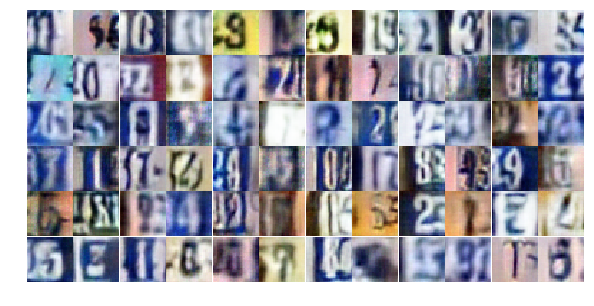

Epoch 15/25... Discriminator Loss: 0.6441... Generator Loss: 1.1065
Epoch 15/25... Discriminator Loss: 0.8251... Generator Loss: 0.7761
Epoch 15/25... Discriminator Loss: 0.2812... Generator Loss: 1.8074
Epoch 15/25... Discriminator Loss: 0.5272... Generator Loss: 1.3464
Epoch 15/25... Discriminator Loss: 0.6976... Generator Loss: 0.9501
Epoch 15/25... Discriminator Loss: 0.9895... Generator Loss: 2.8642
Epoch 15/25... Discriminator Loss: 0.4932... Generator Loss: 1.4933
Epoch 15/25... Discriminator Loss: 0.6865... Generator Loss: 1.0643
Epoch 15/25... Discriminator Loss: 0.6107... Generator Loss: 1.0810
Epoch 15/25... Discriminator Loss: 0.6227... Generator Loss: 1.0882


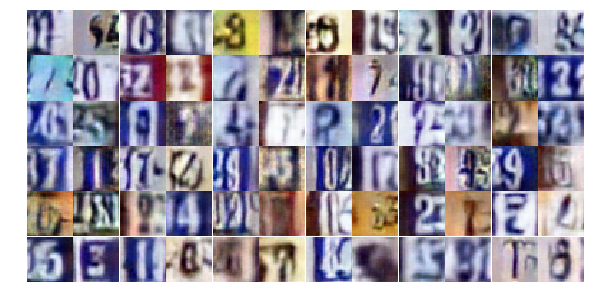

Epoch 15/25... Discriminator Loss: 0.5232... Generator Loss: 1.2348
Epoch 15/25... Discriminator Loss: 1.3172... Generator Loss: 0.4491
Epoch 15/25... Discriminator Loss: 1.0021... Generator Loss: 0.6587
Epoch 15/25... Discriminator Loss: 0.2918... Generator Loss: 2.0040
Epoch 15/25... Discriminator Loss: 0.3921... Generator Loss: 1.4801
Epoch 15/25... Discriminator Loss: 1.6982... Generator Loss: 0.3913
Epoch 15/25... Discriminator Loss: 0.6125... Generator Loss: 2.5736
Epoch 15/25... Discriminator Loss: 0.6924... Generator Loss: 1.6517
Epoch 15/25... Discriminator Loss: 0.6690... Generator Loss: 1.1002
Epoch 15/25... Discriminator Loss: 0.8203... Generator Loss: 0.8105


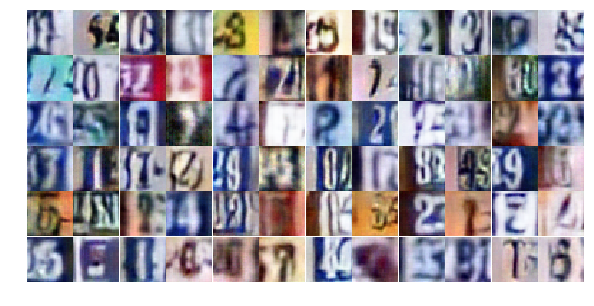

Epoch 15/25... Discriminator Loss: 0.8484... Generator Loss: 0.7549
Epoch 15/25... Discriminator Loss: 0.7374... Generator Loss: 0.9382
Epoch 15/25... Discriminator Loss: 0.3613... Generator Loss: 1.9864
Epoch 15/25... Discriminator Loss: 1.2805... Generator Loss: 0.4650
Epoch 15/25... Discriminator Loss: 1.3786... Generator Loss: 0.5301
Epoch 15/25... Discriminator Loss: 0.8920... Generator Loss: 0.8126
Epoch 15/25... Discriminator Loss: 1.0692... Generator Loss: 0.6908
Epoch 15/25... Discriminator Loss: 0.7209... Generator Loss: 1.0422
Epoch 15/25... Discriminator Loss: 1.5647... Generator Loss: 0.3575
Epoch 16/25... Discriminator Loss: 0.9948... Generator Loss: 0.6581


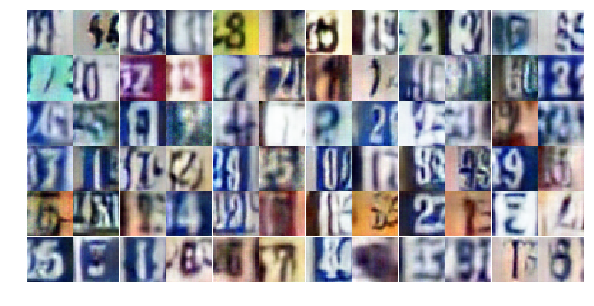

Epoch 16/25... Discriminator Loss: 0.6365... Generator Loss: 1.1591
Epoch 16/25... Discriminator Loss: 0.6643... Generator Loss: 1.1745
Epoch 16/25... Discriminator Loss: 1.2411... Generator Loss: 0.5558
Epoch 16/25... Discriminator Loss: 0.7312... Generator Loss: 1.6036
Epoch 16/25... Discriminator Loss: 0.4450... Generator Loss: 2.2255
Epoch 16/25... Discriminator Loss: 1.3615... Generator Loss: 3.3668
Epoch 16/25... Discriminator Loss: 1.4852... Generator Loss: 0.3977
Epoch 16/25... Discriminator Loss: 0.5983... Generator Loss: 1.2165
Epoch 16/25... Discriminator Loss: 0.4616... Generator Loss: 1.4030
Epoch 16/25... Discriminator Loss: 0.4472... Generator Loss: 1.4893


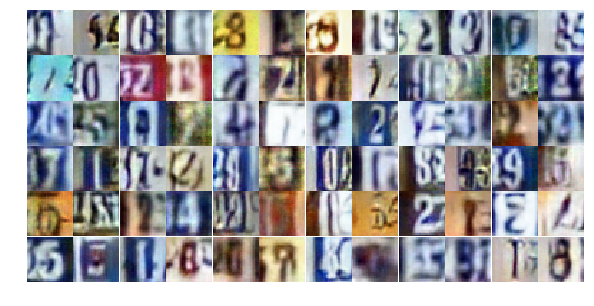

Epoch 16/25... Discriminator Loss: 1.2105... Generator Loss: 0.5141
Epoch 16/25... Discriminator Loss: 0.5917... Generator Loss: 1.2003
Epoch 16/25... Discriminator Loss: 0.6600... Generator Loss: 1.1690
Epoch 16/25... Discriminator Loss: 1.2025... Generator Loss: 0.4860
Epoch 16/25... Discriminator Loss: 0.4901... Generator Loss: 2.1065
Epoch 16/25... Discriminator Loss: 0.7256... Generator Loss: 0.8524
Epoch 16/25... Discriminator Loss: 0.9882... Generator Loss: 0.6921
Epoch 16/25... Discriminator Loss: 0.4839... Generator Loss: 1.6704
Epoch 16/25... Discriminator Loss: 0.4887... Generator Loss: 1.4486
Epoch 16/25... Discriminator Loss: 0.6016... Generator Loss: 1.0462


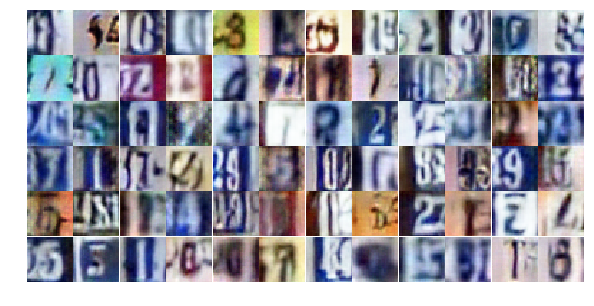

Epoch 16/25... Discriminator Loss: 0.6004... Generator Loss: 1.1521
Epoch 16/25... Discriminator Loss: 1.2473... Generator Loss: 4.0261
Epoch 16/25... Discriminator Loss: 0.6488... Generator Loss: 1.2235
Epoch 16/25... Discriminator Loss: 1.1169... Generator Loss: 0.5543
Epoch 16/25... Discriminator Loss: 0.6364... Generator Loss: 1.5736
Epoch 16/25... Discriminator Loss: 0.8377... Generator Loss: 0.8493
Epoch 16/25... Discriminator Loss: 0.8185... Generator Loss: 0.7930
Epoch 16/25... Discriminator Loss: 0.5683... Generator Loss: 1.3227
Epoch 16/25... Discriminator Loss: 0.8083... Generator Loss: 1.1074
Epoch 16/25... Discriminator Loss: 0.6734... Generator Loss: 1.0242


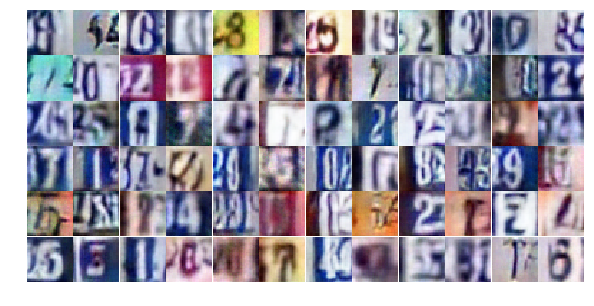

Epoch 16/25... Discriminator Loss: 0.7513... Generator Loss: 0.8567
Epoch 16/25... Discriminator Loss: 0.5554... Generator Loss: 1.1735
Epoch 16/25... Discriminator Loss: 0.7536... Generator Loss: 1.5318
Epoch 16/25... Discriminator Loss: 0.4914... Generator Loss: 1.6927
Epoch 16/25... Discriminator Loss: 0.7831... Generator Loss: 1.3859
Epoch 16/25... Discriminator Loss: 0.8470... Generator Loss: 0.7530
Epoch 16/25... Discriminator Loss: 1.0398... Generator Loss: 0.5848
Epoch 16/25... Discriminator Loss: 1.1940... Generator Loss: 0.4799
Epoch 16/25... Discriminator Loss: 0.7705... Generator Loss: 0.9179
Epoch 16/25... Discriminator Loss: 0.3524... Generator Loss: 1.9065


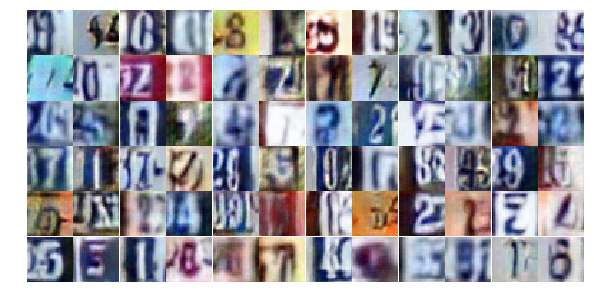

Epoch 16/25... Discriminator Loss: 0.5674... Generator Loss: 1.3255
Epoch 16/25... Discriminator Loss: 0.6674... Generator Loss: 1.9819
Epoch 16/25... Discriminator Loss: 0.8807... Generator Loss: 0.7848
Epoch 16/25... Discriminator Loss: 1.5355... Generator Loss: 0.3679
Epoch 16/25... Discriminator Loss: 0.5789... Generator Loss: 1.1316
Epoch 16/25... Discriminator Loss: 0.9117... Generator Loss: 0.7669
Epoch 16/25... Discriminator Loss: 0.4508... Generator Loss: 1.4593
Epoch 16/25... Discriminator Loss: 0.6488... Generator Loss: 1.3167
Epoch 16/25... Discriminator Loss: 0.4129... Generator Loss: 1.4651
Epoch 16/25... Discriminator Loss: 0.7348... Generator Loss: 1.0109


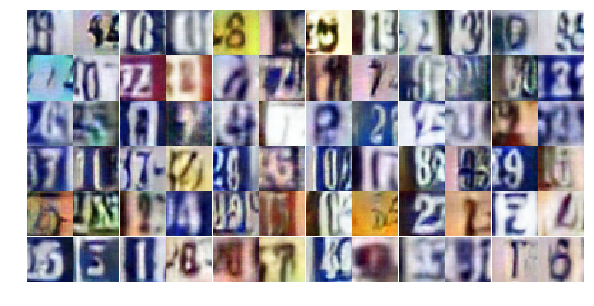

Epoch 16/25... Discriminator Loss: 1.4395... Generator Loss: 0.3720
Epoch 16/25... Discriminator Loss: 0.8898... Generator Loss: 0.7282
Epoch 16/25... Discriminator Loss: 1.4113... Generator Loss: 0.4763
Epoch 16/25... Discriminator Loss: 0.5145... Generator Loss: 2.5548
Epoch 16/25... Discriminator Loss: 0.4947... Generator Loss: 1.2651
Epoch 16/25... Discriminator Loss: 0.5507... Generator Loss: 1.2187
Epoch 17/25... Discriminator Loss: 0.6432... Generator Loss: 2.4969
Epoch 17/25... Discriminator Loss: 1.1101... Generator Loss: 0.5969
Epoch 17/25... Discriminator Loss: 0.5252... Generator Loss: 1.2257
Epoch 17/25... Discriminator Loss: 0.8492... Generator Loss: 0.8419


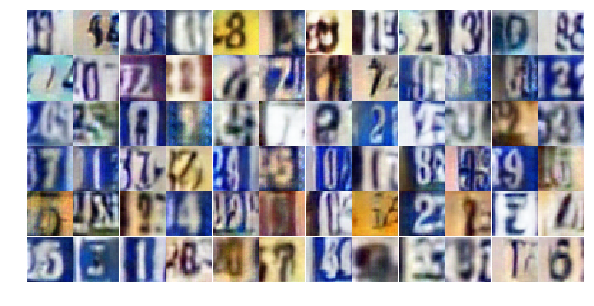

Epoch 17/25... Discriminator Loss: 0.5191... Generator Loss: 1.5160
Epoch 17/25... Discriminator Loss: 0.6771... Generator Loss: 0.9808
Epoch 17/25... Discriminator Loss: 1.1545... Generator Loss: 0.5553
Epoch 17/25... Discriminator Loss: 0.8000... Generator Loss: 0.8386
Epoch 17/25... Discriminator Loss: 1.0499... Generator Loss: 0.6512
Epoch 17/25... Discriminator Loss: 0.9655... Generator Loss: 0.6714
Epoch 17/25... Discriminator Loss: 0.6160... Generator Loss: 1.2862
Epoch 17/25... Discriminator Loss: 0.4251... Generator Loss: 1.4705
Epoch 17/25... Discriminator Loss: 0.3502... Generator Loss: 2.2779
Epoch 17/25... Discriminator Loss: 0.4771... Generator Loss: 1.5227


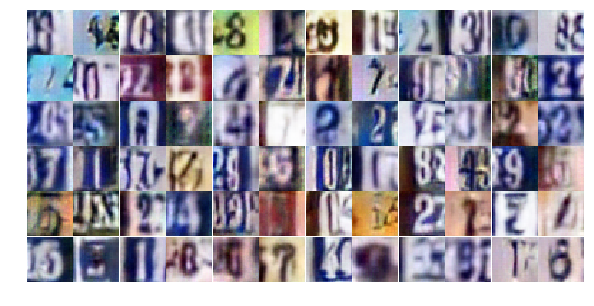

Epoch 17/25... Discriminator Loss: 0.7417... Generator Loss: 1.5094
Epoch 17/25... Discriminator Loss: 0.6723... Generator Loss: 1.0605
Epoch 17/25... Discriminator Loss: 0.4677... Generator Loss: 1.4125
Epoch 17/25... Discriminator Loss: 1.3839... Generator Loss: 0.4721
Epoch 17/25... Discriminator Loss: 0.6411... Generator Loss: 1.2001
Epoch 17/25... Discriminator Loss: 0.8332... Generator Loss: 0.8496
Epoch 17/25... Discriminator Loss: 0.4666... Generator Loss: 1.6171
Epoch 17/25... Discriminator Loss: 0.9337... Generator Loss: 0.7234
Epoch 17/25... Discriminator Loss: 0.6909... Generator Loss: 0.9160
Epoch 17/25... Discriminator Loss: 0.5137... Generator Loss: 1.2587


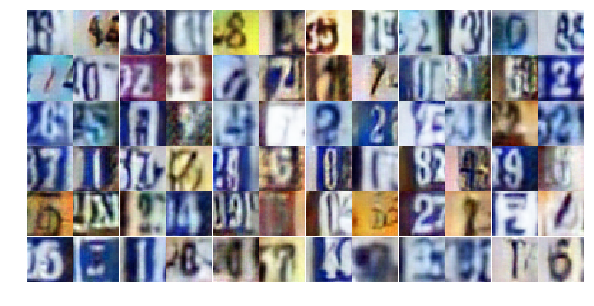

Epoch 17/25... Discriminator Loss: 1.9359... Generator Loss: 0.2641
Epoch 17/25... Discriminator Loss: 0.6872... Generator Loss: 1.2930
Epoch 17/25... Discriminator Loss: 0.4125... Generator Loss: 1.7947
Epoch 17/25... Discriminator Loss: 0.8872... Generator Loss: 0.7382
Epoch 17/25... Discriminator Loss: 1.2869... Generator Loss: 0.4536
Epoch 17/25... Discriminator Loss: 0.4054... Generator Loss: 1.5740
Epoch 17/25... Discriminator Loss: 0.5830... Generator Loss: 1.2891
Epoch 17/25... Discriminator Loss: 0.8907... Generator Loss: 0.7988
Epoch 17/25... Discriminator Loss: 0.9280... Generator Loss: 0.7399
Epoch 17/25... Discriminator Loss: 0.5492... Generator Loss: 1.2626


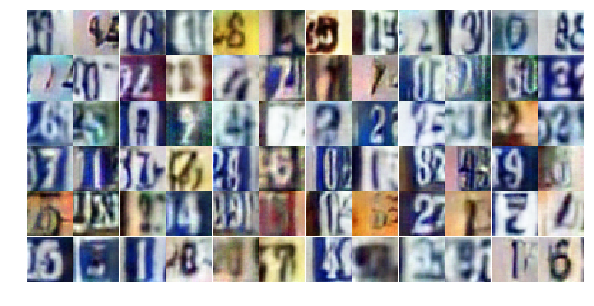

Epoch 17/25... Discriminator Loss: 0.5978... Generator Loss: 1.2571
Epoch 17/25... Discriminator Loss: 1.0176... Generator Loss: 0.9888
Epoch 17/25... Discriminator Loss: 0.4634... Generator Loss: 2.1228
Epoch 17/25... Discriminator Loss: 1.1023... Generator Loss: 0.6134
Epoch 17/25... Discriminator Loss: 1.1282... Generator Loss: 0.5553
Epoch 17/25... Discriminator Loss: 0.6954... Generator Loss: 2.3384
Epoch 17/25... Discriminator Loss: 0.7110... Generator Loss: 1.1133
Epoch 17/25... Discriminator Loss: 0.4722... Generator Loss: 1.6098
Epoch 17/25... Discriminator Loss: 0.4527... Generator Loss: 1.3664
Epoch 17/25... Discriminator Loss: 0.8739... Generator Loss: 0.7738


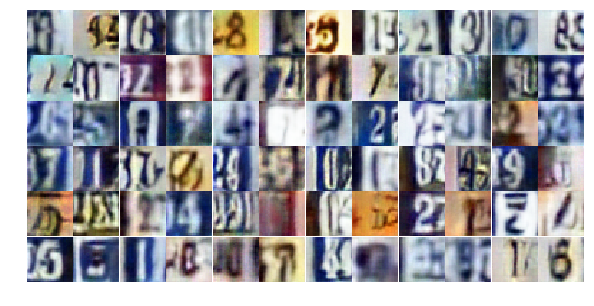

Epoch 17/25... Discriminator Loss: 3.3101... Generator Loss: 1.8989
Epoch 17/25... Discriminator Loss: 0.9557... Generator Loss: 4.7136
Epoch 17/25... Discriminator Loss: 1.8741... Generator Loss: 0.3211
Epoch 17/25... Discriminator Loss: 0.5391... Generator Loss: 1.2860
Epoch 17/25... Discriminator Loss: 0.8647... Generator Loss: 0.8454
Epoch 17/25... Discriminator Loss: 0.8579... Generator Loss: 0.8842
Epoch 17/25... Discriminator Loss: 1.2502... Generator Loss: 0.4670
Epoch 17/25... Discriminator Loss: 0.6902... Generator Loss: 1.0103
Epoch 17/25... Discriminator Loss: 0.7825... Generator Loss: 0.9666
Epoch 17/25... Discriminator Loss: 1.3630... Generator Loss: 0.4232


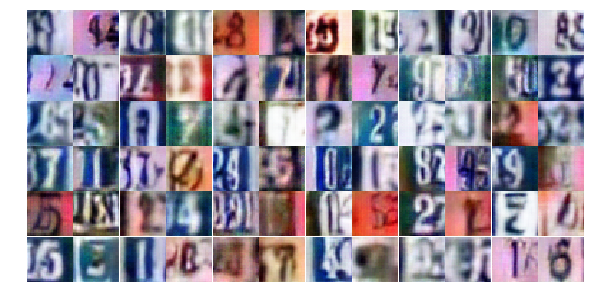

Epoch 17/25... Discriminator Loss: 0.9846... Generator Loss: 0.6679
Epoch 17/25... Discriminator Loss: 0.7417... Generator Loss: 1.6159
Epoch 17/25... Discriminator Loss: 0.5301... Generator Loss: 1.3934
Epoch 17/25... Discriminator Loss: 0.6544... Generator Loss: 1.0689
Epoch 18/25... Discriminator Loss: 1.2260... Generator Loss: 0.4345
Epoch 18/25... Discriminator Loss: 0.9803... Generator Loss: 0.6426
Epoch 18/25... Discriminator Loss: 0.9523... Generator Loss: 0.6659
Epoch 18/25... Discriminator Loss: 0.6660... Generator Loss: 0.9420
Epoch 18/25... Discriminator Loss: 1.2529... Generator Loss: 0.4926
Epoch 18/25... Discriminator Loss: 0.5673... Generator Loss: 1.2777


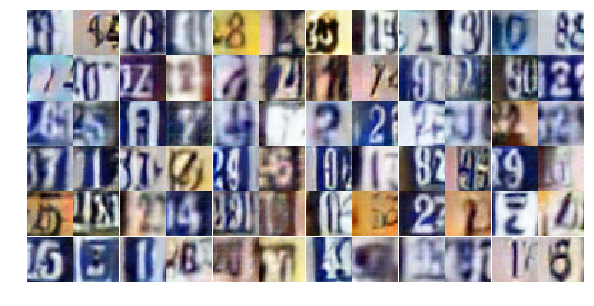

Epoch 18/25... Discriminator Loss: 0.3985... Generator Loss: 1.6919
Epoch 18/25... Discriminator Loss: 0.8707... Generator Loss: 0.7888
Epoch 18/25... Discriminator Loss: 0.6241... Generator Loss: 1.0685
Epoch 18/25... Discriminator Loss: 0.3604... Generator Loss: 1.9358
Epoch 18/25... Discriminator Loss: 0.5499... Generator Loss: 1.2840
Epoch 18/25... Discriminator Loss: 0.7083... Generator Loss: 1.1466
Epoch 18/25... Discriminator Loss: 0.4580... Generator Loss: 1.5329
Epoch 18/25... Discriminator Loss: 1.0976... Generator Loss: 0.7311
Epoch 18/25... Discriminator Loss: 0.6513... Generator Loss: 1.3703
Epoch 18/25... Discriminator Loss: 0.3984... Generator Loss: 2.0666


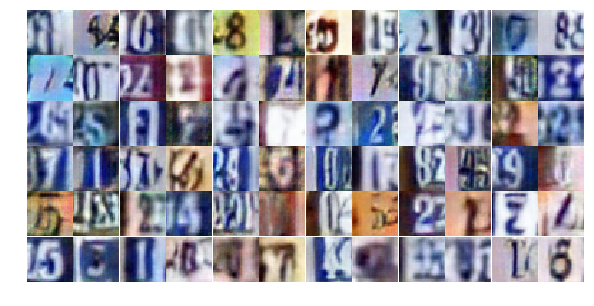

Epoch 18/25... Discriminator Loss: 0.5063... Generator Loss: 1.5146
Epoch 18/25... Discriminator Loss: 0.7158... Generator Loss: 0.9770
Epoch 18/25... Discriminator Loss: 1.0807... Generator Loss: 0.7442
Epoch 18/25... Discriminator Loss: 0.4605... Generator Loss: 1.5240
Epoch 18/25... Discriminator Loss: 0.8348... Generator Loss: 0.8649
Epoch 18/25... Discriminator Loss: 0.6480... Generator Loss: 1.3393
Epoch 18/25... Discriminator Loss: 0.7704... Generator Loss: 1.1320
Epoch 18/25... Discriminator Loss: 1.0226... Generator Loss: 0.6906
Epoch 18/25... Discriminator Loss: 0.6301... Generator Loss: 1.1387
Epoch 18/25... Discriminator Loss: 0.5578... Generator Loss: 1.1035


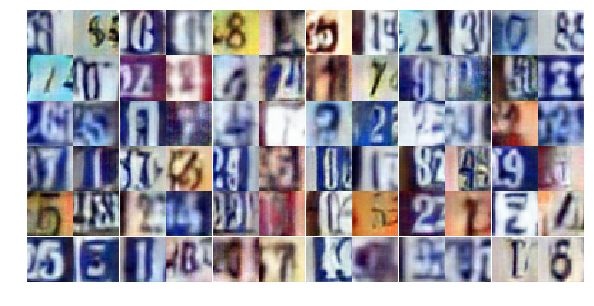

Epoch 18/25... Discriminator Loss: 0.3895... Generator Loss: 1.5327
Epoch 18/25... Discriminator Loss: 0.5372... Generator Loss: 1.4666
Epoch 18/25... Discriminator Loss: 1.6261... Generator Loss: 2.1453
Epoch 18/25... Discriminator Loss: 0.6816... Generator Loss: 1.3756
Epoch 18/25... Discriminator Loss: 0.9929... Generator Loss: 0.6399
Epoch 18/25... Discriminator Loss: 0.8437... Generator Loss: 0.7845
Epoch 18/25... Discriminator Loss: 0.7117... Generator Loss: 1.2207
Epoch 18/25... Discriminator Loss: 0.4521... Generator Loss: 1.9671
Epoch 18/25... Discriminator Loss: 0.8705... Generator Loss: 0.7970
Epoch 18/25... Discriminator Loss: 0.7305... Generator Loss: 1.0130


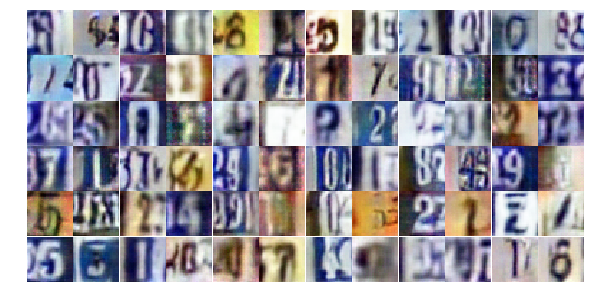

Epoch 18/25... Discriminator Loss: 0.5440... Generator Loss: 1.3635
Epoch 18/25... Discriminator Loss: 0.6992... Generator Loss: 1.0153
Epoch 18/25... Discriminator Loss: 0.5880... Generator Loss: 1.1223
Epoch 18/25... Discriminator Loss: 0.6089... Generator Loss: 1.0918
Epoch 18/25... Discriminator Loss: 0.7254... Generator Loss: 0.9655
Epoch 18/25... Discriminator Loss: 0.5222... Generator Loss: 1.1620
Epoch 18/25... Discriminator Loss: 0.9220... Generator Loss: 0.7309
Epoch 18/25... Discriminator Loss: 1.0742... Generator Loss: 2.5212
Epoch 18/25... Discriminator Loss: 0.6783... Generator Loss: 1.0402
Epoch 18/25... Discriminator Loss: 0.3668... Generator Loss: 2.1025


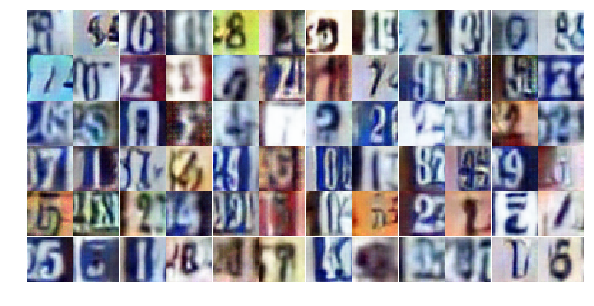

Epoch 18/25... Discriminator Loss: 0.6580... Generator Loss: 1.0482
Epoch 18/25... Discriminator Loss: 0.6792... Generator Loss: 1.0224
Epoch 18/25... Discriminator Loss: 0.8077... Generator Loss: 0.8321
Epoch 18/25... Discriminator Loss: 0.9852... Generator Loss: 2.0435
Epoch 18/25... Discriminator Loss: 0.6968... Generator Loss: 1.0921
Epoch 18/25... Discriminator Loss: 0.7268... Generator Loss: 0.9433
Epoch 18/25... Discriminator Loss: 0.6163... Generator Loss: 1.0232
Epoch 18/25... Discriminator Loss: 1.7001... Generator Loss: 0.3379
Epoch 18/25... Discriminator Loss: 1.2931... Generator Loss: 0.4810
Epoch 18/25... Discriminator Loss: 1.2016... Generator Loss: 0.5214


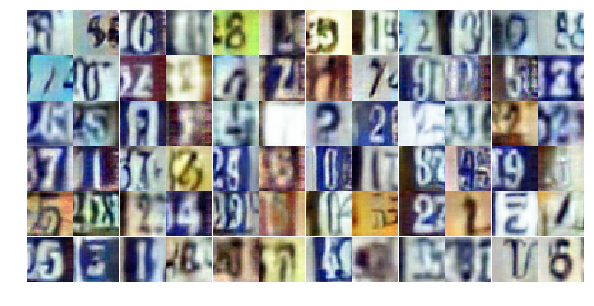

Epoch 18/25... Discriminator Loss: 0.6841... Generator Loss: 1.6198
Epoch 19/25... Discriminator Loss: 1.1824... Generator Loss: 0.5161
Epoch 19/25... Discriminator Loss: 0.9621... Generator Loss: 0.7210
Epoch 19/25... Discriminator Loss: 0.8489... Generator Loss: 0.8403
Epoch 19/25... Discriminator Loss: 0.5870... Generator Loss: 1.1818
Epoch 19/25... Discriminator Loss: 1.0001... Generator Loss: 0.6803
Epoch 19/25... Discriminator Loss: 0.6236... Generator Loss: 1.2214
Epoch 19/25... Discriminator Loss: 1.0960... Generator Loss: 2.0698
Epoch 19/25... Discriminator Loss: 0.7483... Generator Loss: 0.8808
Epoch 19/25... Discriminator Loss: 0.9101... Generator Loss: 0.7504


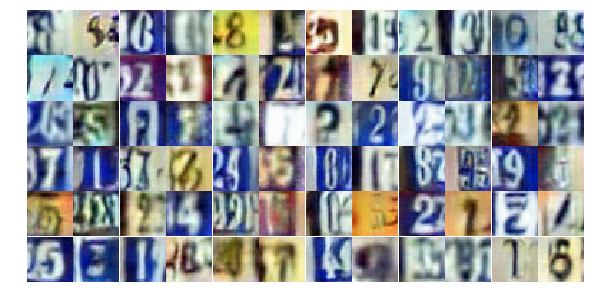

Epoch 19/25... Discriminator Loss: 0.4774... Generator Loss: 1.2875
Epoch 19/25... Discriminator Loss: 0.9172... Generator Loss: 0.7256
Epoch 19/25... Discriminator Loss: 0.7665... Generator Loss: 2.3052
Epoch 19/25... Discriminator Loss: 0.8830... Generator Loss: 0.7816
Epoch 19/25... Discriminator Loss: 0.8603... Generator Loss: 0.7987
Epoch 19/25... Discriminator Loss: 0.6316... Generator Loss: 1.1111
Epoch 19/25... Discriminator Loss: 0.8034... Generator Loss: 0.8542
Epoch 19/25... Discriminator Loss: 0.6489... Generator Loss: 1.1770
Epoch 19/25... Discriminator Loss: 0.8107... Generator Loss: 2.4329
Epoch 19/25... Discriminator Loss: 1.1180... Generator Loss: 0.6229


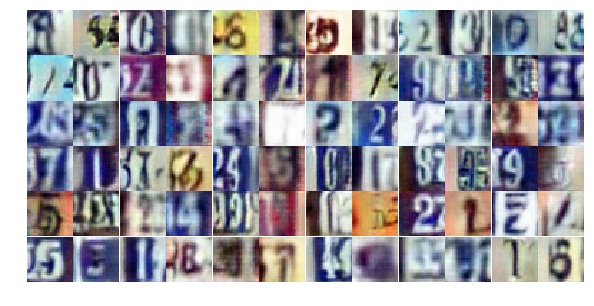

Epoch 19/25... Discriminator Loss: 0.7709... Generator Loss: 0.8935
Epoch 19/25... Discriminator Loss: 1.0374... Generator Loss: 0.6753
Epoch 19/25... Discriminator Loss: 1.3181... Generator Loss: 0.5653
Epoch 19/25... Discriminator Loss: 0.6475... Generator Loss: 1.3306
Epoch 19/25... Discriminator Loss: 1.0210... Generator Loss: 0.6505
Epoch 19/25... Discriminator Loss: 0.6283... Generator Loss: 1.7633
Epoch 19/25... Discriminator Loss: 0.8988... Generator Loss: 0.7954
Epoch 19/25... Discriminator Loss: 0.5454... Generator Loss: 1.3260
Epoch 19/25... Discriminator Loss: 0.6054... Generator Loss: 1.1649
Epoch 19/25... Discriminator Loss: 1.0327... Generator Loss: 0.6378


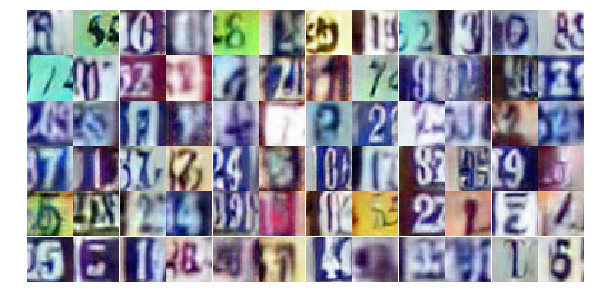

Epoch 19/25... Discriminator Loss: 1.1124... Generator Loss: 0.5740
Epoch 19/25... Discriminator Loss: 0.6232... Generator Loss: 1.1927
Epoch 19/25... Discriminator Loss: 1.0303... Generator Loss: 0.6202
Epoch 19/25... Discriminator Loss: 0.6198... Generator Loss: 1.1555
Epoch 19/25... Discriminator Loss: 0.6361... Generator Loss: 1.0503
Epoch 19/25... Discriminator Loss: 1.0503... Generator Loss: 0.5792
Epoch 19/25... Discriminator Loss: 0.7208... Generator Loss: 1.1547
Epoch 19/25... Discriminator Loss: 0.4175... Generator Loss: 1.7902
Epoch 19/25... Discriminator Loss: 0.9096... Generator Loss: 0.7570
Epoch 19/25... Discriminator Loss: 0.5733... Generator Loss: 1.1618


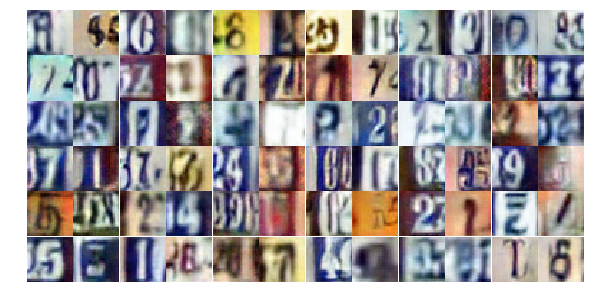

Epoch 19/25... Discriminator Loss: 0.7161... Generator Loss: 0.9869
Epoch 19/25... Discriminator Loss: 0.8797... Generator Loss: 0.8799
Epoch 19/25... Discriminator Loss: 0.8380... Generator Loss: 0.7340
Epoch 19/25... Discriminator Loss: 0.6359... Generator Loss: 1.0019
Epoch 19/25... Discriminator Loss: 0.6894... Generator Loss: 1.0163
Epoch 19/25... Discriminator Loss: 0.5006... Generator Loss: 1.3586
Epoch 19/25... Discriminator Loss: 0.6770... Generator Loss: 0.9670
Epoch 19/25... Discriminator Loss: 0.3389... Generator Loss: 3.6636
Epoch 19/25... Discriminator Loss: 0.6667... Generator Loss: 1.1631
Epoch 19/25... Discriminator Loss: 0.7416... Generator Loss: 1.4140


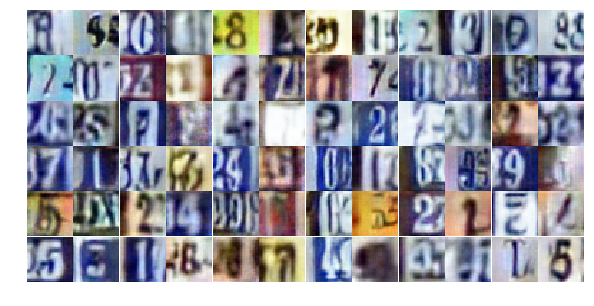

Epoch 19/25... Discriminator Loss: 0.9416... Generator Loss: 0.7134
Epoch 19/25... Discriminator Loss: 0.9805... Generator Loss: 0.6688
Epoch 19/25... Discriminator Loss: 0.7257... Generator Loss: 2.2163
Epoch 19/25... Discriminator Loss: 0.7671... Generator Loss: 1.1239
Epoch 19/25... Discriminator Loss: 0.7811... Generator Loss: 1.0422
Epoch 19/25... Discriminator Loss: 0.5230... Generator Loss: 1.5285
Epoch 19/25... Discriminator Loss: 2.1069... Generator Loss: 0.2513
Epoch 19/25... Discriminator Loss: 0.6223... Generator Loss: 1.2605
Epoch 20/25... Discriminator Loss: 1.0089... Generator Loss: 0.7010
Epoch 20/25... Discriminator Loss: 0.7471... Generator Loss: 0.9566


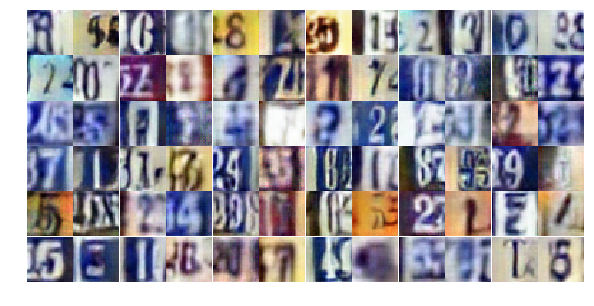

Epoch 20/25... Discriminator Loss: 0.6582... Generator Loss: 1.1084
Epoch 20/25... Discriminator Loss: 0.9411... Generator Loss: 0.7517
Epoch 20/25... Discriminator Loss: 1.5364... Generator Loss: 0.3914
Epoch 20/25... Discriminator Loss: 0.8831... Generator Loss: 0.8014
Epoch 20/25... Discriminator Loss: 0.4929... Generator Loss: 1.3652
Epoch 20/25... Discriminator Loss: 1.1174... Generator Loss: 0.5627
Epoch 20/25... Discriminator Loss: 0.5726... Generator Loss: 1.3934
Epoch 20/25... Discriminator Loss: 0.5377... Generator Loss: 1.3544
Epoch 20/25... Discriminator Loss: 1.0091... Generator Loss: 0.6641
Epoch 20/25... Discriminator Loss: 0.5315... Generator Loss: 1.1938


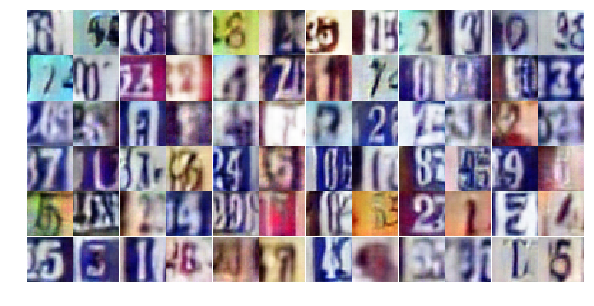

Epoch 20/25... Discriminator Loss: 1.2776... Generator Loss: 0.5613
Epoch 20/25... Discriminator Loss: 1.2906... Generator Loss: 0.5452
Epoch 20/25... Discriminator Loss: 0.8943... Generator Loss: 2.4523
Epoch 20/25... Discriminator Loss: 1.1024... Generator Loss: 0.5942
Epoch 20/25... Discriminator Loss: 0.7897... Generator Loss: 0.9193
Epoch 20/25... Discriminator Loss: 0.9860... Generator Loss: 0.7085
Epoch 20/25... Discriminator Loss: 1.0439... Generator Loss: 0.6205
Epoch 20/25... Discriminator Loss: 0.6838... Generator Loss: 1.0660
Epoch 20/25... Discriminator Loss: 0.7068... Generator Loss: 1.0108
Epoch 20/25... Discriminator Loss: 0.9464... Generator Loss: 0.7227


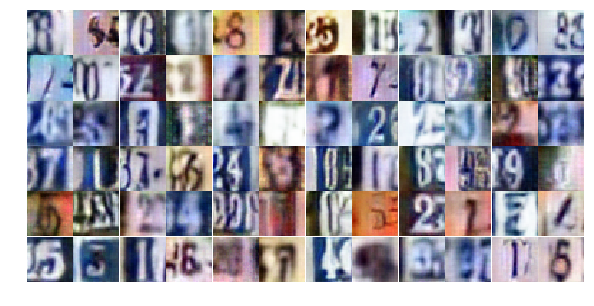

Epoch 20/25... Discriminator Loss: 0.6008... Generator Loss: 1.2155
Epoch 20/25... Discriminator Loss: 0.9412... Generator Loss: 0.7813
Epoch 20/25... Discriminator Loss: 0.3702... Generator Loss: 1.7865
Epoch 20/25... Discriminator Loss: 1.5860... Generator Loss: 0.3123
Epoch 20/25... Discriminator Loss: 1.1294... Generator Loss: 0.5684
Epoch 20/25... Discriminator Loss: 0.3957... Generator Loss: 1.9247
Epoch 20/25... Discriminator Loss: 0.5920... Generator Loss: 1.6424
Epoch 20/25... Discriminator Loss: 2.0499... Generator Loss: 0.1915
Epoch 20/25... Discriminator Loss: 0.9927... Generator Loss: 0.6866
Epoch 20/25... Discriminator Loss: 0.4120... Generator Loss: 1.4815


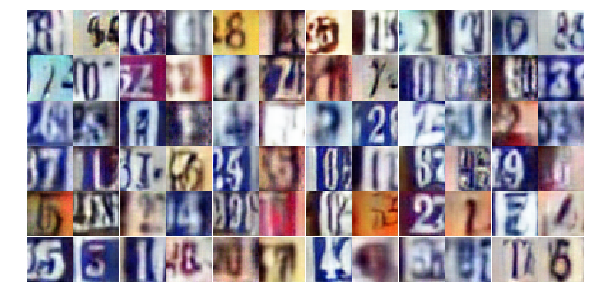

Epoch 20/25... Discriminator Loss: 0.8298... Generator Loss: 0.9473
Epoch 20/25... Discriminator Loss: 0.7622... Generator Loss: 0.9234
Epoch 20/25... Discriminator Loss: 0.4595... Generator Loss: 1.5087
Epoch 20/25... Discriminator Loss: 0.6702... Generator Loss: 1.0752
Epoch 20/25... Discriminator Loss: 0.6635... Generator Loss: 1.0879
Epoch 20/25... Discriminator Loss: 0.7637... Generator Loss: 0.9553
Epoch 20/25... Discriminator Loss: 0.7113... Generator Loss: 1.1382
Epoch 20/25... Discriminator Loss: 0.9416... Generator Loss: 0.7738
Epoch 20/25... Discriminator Loss: 1.0937... Generator Loss: 0.6179
Epoch 20/25... Discriminator Loss: 1.0726... Generator Loss: 0.6705


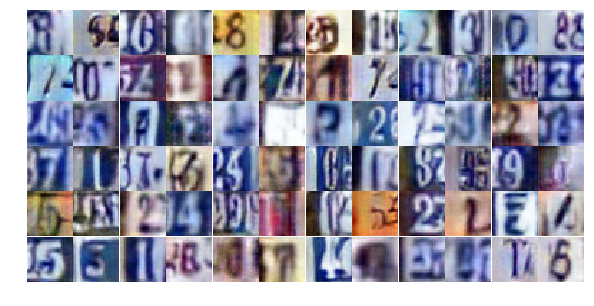

Epoch 20/25... Discriminator Loss: 0.7212... Generator Loss: 1.0249
Epoch 20/25... Discriminator Loss: 1.1153... Generator Loss: 0.5803
Epoch 20/25... Discriminator Loss: 0.4833... Generator Loss: 1.4884
Epoch 20/25... Discriminator Loss: 0.7128... Generator Loss: 1.1321
Epoch 20/25... Discriminator Loss: 0.7985... Generator Loss: 0.9382
Epoch 20/25... Discriminator Loss: 0.9859... Generator Loss: 0.6276
Epoch 20/25... Discriminator Loss: 0.8950... Generator Loss: 0.7625
Epoch 20/25... Discriminator Loss: 0.4476... Generator Loss: 1.6775
Epoch 20/25... Discriminator Loss: 0.7173... Generator Loss: 1.0952
Epoch 20/25... Discriminator Loss: 0.7098... Generator Loss: 1.0501


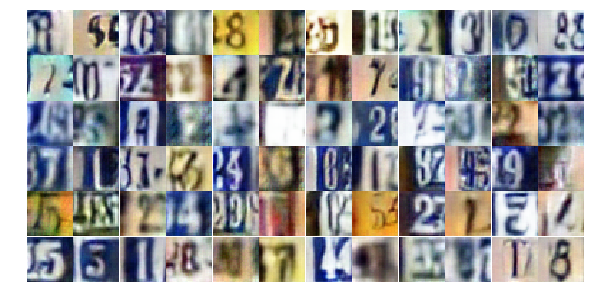

Epoch 20/25... Discriminator Loss: 0.5724... Generator Loss: 1.3821
Epoch 20/25... Discriminator Loss: 0.5449... Generator Loss: 1.7573
Epoch 20/25... Discriminator Loss: 0.4902... Generator Loss: 1.5155
Epoch 20/25... Discriminator Loss: 0.9775... Generator Loss: 0.7153
Epoch 20/25... Discriminator Loss: 0.5981... Generator Loss: 1.1845
Epoch 20/25... Discriminator Loss: 0.4748... Generator Loss: 1.4971
Epoch 21/25... Discriminator Loss: 0.9472... Generator Loss: 0.7213
Epoch 21/25... Discriminator Loss: 0.7592... Generator Loss: 1.0966
Epoch 21/25... Discriminator Loss: 1.4203... Generator Loss: 0.4124
Epoch 21/25... Discriminator Loss: 0.9570... Generator Loss: 0.6808


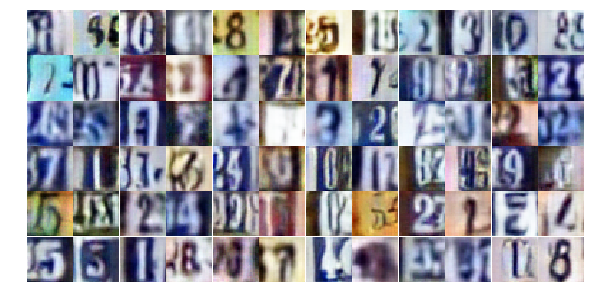

Epoch 21/25... Discriminator Loss: 0.4867... Generator Loss: 2.2100
Epoch 21/25... Discriminator Loss: 1.6291... Generator Loss: 0.3751
Epoch 21/25... Discriminator Loss: 0.7639... Generator Loss: 1.0464
Epoch 21/25... Discriminator Loss: 0.3866... Generator Loss: 1.6730
Epoch 21/25... Discriminator Loss: 0.7914... Generator Loss: 0.8869
Epoch 21/25... Discriminator Loss: 0.5986... Generator Loss: 1.0819
Epoch 21/25... Discriminator Loss: 1.0271... Generator Loss: 0.6088
Epoch 21/25... Discriminator Loss: 1.0704... Generator Loss: 0.6452
Epoch 21/25... Discriminator Loss: 0.7648... Generator Loss: 0.8693
Epoch 21/25... Discriminator Loss: 1.0178... Generator Loss: 0.6494


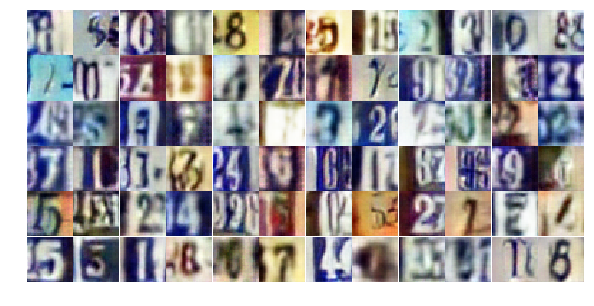

Epoch 21/25... Discriminator Loss: 0.3478... Generator Loss: 1.8246
Epoch 21/25... Discriminator Loss: 1.0538... Generator Loss: 0.6977
Epoch 21/25... Discriminator Loss: 1.8182... Generator Loss: 0.2947
Epoch 21/25... Discriminator Loss: 1.9029... Generator Loss: 0.8093
Epoch 21/25... Discriminator Loss: 0.5077... Generator Loss: 1.9379
Epoch 21/25... Discriminator Loss: 1.7606... Generator Loss: 0.2992
Epoch 21/25... Discriminator Loss: 0.6562... Generator Loss: 1.2898
Epoch 21/25... Discriminator Loss: 0.3922... Generator Loss: 1.4975
Epoch 21/25... Discriminator Loss: 0.4639... Generator Loss: 1.3200
Epoch 21/25... Discriminator Loss: 0.9118... Generator Loss: 0.7508


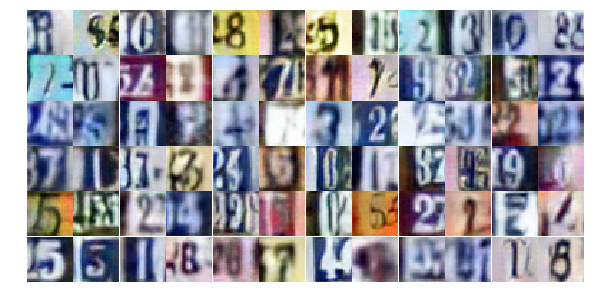

Epoch 21/25... Discriminator Loss: 0.8840... Generator Loss: 0.8477
Epoch 21/25... Discriminator Loss: 0.3967... Generator Loss: 1.6504
Epoch 21/25... Discriminator Loss: 1.1853... Generator Loss: 0.5175
Epoch 21/25... Discriminator Loss: 0.7758... Generator Loss: 0.9717
Epoch 21/25... Discriminator Loss: 0.7652... Generator Loss: 0.9277
Epoch 21/25... Discriminator Loss: 0.8680... Generator Loss: 0.8896
Epoch 21/25... Discriminator Loss: 0.5884... Generator Loss: 1.0965
Epoch 21/25... Discriminator Loss: 0.8369... Generator Loss: 0.8303
Epoch 21/25... Discriminator Loss: 1.2500... Generator Loss: 0.5345
Epoch 21/25... Discriminator Loss: 1.0451... Generator Loss: 0.6793


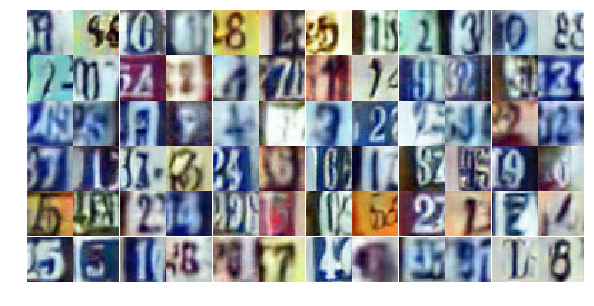

Epoch 21/25... Discriminator Loss: 0.6254... Generator Loss: 1.4467
Epoch 21/25... Discriminator Loss: 0.9403... Generator Loss: 0.7010
Epoch 21/25... Discriminator Loss: 0.7733... Generator Loss: 0.9828
Epoch 21/25... Discriminator Loss: 0.6294... Generator Loss: 1.1579
Epoch 21/25... Discriminator Loss: 0.6301... Generator Loss: 1.0267
Epoch 21/25... Discriminator Loss: 0.7108... Generator Loss: 0.9857
Epoch 21/25... Discriminator Loss: 0.9325... Generator Loss: 0.7821
Epoch 21/25... Discriminator Loss: 1.4034... Generator Loss: 0.3677
Epoch 21/25... Discriminator Loss: 0.5947... Generator Loss: 1.2118
Epoch 21/25... Discriminator Loss: 0.8765... Generator Loss: 0.8632


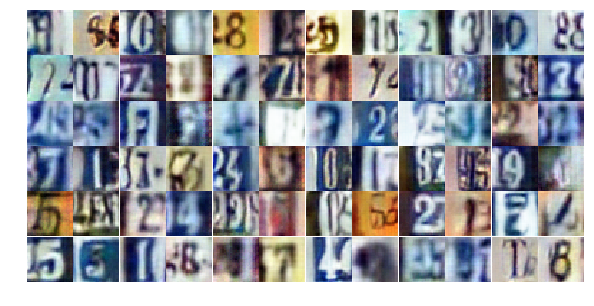

Epoch 21/25... Discriminator Loss: 1.3580... Generator Loss: 3.6784
Epoch 21/25... Discriminator Loss: 1.5187... Generator Loss: 0.3981
Epoch 21/25... Discriminator Loss: 0.5803... Generator Loss: 1.2897
Epoch 21/25... Discriminator Loss: 0.7304... Generator Loss: 0.9486
Epoch 21/25... Discriminator Loss: 0.4351... Generator Loss: 1.7128
Epoch 21/25... Discriminator Loss: 0.6300... Generator Loss: 1.3588
Epoch 21/25... Discriminator Loss: 0.7969... Generator Loss: 0.8851
Epoch 21/25... Discriminator Loss: 1.4223... Generator Loss: 0.4030
Epoch 21/25... Discriminator Loss: 0.7612... Generator Loss: 0.9225
Epoch 21/25... Discriminator Loss: 0.9393... Generator Loss: 0.7071


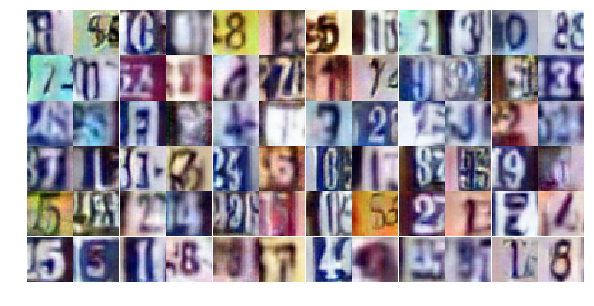

Epoch 21/25... Discriminator Loss: 0.6682... Generator Loss: 1.0469
Epoch 21/25... Discriminator Loss: 0.8390... Generator Loss: 1.0555
Epoch 21/25... Discriminator Loss: 0.6548... Generator Loss: 1.1834
Epoch 22/25... Discriminator Loss: 0.7708... Generator Loss: 0.9919
Epoch 22/25... Discriminator Loss: 0.9649... Generator Loss: 1.2629
Epoch 22/25... Discriminator Loss: 1.3004... Generator Loss: 0.4319
Epoch 22/25... Discriminator Loss: 0.6169... Generator Loss: 1.3514
Epoch 22/25... Discriminator Loss: 0.5227... Generator Loss: 1.2769
Epoch 22/25... Discriminator Loss: 1.1934... Generator Loss: 0.5052
Epoch 22/25... Discriminator Loss: 0.8894... Generator Loss: 0.7587


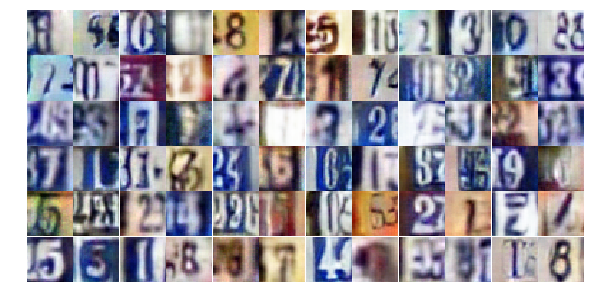

Epoch 22/25... Discriminator Loss: 0.6829... Generator Loss: 1.0971
Epoch 22/25... Discriminator Loss: 0.7105... Generator Loss: 1.1721
Epoch 22/25... Discriminator Loss: 1.8020... Generator Loss: 0.2980
Epoch 22/25... Discriminator Loss: 1.0027... Generator Loss: 0.6341
Epoch 22/25... Discriminator Loss: 0.7696... Generator Loss: 1.0530
Epoch 22/25... Discriminator Loss: 0.7044... Generator Loss: 2.2074
Epoch 22/25... Discriminator Loss: 0.7861... Generator Loss: 0.8502
Epoch 22/25... Discriminator Loss: 0.4582... Generator Loss: 1.5400
Epoch 22/25... Discriminator Loss: 1.4853... Generator Loss: 0.3894
Epoch 22/25... Discriminator Loss: 1.6980... Generator Loss: 0.3738


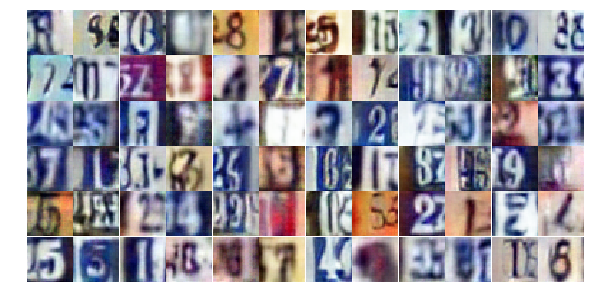

Epoch 22/25... Discriminator Loss: 0.4602... Generator Loss: 1.9276
Epoch 22/25... Discriminator Loss: 0.5272... Generator Loss: 1.6311
Epoch 22/25... Discriminator Loss: 1.0083... Generator Loss: 0.6763
Epoch 22/25... Discriminator Loss: 0.6509... Generator Loss: 1.0647
Epoch 22/25... Discriminator Loss: 0.3458... Generator Loss: 2.0223
Epoch 22/25... Discriminator Loss: 0.9536... Generator Loss: 0.6494
Epoch 22/25... Discriminator Loss: 0.5718... Generator Loss: 1.2579
Epoch 22/25... Discriminator Loss: 0.3489... Generator Loss: 1.6250
Epoch 22/25... Discriminator Loss: 0.4591... Generator Loss: 1.4471
Epoch 22/25... Discriminator Loss: 0.8213... Generator Loss: 0.8802


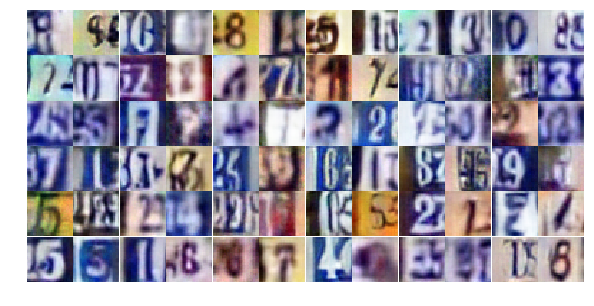

Epoch 22/25... Discriminator Loss: 0.3689... Generator Loss: 1.6810
Epoch 22/25... Discriminator Loss: 0.7302... Generator Loss: 1.0414
Epoch 22/25... Discriminator Loss: 0.8944... Generator Loss: 0.8099
Epoch 22/25... Discriminator Loss: 0.4926... Generator Loss: 1.5523
Epoch 22/25... Discriminator Loss: 0.7691... Generator Loss: 0.9116
Epoch 22/25... Discriminator Loss: 0.8708... Generator Loss: 0.8572
Epoch 22/25... Discriminator Loss: 1.3923... Generator Loss: 0.4259
Epoch 22/25... Discriminator Loss: 1.0366... Generator Loss: 3.1571
Epoch 22/25... Discriminator Loss: 1.3800... Generator Loss: 0.5149
Epoch 22/25... Discriminator Loss: 0.8189... Generator Loss: 0.8603


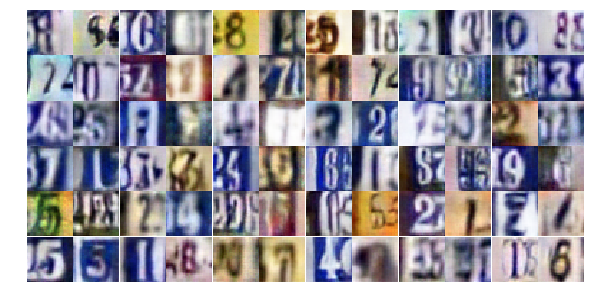

Epoch 22/25... Discriminator Loss: 0.6754... Generator Loss: 1.2364
Epoch 22/25... Discriminator Loss: 0.3990... Generator Loss: 1.7036
Epoch 22/25... Discriminator Loss: 0.4683... Generator Loss: 1.5099
Epoch 22/25... Discriminator Loss: 1.0585... Generator Loss: 0.5615
Epoch 22/25... Discriminator Loss: 0.6831... Generator Loss: 0.9883
Epoch 22/25... Discriminator Loss: 0.7432... Generator Loss: 0.8516
Epoch 22/25... Discriminator Loss: 0.6676... Generator Loss: 1.1554
Epoch 22/25... Discriminator Loss: 0.8069... Generator Loss: 0.8548
Epoch 22/25... Discriminator Loss: 1.3664... Generator Loss: 0.4639
Epoch 22/25... Discriminator Loss: 0.5881... Generator Loss: 1.3208


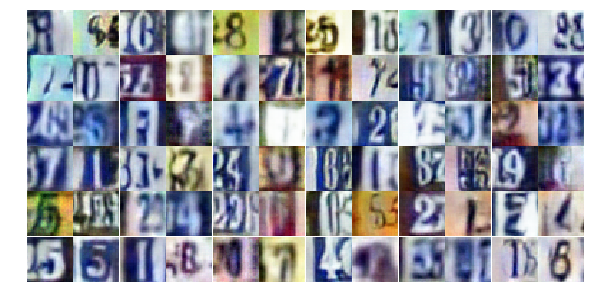

Epoch 22/25... Discriminator Loss: 0.9909... Generator Loss: 0.6580
Epoch 22/25... Discriminator Loss: 0.4942... Generator Loss: 1.5288
Epoch 22/25... Discriminator Loss: 0.8358... Generator Loss: 0.8130
Epoch 22/25... Discriminator Loss: 0.8207... Generator Loss: 0.8842
Epoch 22/25... Discriminator Loss: 1.1676... Generator Loss: 0.6766
Epoch 22/25... Discriminator Loss: 0.8626... Generator Loss: 2.8097
Epoch 22/25... Discriminator Loss: 1.6258... Generator Loss: 0.4401
Epoch 22/25... Discriminator Loss: 0.5419... Generator Loss: 1.2812
Epoch 22/25... Discriminator Loss: 0.7689... Generator Loss: 1.9508
Epoch 22/25... Discriminator Loss: 1.0742... Generator Loss: 0.6517


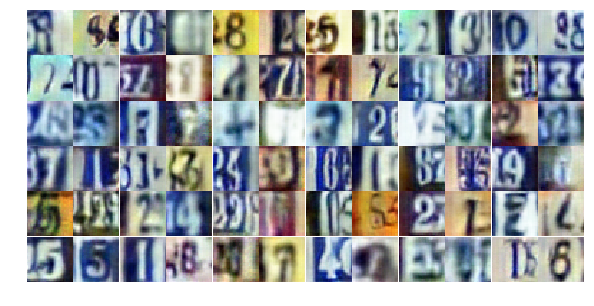

Epoch 23/25... Discriminator Loss: 0.4784... Generator Loss: 1.3907
Epoch 23/25... Discriminator Loss: 0.5413... Generator Loss: 1.1352
Epoch 23/25... Discriminator Loss: 1.1932... Generator Loss: 0.4997
Epoch 23/25... Discriminator Loss: 0.8989... Generator Loss: 0.7556
Epoch 23/25... Discriminator Loss: 0.9957... Generator Loss: 0.6774
Epoch 23/25... Discriminator Loss: 0.9956... Generator Loss: 0.7014
Epoch 23/25... Discriminator Loss: 1.3941... Generator Loss: 0.4717
Epoch 23/25... Discriminator Loss: 0.7960... Generator Loss: 0.8836
Epoch 23/25... Discriminator Loss: 0.6300... Generator Loss: 1.0795
Epoch 23/25... Discriminator Loss: 0.5157... Generator Loss: 1.5194


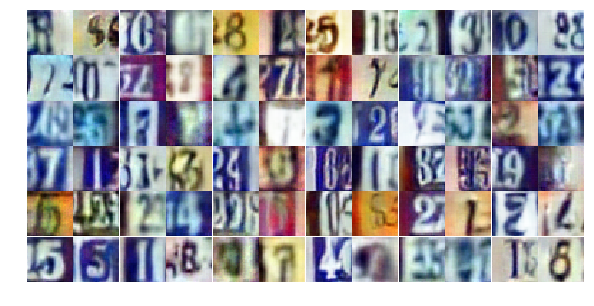

Epoch 23/25... Discriminator Loss: 0.6079... Generator Loss: 1.1295
Epoch 23/25... Discriminator Loss: 0.6275... Generator Loss: 1.1177
Epoch 23/25... Discriminator Loss: 0.5594... Generator Loss: 1.8445
Epoch 23/25... Discriminator Loss: 0.5638... Generator Loss: 1.8611
Epoch 23/25... Discriminator Loss: 0.5250... Generator Loss: 1.8135
Epoch 23/25... Discriminator Loss: 0.9530... Generator Loss: 0.7283
Epoch 23/25... Discriminator Loss: 0.7941... Generator Loss: 0.9381
Epoch 23/25... Discriminator Loss: 0.5470... Generator Loss: 1.7624
Epoch 23/25... Discriminator Loss: 1.1858... Generator Loss: 0.5864
Epoch 23/25... Discriminator Loss: 0.7666... Generator Loss: 0.9563


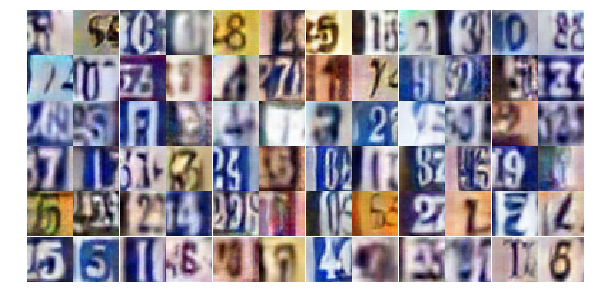

Epoch 23/25... Discriminator Loss: 1.5165... Generator Loss: 0.3726
Epoch 23/25... Discriminator Loss: 0.8006... Generator Loss: 0.8538
Epoch 23/25... Discriminator Loss: 1.5005... Generator Loss: 0.3858
Epoch 23/25... Discriminator Loss: 0.7278... Generator Loss: 1.3693
Epoch 23/25... Discriminator Loss: 0.7532... Generator Loss: 1.5027
Epoch 23/25... Discriminator Loss: 0.7027... Generator Loss: 1.4673
Epoch 23/25... Discriminator Loss: 0.8145... Generator Loss: 0.8552
Epoch 23/25... Discriminator Loss: 0.7304... Generator Loss: 1.0343
Epoch 23/25... Discriminator Loss: 0.6431... Generator Loss: 1.3137
Epoch 23/25... Discriminator Loss: 0.7813... Generator Loss: 1.2616


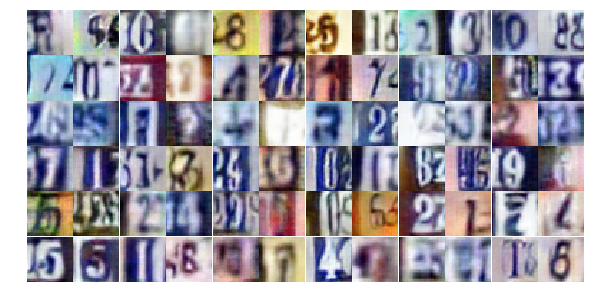

Epoch 23/25... Discriminator Loss: 0.6008... Generator Loss: 1.1391
Epoch 23/25... Discriminator Loss: 0.4313... Generator Loss: 1.7095
Epoch 23/25... Discriminator Loss: 0.8461... Generator Loss: 0.8624
Epoch 23/25... Discriminator Loss: 1.4458... Generator Loss: 0.4393
Epoch 23/25... Discriminator Loss: 0.6211... Generator Loss: 1.4102
Epoch 23/25... Discriminator Loss: 2.3513... Generator Loss: 0.1510
Epoch 23/25... Discriminator Loss: 0.8758... Generator Loss: 0.9051
Epoch 23/25... Discriminator Loss: 0.6393... Generator Loss: 1.1675
Epoch 23/25... Discriminator Loss: 0.4939... Generator Loss: 1.5668
Epoch 23/25... Discriminator Loss: 0.5111... Generator Loss: 1.3523


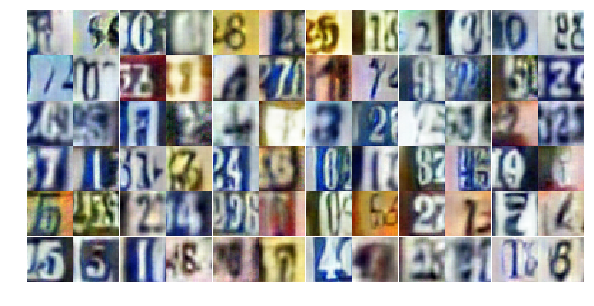

Epoch 23/25... Discriminator Loss: 0.9557... Generator Loss: 0.7350
Epoch 23/25... Discriminator Loss: 0.5028... Generator Loss: 1.3101
Epoch 23/25... Discriminator Loss: 1.1697... Generator Loss: 3.9480
Epoch 23/25... Discriminator Loss: 0.7578... Generator Loss: 2.3340
Epoch 23/25... Discriminator Loss: 0.9084... Generator Loss: 1.3166
Epoch 23/25... Discriminator Loss: 1.0002... Generator Loss: 0.6890
Epoch 23/25... Discriminator Loss: 0.7836... Generator Loss: 0.9895
Epoch 23/25... Discriminator Loss: 0.8636... Generator Loss: 0.9085
Epoch 23/25... Discriminator Loss: 0.7427... Generator Loss: 1.3658
Epoch 23/25... Discriminator Loss: 0.7633... Generator Loss: 0.9918


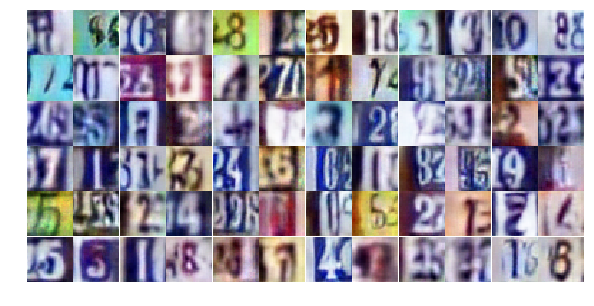

Epoch 23/25... Discriminator Loss: 0.7509... Generator Loss: 0.9302
Epoch 23/25... Discriminator Loss: 1.2202... Generator Loss: 0.5034
Epoch 23/25... Discriminator Loss: 0.6418... Generator Loss: 1.2025
Epoch 23/25... Discriminator Loss: 0.4707... Generator Loss: 1.4796
Epoch 23/25... Discriminator Loss: 1.1407... Generator Loss: 0.6046
Epoch 23/25... Discriminator Loss: 0.6536... Generator Loss: 1.3385
Epoch 23/25... Discriminator Loss: 0.9118... Generator Loss: 0.7148
Epoch 24/25... Discriminator Loss: 0.6187... Generator Loss: 1.1099
Epoch 24/25... Discriminator Loss: 0.8174... Generator Loss: 0.8865
Epoch 24/25... Discriminator Loss: 0.8531... Generator Loss: 1.2363


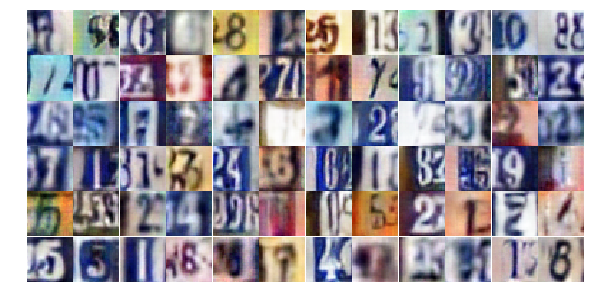

Epoch 24/25... Discriminator Loss: 0.6420... Generator Loss: 1.3346
Epoch 24/25... Discriminator Loss: 0.6734... Generator Loss: 0.9880
Epoch 24/25... Discriminator Loss: 0.7556... Generator Loss: 0.8962
Epoch 24/25... Discriminator Loss: 0.7170... Generator Loss: 1.6335
Epoch 24/25... Discriminator Loss: 0.9096... Generator Loss: 0.7527
Epoch 24/25... Discriminator Loss: 1.0271... Generator Loss: 0.6422
Epoch 24/25... Discriminator Loss: 0.6923... Generator Loss: 1.1428
Epoch 24/25... Discriminator Loss: 1.6399... Generator Loss: 0.4049
Epoch 24/25... Discriminator Loss: 0.5063... Generator Loss: 1.1701
Epoch 24/25... Discriminator Loss: 0.4134... Generator Loss: 1.6719


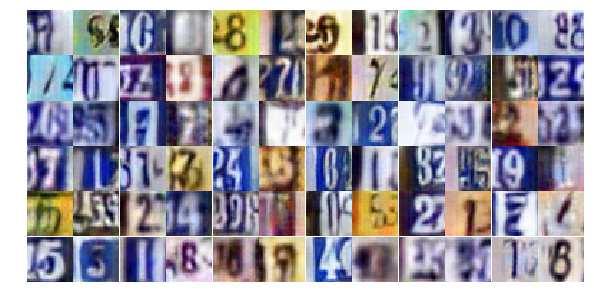

Epoch 24/25... Discriminator Loss: 1.6321... Generator Loss: 0.3085
Epoch 24/25... Discriminator Loss: 1.4310... Generator Loss: 0.4164
Epoch 24/25... Discriminator Loss: 1.3148... Generator Loss: 0.5408
Epoch 24/25... Discriminator Loss: 0.7758... Generator Loss: 0.8321
Epoch 24/25... Discriminator Loss: 0.4187... Generator Loss: 2.0759
Epoch 24/25... Discriminator Loss: 1.4116... Generator Loss: 0.4119
Epoch 24/25... Discriminator Loss: 0.5075... Generator Loss: 1.3053
Epoch 24/25... Discriminator Loss: 1.0507... Generator Loss: 1.3575
Epoch 24/25... Discriminator Loss: 0.8137... Generator Loss: 0.9098
Epoch 24/25... Discriminator Loss: 1.0605... Generator Loss: 0.6513


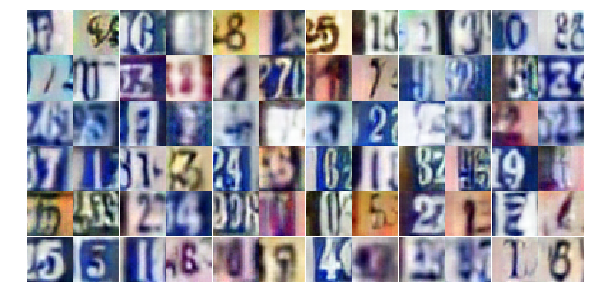

Epoch 24/25... Discriminator Loss: 0.7643... Generator Loss: 0.9225
Epoch 24/25... Discriminator Loss: 0.6919... Generator Loss: 0.9648
Epoch 24/25... Discriminator Loss: 0.5282... Generator Loss: 1.2137
Epoch 24/25... Discriminator Loss: 1.2733... Generator Loss: 0.4645
Epoch 24/25... Discriminator Loss: 0.6779... Generator Loss: 0.9831
Epoch 24/25... Discriminator Loss: 0.5347... Generator Loss: 1.3031
Epoch 24/25... Discriminator Loss: 0.3940... Generator Loss: 1.5930
Epoch 24/25... Discriminator Loss: 0.6801... Generator Loss: 0.9591
Epoch 24/25... Discriminator Loss: 0.7014... Generator Loss: 0.9453
Epoch 24/25... Discriminator Loss: 0.7706... Generator Loss: 0.9405


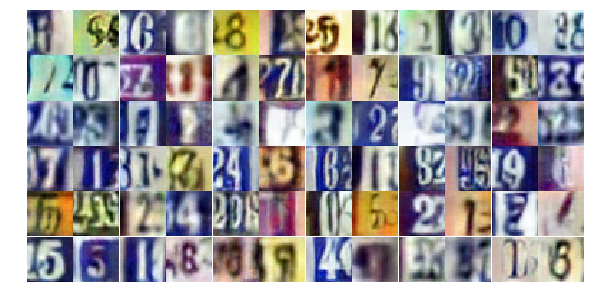

Epoch 24/25... Discriminator Loss: 0.4242... Generator Loss: 1.6265
Epoch 24/25... Discriminator Loss: 0.4380... Generator Loss: 1.5621
Epoch 24/25... Discriminator Loss: 0.7782... Generator Loss: 1.0017
Epoch 24/25... Discriminator Loss: 1.4821... Generator Loss: 0.4338
Epoch 24/25... Discriminator Loss: 0.8507... Generator Loss: 1.2182
Epoch 24/25... Discriminator Loss: 0.5716... Generator Loss: 1.2252
Epoch 24/25... Discriminator Loss: 0.8740... Generator Loss: 0.8481
Epoch 24/25... Discriminator Loss: 0.6033... Generator Loss: 1.4135
Epoch 24/25... Discriminator Loss: 0.7243... Generator Loss: 1.0777
Epoch 24/25... Discriminator Loss: 0.6873... Generator Loss: 1.0544


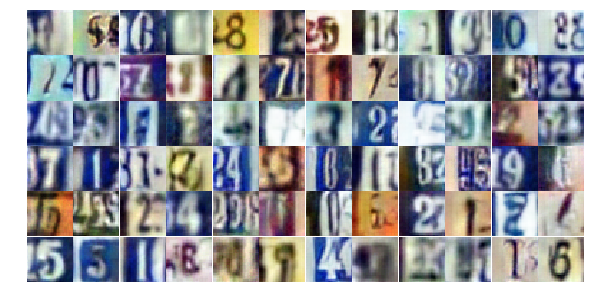

Epoch 24/25... Discriminator Loss: 0.6075... Generator Loss: 1.2393
Epoch 24/25... Discriminator Loss: 0.8228... Generator Loss: 0.8458
Epoch 24/25... Discriminator Loss: 1.5465... Generator Loss: 0.3627
Epoch 24/25... Discriminator Loss: 1.0238... Generator Loss: 1.2136
Epoch 24/25... Discriminator Loss: 1.3605... Generator Loss: 0.3912
Epoch 24/25... Discriminator Loss: 0.6017... Generator Loss: 1.2416
Epoch 24/25... Discriminator Loss: 1.5432... Generator Loss: 0.3483
Epoch 24/25... Discriminator Loss: 0.7332... Generator Loss: 0.9972
Epoch 24/25... Discriminator Loss: 0.9098... Generator Loss: 0.9158
Epoch 24/25... Discriminator Loss: 0.9606... Generator Loss: 1.6316


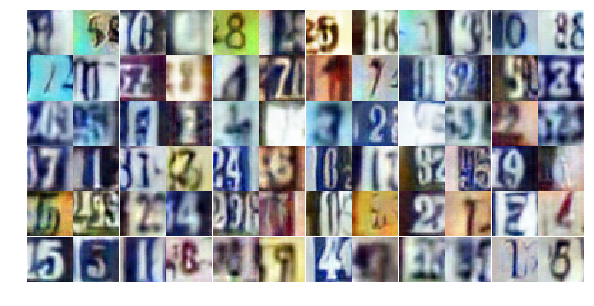

Epoch 24/25... Discriminator Loss: 0.8377... Generator Loss: 0.8966
Epoch 24/25... Discriminator Loss: 1.6523... Generator Loss: 0.3463
Epoch 24/25... Discriminator Loss: 1.1349... Generator Loss: 0.6435
Epoch 24/25... Discriminator Loss: 0.8096... Generator Loss: 0.9108
Epoch 24/25... Discriminator Loss: 1.3049... Generator Loss: 0.4813
Epoch 25/25... Discriminator Loss: 0.6117... Generator Loss: 1.5475
Epoch 25/25... Discriminator Loss: 0.6332... Generator Loss: 1.2346
Epoch 25/25... Discriminator Loss: 0.7669... Generator Loss: 1.0138
Epoch 25/25... Discriminator Loss: 0.8161... Generator Loss: 0.8366
Epoch 25/25... Discriminator Loss: 1.1789... Generator Loss: 0.5365


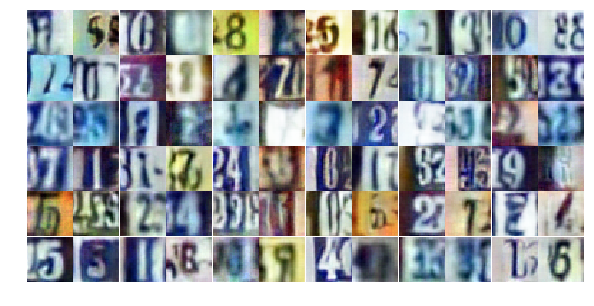

Epoch 25/25... Discriminator Loss: 1.3033... Generator Loss: 0.4234
Epoch 25/25... Discriminator Loss: 1.4470... Generator Loss: 0.5075
Epoch 25/25... Discriminator Loss: 0.7918... Generator Loss: 0.8154
Epoch 25/25... Discriminator Loss: 1.0658... Generator Loss: 0.6634
Epoch 25/25... Discriminator Loss: 1.0433... Generator Loss: 2.2686
Epoch 25/25... Discriminator Loss: 0.8387... Generator Loss: 1.0119
Epoch 25/25... Discriminator Loss: 0.7989... Generator Loss: 0.8751
Epoch 25/25... Discriminator Loss: 0.7527... Generator Loss: 0.9548
Epoch 25/25... Discriminator Loss: 0.3850... Generator Loss: 1.5932
Epoch 25/25... Discriminator Loss: 0.8027... Generator Loss: 0.9058


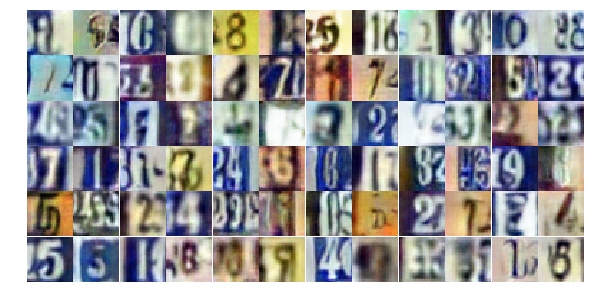

Epoch 25/25... Discriminator Loss: 0.8234... Generator Loss: 0.8170
Epoch 25/25... Discriminator Loss: 0.4955... Generator Loss: 2.2125
Epoch 25/25... Discriminator Loss: 1.2660... Generator Loss: 0.4909
Epoch 25/25... Discriminator Loss: 0.9426... Generator Loss: 0.7610
Epoch 25/25... Discriminator Loss: 0.7300... Generator Loss: 0.9766
Epoch 25/25... Discriminator Loss: 0.6969... Generator Loss: 1.4537
Epoch 25/25... Discriminator Loss: 1.1332... Generator Loss: 0.6370
Epoch 25/25... Discriminator Loss: 0.9646... Generator Loss: 0.7678
Epoch 25/25... Discriminator Loss: 0.4504... Generator Loss: 1.5005
Epoch 25/25... Discriminator Loss: 0.8021... Generator Loss: 0.8329


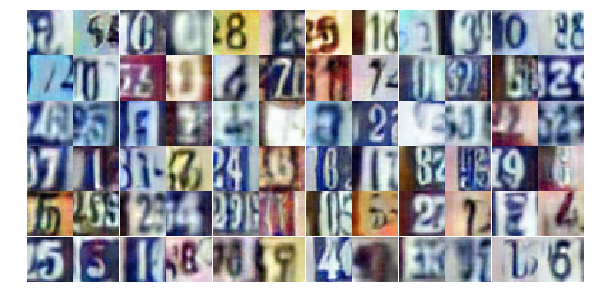

Epoch 25/25... Discriminator Loss: 1.5012... Generator Loss: 0.3588
Epoch 25/25... Discriminator Loss: 0.5237... Generator Loss: 1.3174
Epoch 25/25... Discriminator Loss: 1.1792... Generator Loss: 0.7004
Epoch 25/25... Discriminator Loss: 0.6885... Generator Loss: 1.1171
Epoch 25/25... Discriminator Loss: 1.1801... Generator Loss: 0.5135
Epoch 25/25... Discriminator Loss: 0.6295... Generator Loss: 1.1409
Epoch 25/25... Discriminator Loss: 0.7172... Generator Loss: 1.2051
Epoch 25/25... Discriminator Loss: 1.1075... Generator Loss: 0.5939
Epoch 25/25... Discriminator Loss: 0.7888... Generator Loss: 1.1431
Epoch 25/25... Discriminator Loss: 0.4612... Generator Loss: 1.7634


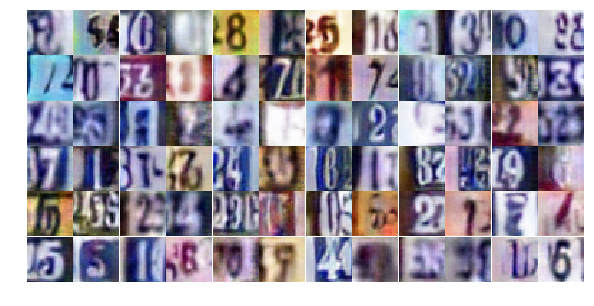

Epoch 25/25... Discriminator Loss: 1.0453... Generator Loss: 2.5371
Epoch 25/25... Discriminator Loss: 0.6714... Generator Loss: 0.9771
Epoch 25/25... Discriminator Loss: 0.6771... Generator Loss: 1.4164
Epoch 25/25... Discriminator Loss: 0.7055... Generator Loss: 0.9962
Epoch 25/25... Discriminator Loss: 1.0813... Generator Loss: 0.6856
Epoch 25/25... Discriminator Loss: 1.0773... Generator Loss: 0.6276
Epoch 25/25... Discriminator Loss: 0.7847... Generator Loss: 0.9748
Epoch 25/25... Discriminator Loss: 0.7229... Generator Loss: 1.0036
Epoch 25/25... Discriminator Loss: 1.9884... Generator Loss: 0.2602
Epoch 25/25... Discriminator Loss: 0.4921... Generator Loss: 1.5916


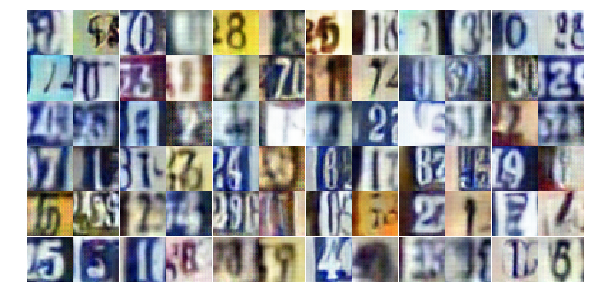

Epoch 25/25... Discriminator Loss: 0.7598... Generator Loss: 1.2409
Epoch 25/25... Discriminator Loss: 0.6934... Generator Loss: 0.9610
Epoch 25/25... Discriminator Loss: 0.8393... Generator Loss: 2.5370
Epoch 25/25... Discriminator Loss: 0.8581... Generator Loss: 0.8622
Epoch 25/25... Discriminator Loss: 0.6139... Generator Loss: 1.2929
Epoch 25/25... Discriminator Loss: 0.7003... Generator Loss: 0.9858
Epoch 25/25... Discriminator Loss: 1.9363... Generator Loss: 0.2719
Epoch 25/25... Discriminator Loss: 0.6218... Generator Loss: 1.0872
Epoch 25/25... Discriminator Loss: 0.8694... Generator Loss: 0.8920
Epoch 25/25... Discriminator Loss: 0.7898... Generator Loss: 0.8865


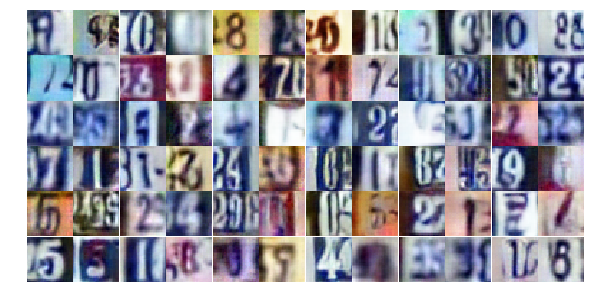

Epoch 25/25... Discriminator Loss: 0.5973... Generator Loss: 2.0826
Epoch 25/25... Discriminator Loss: 1.3222... Generator Loss: 0.5383


In [17]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

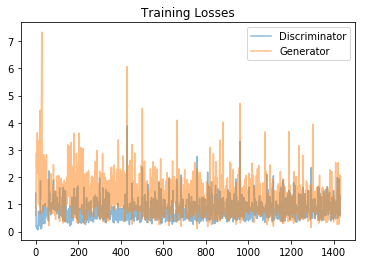

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

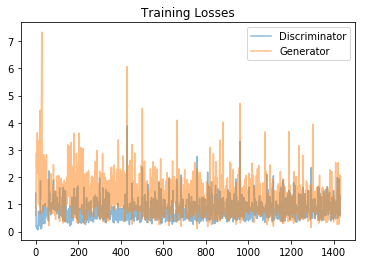

In [19]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

c:\programdata\anaconda3\envs\aind\lib\site-packages\matplotlib\axes\_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


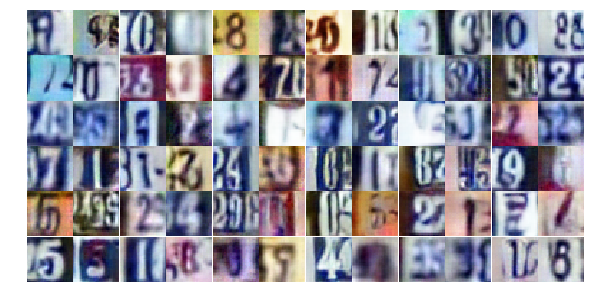

In [20]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

c:\programdata\anaconda3\envs\aind\lib\site-packages\matplotlib\axes\_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


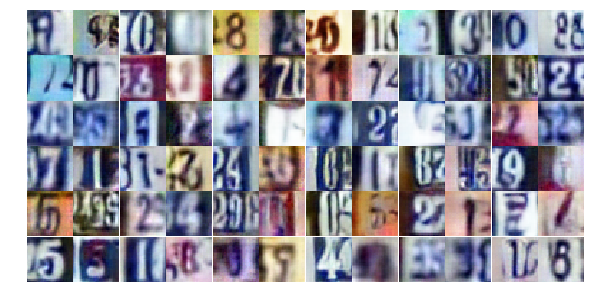

In [21]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))